# 3D Multi-class Segmentation with UNETR  (Muscle, Fat (subcut and internal), psoas,cavity, BGD)

## Setup environment

In [1]:
!pip install -q "monai-weekly[nibabel, tqdm, einops]"
!python -c "import matplotlib" || pip install -q matplotlib
%matplotlib inline

In [2]:
import os
import shutil
import tempfile

import matplotlib.pyplot as plt
import numpy as np
from tqdm import tqdm

from monai.losses import DiceCELoss
from monai.inferers import sliding_window_inference
from monai.transforms import (
    AsDiscrete,
    EnsureChannelFirstd,
    AddChanneld,
    Compose,
    CropForegroundd,
    LoadImaged,
    Orientationd,
    RandFlipd,
    RandCropByPosNegLabeld,
    RandShiftIntensityd,
    SaveImaged,
    ScaleIntensityRanged,
    Spacingd,
    RandRotate90d,
    ToTensord,
)

from monai.config import print_config
from monai.metrics import DiceMetric
from monai.networks.nets import UNETR

from monai.data import (
    DataLoader,
    CacheDataset,
    load_decathlon_datalist,
    decollate_batch,
)


import torch

print_config()

MONAI version: 0.10.dev2231
Numpy version: 1.23.1
Pytorch version: 1.12.0+cu102
MONAI flags: HAS_EXT = False, USE_COMPILED = False, USE_META_DICT = False
MONAI rev id: 8236821c099e5997f7ad0410c5374e4472f4ed14
MONAI __file__: /home/adminbthomas/miniconda3/envs/PT02/lib/python3.9/site-packages/monai/__init__.py

Optional dependencies:
Pytorch Ignite version: 0.4.9
Nibabel version: 4.0.1
scikit-image version: 0.19.3
Pillow version: 9.2.0
Tensorboard version: 2.9.1
gdown version: 4.5.1
TorchVision version: 0.13.0+cu102
tqdm version: 4.64.0
lmdb version: 1.3.0
psutil version: 5.9.1
pandas version: 1.4.3
einops version: 0.4.1
transformers version: 4.20.1
mlflow version: 1.27.0
pynrrd version: NOT INSTALLED or UNKNOWN VERSION.

For details about installing the optional dependencies, please visit:
    https://docs.monai.io/en/latest/installation.html#installing-the-recommended-dependencies



## Setup data directory

In [3]:
# directory = os.environ.get("MONAI_DATA_DIRECTORY")
root_dir = "/home/adminbthomas/Downloads/data"# root_dir = tempfile.mkdtemp() if directory is None else directory
print(root_dir)

/home/adminbthomas/Downloads/data


## Setup transforms for training and validation

In [4]:
import datetime
import time

train_transforms = Compose(
    [
        LoadImaged(keys=["image", "label"], ensure_channel_first=True),
#         AddChanneld(keys=["image", "label"]),
        Orientationd(keys=["image", "label"], axcodes="RAS"),
        Spacingd(
            keys=["image", "label"],
            pixdim=(1.5, 1.5, 2.0),
            mode=("bilinear", "nearest"),
        ),
        ScaleIntensityRanged(
            keys=["image"],
            a_min=0,
            a_max=250,
            b_min=0.0,
            b_max=1.0,
            clip=False,   # change-intermedouts 
        ),
        CropForegroundd(keys=["image", "label"], source_key="image"),
        RandCropByPosNegLabeld(
            keys=["image", "label"],
            label_key="label",
            spatial_size=(96, 96, 16),
            pos=1,
            neg=1,
            num_samples=4,
            image_key="image",
            image_threshold=0,
        ),
        RandFlipd(
            keys=["image", "label"],
            spatial_axis=[0],
            prob=0.10,
        ),
        RandFlipd(
            keys=["image", "label"],
            spatial_axis=[1],
            prob=0.10,
        ),
        RandFlipd(
            keys=["image", "label"],
            spatial_axis=[2],
            prob=0.10,
        ),
        RandRotate90d(
            keys=["image", "label"],
            prob=0.10,
            max_k=3,
        ),
        RandShiftIntensityd(
            keys=["image"],
            offsets=0.10,
            prob=0.50,
        ),
        ToTensord(keys=["image", "label"]),
#         SaveImaged(keys="image", meta_keys="image_meta_dict", output_dir="./outMR02_Jul23_Interinputs", output_postfix=datetime.datetime.now().strftime('%f'), resample=False, separate_folder=False),
#         SaveImaged(keys="label", meta_keys="label_meta_dict", output_dir="./outMR02_Jul23_Interinputs", output_postfix=datetime.datetime.now().strftime('%f'), resample=False, separate_folder=False),
    ]
)
val_transforms = Compose(
    [
        LoadImaged(keys=["image", "label"], ensure_channel_first=True),
#         AddChanneld(keys=["image", "label"]),
        Orientationd(keys=["image", "label"], axcodes="RAS"),
        Spacingd(
            keys=["image", "label"],
            pixdim=(1.5, 1.5, 2.0),
            mode=("bilinear", "nearest"),
        ),
        ScaleIntensityRanged(
            keys=["image"], a_min=0, a_max=250, b_min=0.0, b_max=1.0, clip=False
        ),
        CropForegroundd(keys=["image", "label"], source_key="image"),
        ToTensord(keys=["image", "label"]),
    ]
)

### DATA

In [5]:
data_dir = os.path.join(root_dir,"013123_MR/")

In [6]:
# data_dir = os.path.join(root_dir,"013123_MR/")
split_JSON = "dataset_MR04.json"
datasets = data_dir + split_JSON
datalist = load_decathlon_datalist(datasets, True, "training")
val_files = load_decathlon_datalist(datasets, True, "validation")
train_ds = CacheDataset(
    data=datalist,
    transform=train_transforms,
    cache_num=24,
    cache_rate=1.0,
    num_workers=8,
)
train_loader = DataLoader(
    train_ds, batch_size=1, shuffle=True, num_workers=8, pin_memory=True
)
val_ds = CacheDataset(
    data=val_files, transform=val_transforms, cache_num=6, cache_rate=1.0, num_workers=4
)
val_loader = DataLoader(
    val_ds, batch_size=1, shuffle=False, num_workers=4, pin_memory=True
)

Loading dataset:   0%|                                                                                                                                                     | 0/12 [00:00<?, ?it/s]Modifying image pixdim from [1.4648438 1.4648438 4.        0.       ] to [  1.46484375   1.46484375   4.         268.45717811]
Modifying image pixdim from [1.4648438 1.4648438 8.        0.       ] to [  1.46484375   1.46484375   8.         281.03604124]
Loading dataset: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 6/6 [00:01<00:00,  5.07it/s]


In [7]:
data_dir = os.path.join(root_dir,"013123_MR/")
print(data_dir)
# help(val_loader)
# len(val_loader)

/home/adminbthomas/Downloads/data/013123_MR/


## Check data shape and visualize

image shape: torch.Size([1, 250, 171, 49]), label shape: torch.Size([1, 250, 171, 49])


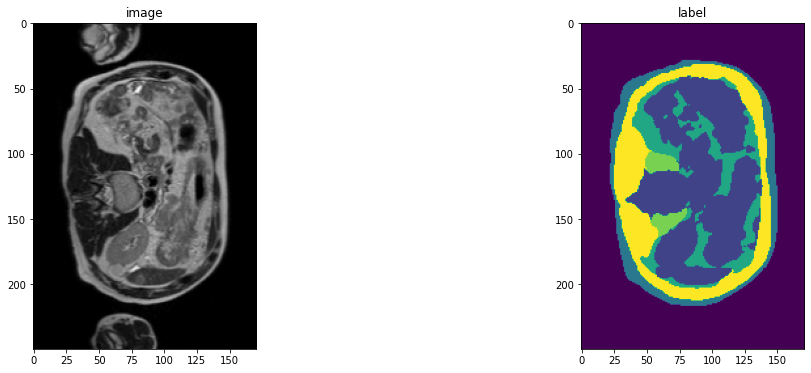

In [8]:
slice_map = {
    "A029_v4_T2W.nii.gz": 10,
    "A029_v4_T2W.nii.gz": 8,
    "A029_v4_T2W.nii.gz": 6
}
case_num = 3
img_name = os.path.split(val_ds[case_num]["image_meta_dict"]["filename_or_obj"])[1]
img = val_ds[case_num]["image"]
label = val_ds[case_num]["label"]
img_shape = img.shape
label_shape = label.shape
print(f"image shape: {img_shape}, label shape: {label_shape}")
plt.figure("image", (18, 6))
plt.subplot(1, 2, 1)
plt.title("image")
plt.imshow(img[0, :, :, slice_map[img_name]].detach().cpu(), cmap="gray")
plt.subplot(1, 2, 2)
plt.title("label")
plt.imshow(label[0, :, :, slice_map[img_name]].detach().cpu())
plt.show()

### Create Model, Loss, Optimizer


In [9]:
# os.environ["CUDA_DEVICE_ORDER"] = "PCI_BUS_ID"
device = torch.device("cuda:1")

model = UNETR(
    in_channels=1,
    out_channels=6,
    img_size=(96, 96, 16),
    feature_size=16,
    hidden_size=768,
    mlp_dim=3072,
    num_heads=12,
    pos_embed="perceptron",
    norm_name="instance",
    res_block=True,
    dropout_rate=0.0,
).to(device)

loss_function = DiceCELoss(to_onehot_y=True, softmax=True)
torch.backends.cudnn.benchmark = True
optimizer = torch.optim.AdamW(model.parameters(), lr=1e-4, weight_decay=1e-5)

### Execute a typical PyTorch training process

In [10]:
def validation(epoch_iterator_val):
    model.eval()
    dice_vals = list()
    with torch.no_grad():
        for step, batch in enumerate(epoch_iterator_val):
            val_inputs, val_labels = (batch["image"].to(device), batch["label"].to(device))
            val_outputs = sliding_window_inference(val_inputs, (96, 96, 16), 4, model)
            val_labels_list = decollate_batch(val_labels)
            val_labels_convert = [
                post_label(val_label_tensor) for val_label_tensor in val_labels_list
            ]
            val_outputs_list = decollate_batch(val_outputs)
            val_output_convert = [
                post_pred(val_pred_tensor) for val_pred_tensor in val_outputs_list
            ]
            dice_metric(y_pred=val_output_convert, y=val_labels_convert)
            dice = dice_metric.aggregate().item()
            dice_vals.append(dice)
            epoch_iterator_val.set_description(
                "Validate (%d / %d Steps) (dice=%2.5f)" % (global_step, 10.0, dice)
            )
        dice_metric.reset()
    mean_dice_val = np.mean(dice_vals)
    return mean_dice_val


def train(global_step, train_loader, dice_val_best, global_step_best):
    model.train()
    epoch_loss = 0
    step = 0
    epoch_iterator = tqdm(
        train_loader, desc="Training (X / X Steps) (loss=X.X)", dynamic_ncols=True
    )
    for step, batch in enumerate(epoch_iterator):
        step += 1
        x, y = (batch["image"].to(device), batch["label"].to(device))
#         print(x.shape)
#         print(y.shape)
#         plt.figure("image", (18, 6))
#         plt.subplot(1, 2, 1)
#         plt.title("image")
#         plt.imshow(x[3,0,:,:,4].detach().cpu(), cmap="gray")
#         plt.subplot(1, 2, 2)
#         plt.title("label")
#         plt.imshow(y[3,0,:,:,4].detach().cpu())
#         plt.show()
        logit_map = model(x)
        loss = loss_function(logit_map, y)
        loss.backward()
        epoch_loss += loss.item()
        optimizer.step()
        optimizer.zero_grad()
        epoch_iterator.set_description(
            "Training (%d / %d Steps) (loss=%2.5f)" % (global_step, max_iterations, loss)
        )
        if (
            global_step % eval_num == 0 and global_step != 0
        ) or global_step == max_iterations:
            epoch_iterator_val = tqdm(
                val_loader, desc="Validate (X / X Steps) (dice=X.X)", dynamic_ncols=True
            )
            dice_val = validation(epoch_iterator_val)
            epoch_loss /= step
            epoch_loss_values.append(epoch_loss)
            metric_values.append(dice_val)
            if dice_val > dice_val_best:
                dice_val_best = dice_val
                global_step_best = global_step
                torch.save(
                    model.state_dict(), os.path.join(data_dir, "TestMR06_multiclassUNetR_Sep23.pth")
                )
                print(
                    "Model Was Saved ! Current Best Avg. Dice: {} Current Avg. Dice: {}".format(
                        dice_val_best, dice_val
                    )
                )
            else:
                print(
                    "Model Was Not Saved ! Current Best Avg. Dice: {} Current Avg. Dice: {}".format(
                        dice_val_best, dice_val
                    )
                )
        global_step += 1
        
    return global_step, dice_val_best, global_step_best


max_iterations = 90000
eval_num = 250
post_label = AsDiscrete(to_onehot=6)
post_pred = AsDiscrete(argmax=True, to_onehot=6)
dice_metric = DiceMetric(include_background=True, reduction="mean", get_not_nans=False)
global_step = 0
dice_val_best = 0.0
global_step_best = 0
epoch_loss_values = []
metric_values = []
while global_step < max_iterations:
    global_step, dice_val_best, global_step_best = train(
        global_step, train_loader, dice_val_best, global_step_best
    )
#     print('I am waiting....')
#     time.sleep(1)
model.load_state_dict(torch.load(os.path.join(data_dir, "TestMR06_multiclassUNetR_Sep23.pth")))

Training (251 / 90000 Steps) (loss=1.67574): 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:07<00:00,  1.12s/it]

Model Was Saved ! Current Best Avg. Dice: 0.6153096982410976 Current Avg. Dice: 0.6153096982410976


Training (501 / 90000 Steps) (loss=1.43859):  83%|█████████████████████████████████████████████████████████████████████████████████████████████▎                  | 10/12 [00:06<00:02,  1.11s/it]

Model Was Saved ! Current Best Avg. Dice: 0.6462029899869647 Current Avg. Dice: 0.6462029899869647


Training (751 / 90000 Steps) (loss=1.17095):  67%|███████████████████████████████████████████████████████████████████████████▎                                     | 8/12 [00:06<00:04,  1.15s/it]

Model Was Saved ! Current Best Avg. Dice: 0.6620497192655291 Current Avg. Dice: 0.6620497192655291


Training (1001 / 90000 Steps) (loss=0.93451):  50%|████████████████████████████████████████████████████████                                                        | 6/12 [00:06<00:07,  1.24s/it]

Model Was Saved ! Current Best Avg. Dice: 0.6633520211492266 Current Avg. Dice: 0.6633520211492266


Training (1251 / 90000 Steps) (loss=1.09159):  33%|█████████████████████████████████████▎                                                                          | 4/12 [00:05<00:11,  1.44s/it]

Model Was Saved ! Current Best Avg. Dice: 0.6687877178192139 Current Avg. Dice: 0.6687877178192139


Training (1501 / 90000 Steps) (loss=0.92317):  17%|██████████████████▋                                                                                             | 2/12 [00:05<00:22,  2.30s/it]

Model Was Saved ! Current Best Avg. Dice: 0.7038108536175319 Current Avg. Dice: 0.7038108536175319


Training (1751 / 90000 Steps) (loss=1.71996): 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:07<00:00,  1.11s/it]

Model Was Saved ! Current Best Avg. Dice: 0.7080674852643695 Current Avg. Dice: 0.7080674852643695


Training (2001 / 90000 Steps) (loss=0.85177):  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                  | 10/12 [00:06<00:02,  1.14s/it]

Model Was Saved ! Current Best Avg. Dice: 0.7173983539853778 Current Avg. Dice: 0.7173983539853778


Training (2251 / 90000 Steps) (loss=0.99107):  67%|██████████████████████████████████████████████████████████████████████████▋                                     | 8/12 [00:05<00:04,  1.04s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.7173983539853778 Current Avg. Dice: 0.7136457136699131


Training (2501 / 90000 Steps) (loss=1.03905):  50%|████████████████████████████████████████████████████████                                                        | 6/12 [00:06<00:07,  1.24s/it]

Model Was Saved ! Current Best Avg. Dice: 0.7200313125337873 Current Avg. Dice: 0.7200313125337873


Training (2751 / 90000 Steps) (loss=1.17981):  33%|█████████████████████████████████████▎                                                                          | 4/12 [00:05<00:11,  1.47s/it]

Model Was Saved ! Current Best Avg. Dice: 0.7290969576154437 Current Avg. Dice: 0.7290969576154437


Training (3001 / 90000 Steps) (loss=0.67037):  17%|██████████████████▋                                                                                             | 2/12 [00:05<00:22,  2.28s/it]

Model Was Saved ! Current Best Avg. Dice: 0.7342663066727775 Current Avg. Dice: 0.7342663066727775


Training (3251 / 90000 Steps) (loss=1.49120): 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.10s/it]

Model Was Saved ! Current Best Avg. Dice: 0.7379689727510724 Current Avg. Dice: 0.7379689727510724


Training (3501 / 90000 Steps) (loss=0.71700):  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                  | 10/12 [00:06<00:02,  1.12s/it]

Model Was Saved ! Current Best Avg. Dice: 0.7392381770270211 Current Avg. Dice: 0.7392381770270211


Training (3751 / 90000 Steps) (loss=0.99191):  67%|██████████████████████████████████████████████████████████████████████████▋                                     | 8/12 [00:06<00:04,  1.17s/it]

Model Was Saved ! Current Best Avg. Dice: 0.7421699336596898 Current Avg. Dice: 0.7421699336596898


Training (4001 / 90000 Steps) (loss=1.03165):  50%|████████████████████████████████████████████████████████                                                        | 6/12 [00:05<00:06,  1.13s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.7421699336596898 Current Avg. Dice: 0.7400200366973877


Training (4251 / 90000 Steps) (loss=0.99318):  33%|█████████████████████████████████████▎                                                                          | 4/12 [00:05<00:11,  1.46s/it]

Model Was Saved ! Current Best Avg. Dice: 0.7465210386684963 Current Avg. Dice: 0.7465210386684963


Training (4501 / 90000 Steps) (loss=0.66111):  17%|██████████████████▋                                                                                             | 2/12 [00:05<00:21,  2.12s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.7465210386684963 Current Avg. Dice: 0.7402060627937317


Training (4751 / 90000 Steps) (loss=0.67894): 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.10s/it]

Model Was Saved ! Current Best Avg. Dice: 0.7469901272228786 Current Avg. Dice: 0.7469901272228786


Training (5001 / 90000 Steps) (loss=0.73324):  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                  | 10/12 [00:06<00:02,  1.17s/it]

Model Was Saved ! Current Best Avg. Dice: 0.7524919084140232 Current Avg. Dice: 0.7524919084140232


Training (5251 / 90000 Steps) (loss=1.06500):  67%|██████████████████████████████████████████████████████████████████████████▋                                     | 8/12 [00:05<00:04,  1.06s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.7524919084140232 Current Avg. Dice: 0.7518188953399658


Training (5501 / 90000 Steps) (loss=0.61986):  50%|████████████████████████████████████████████████████████                                                        | 6/12 [00:06<00:07,  1.26s/it]

Model Was Saved ! Current Best Avg. Dice: 0.7721388169697353 Current Avg. Dice: 0.7721388169697353


Training (5751 / 90000 Steps) (loss=0.80907):  33%|█████████████████████████████████████▎                                                                          | 4/12 [00:05<00:11,  1.45s/it]

Model Was Saved ! Current Best Avg. Dice: 0.7977204493113926 Current Avg. Dice: 0.7977204493113926


Training (6001 / 90000 Steps) (loss=0.61563):  17%|██████████████████▋                                                                                             | 2/12 [00:05<00:22,  2.26s/it]

Model Was Saved ! Current Best Avg. Dice: 0.8515408890587943 Current Avg. Dice: 0.8515408890587943


Training (6251 / 90000 Steps) (loss=0.56992): 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.08s/it]

Model Was Saved ! Current Best Avg. Dice: 0.8551792076655796 Current Avg. Dice: 0.8551792076655796


Training (6501 / 90000 Steps) (loss=0.93300):  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                  | 10/12 [00:06<00:02,  1.11s/it]

Model Was Saved ! Current Best Avg. Dice: 0.863127623285566 Current Avg. Dice: 0.863127623285566


Training (6751 / 90000 Steps) (loss=0.54095):  67%|██████████████████████████████████████████████████████████████████████████▋                                     | 8/12 [00:05<00:04,  1.05s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.863127623285566 Current Avg. Dice: 0.8503333245004926


Training (7001 / 90000 Steps) (loss=0.68062):  50%|████████████████████████████████████████████████████████                                                        | 6/12 [00:06<00:07,  1.26s/it]

Model Was Saved ! Current Best Avg. Dice: 0.8657635961260114 Current Avg. Dice: 0.8657635961260114


Training (7251 / 90000 Steps) (loss=0.90311):  33%|█████████████████████████████████████▎                                                                          | 4/12 [00:05<00:10,  1.33s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.8657635961260114 Current Avg. Dice: 0.8618192246982029


Training (7501 / 90000 Steps) (loss=0.80448):  17%|██████████████████▋                                                                                             | 2/12 [00:05<00:22,  2.28s/it]

Model Was Saved ! Current Best Avg. Dice: 0.8686239549091884 Current Avg. Dice: 0.8686239549091884


Training (7751 / 90000 Steps) (loss=0.57646): 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.10s/it]

Model Was Saved ! Current Best Avg. Dice: 0.8745874762535095 Current Avg. Dice: 0.8745874762535095


Training (8001 / 90000 Steps) (loss=0.78385):  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                  | 10/12 [00:05<00:01,  1.01it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.8745874762535095 Current Avg. Dice: 0.8666683605739048


Training (8251 / 90000 Steps) (loss=0.50294):  67%|██████████████████████████████████████████████████████████████████████████▋                                     | 8/12 [00:05<00:04,  1.04s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.8745874762535095 Current Avg. Dice: 0.871307977608272


Training (8501 / 90000 Steps) (loss=0.63014):  50%|████████████████████████████████████████████████████████                                                        | 6/12 [00:06<00:07,  1.25s/it]

Model Was Saved ! Current Best Avg. Dice: 0.8793551751545498 Current Avg. Dice: 0.8793551751545498


Training (8751 / 90000 Steps) (loss=0.50640):  33%|█████████████████████████████████████▎                                                                          | 4/12 [00:05<00:10,  1.35s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.8793551751545498 Current Avg. Dice: 0.8753639544759478


Training (9001 / 90000 Steps) (loss=0.49692):  17%|██████████████████▋                                                                                             | 2/12 [00:05<00:21,  2.11s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.8793551751545498 Current Avg. Dice: 0.8722179276602608


Training (9251 / 90000 Steps) (loss=0.60588): 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.01it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.8793551751545498 Current Avg. Dice: 0.876810337815966


Training (9501 / 90000 Steps) (loss=0.56549):  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                  | 10/12 [00:06<00:02,  1.02s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.8793551751545498 Current Avg. Dice: 0.8771790521485465


Training (9751 / 90000 Steps) (loss=0.52506):  67%|██████████████████████████████████████████████████████████████████████████▋                                     | 8/12 [00:05<00:04,  1.04s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.8793551751545498 Current Avg. Dice: 0.8788613506725856


Training (10001 / 90000 Steps) (loss=0.85789):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:06,  1.12s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.8793551751545498 Current Avg. Dice: 0.8742368136133466


Training (10251 / 90000 Steps) (loss=0.54259):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:11,  1.48s/it]

Model Was Saved ! Current Best Avg. Dice: 0.8817560928208488 Current Avg. Dice: 0.8817560928208488


Training (10501 / 90000 Steps) (loss=0.40362):  17%|██████████████████▌                                                                                            | 2/12 [00:05<00:21,  2.13s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.8817560928208488 Current Avg. Dice: 0.8736482518059867


Training (10751 / 90000 Steps) (loss=0.42283): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.01it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.8817560928208488 Current Avg. Dice: 0.8788006135395595


Training (11001 / 90000 Steps) (loss=0.41043):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:02,  1.13s/it]

Model Was Saved ! Current Best Avg. Dice: 0.8828355925423759 Current Avg. Dice: 0.8828355925423759


Training (11251 / 90000 Steps) (loss=0.42216):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:05<00:04,  1.06s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.8828355925423759 Current Avg. Dice: 0.878257759979793


Training (11501 / 90000 Steps) (loss=1.03171):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:06<00:07,  1.26s/it]

Model Was Saved ! Current Best Avg. Dice: 0.887216934135982 Current Avg. Dice: 0.887216934135982


Training (11751 / 90000 Steps) (loss=0.49340):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:10,  1.31s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.887216934135982 Current Avg. Dice: 0.8823104841368539


Training (12001 / 90000 Steps) (loss=0.38176):  17%|██████████████████▌                                                                                            | 2/12 [00:05<00:23,  2.35s/it]

Model Was Saved ! Current Best Avg. Dice: 0.8911409292902265 Current Avg. Dice: 0.8911409292902265


Training (12251 / 90000 Steps) (loss=0.38890): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.02it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.8911409292902265 Current Avg. Dice: 0.8755666358130318


Training (12501 / 90000 Steps) (loss=0.60251):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:02,  1.03s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.8911409292902265 Current Avg. Dice: 0.875139628137861


Training (12751 / 90000 Steps) (loss=0.47688):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:06<00:04,  1.07s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.8911409292902265 Current Avg. Dice: 0.8834105900355748


Training (13001 / 90000 Steps) (loss=0.43427):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:06,  1.11s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.8911409292902265 Current Avg. Dice: 0.8819957545825413


Training (13251 / 90000 Steps) (loss=0.56976):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:10,  1.35s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.8911409292902265 Current Avg. Dice: 0.8892345087868827


Training (13501 / 90000 Steps) (loss=0.75373):  17%|██████████████████▌                                                                                            | 2/12 [00:04<00:20,  2.08s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.8911409292902265 Current Avg. Dice: 0.8717148389135089


Training (13751 / 90000 Steps) (loss=0.42140): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.10s/it]

Model Was Saved ! Current Best Avg. Dice: 0.8944938012531826 Current Avg. Dice: 0.8944938012531826


Training (14001 / 90000 Steps) (loss=0.63252):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:02,  1.14s/it]

Model Was Saved ! Current Best Avg. Dice: 0.8947640061378479 Current Avg. Dice: 0.8947640061378479


Training (14251 / 90000 Steps) (loss=0.41331):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:05<00:04,  1.06s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.8947640061378479 Current Avg. Dice: 0.8892969489097595


Training (14501 / 90000 Steps) (loss=0.68806):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:06,  1.11s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.8947640061378479 Current Avg. Dice: 0.8888979128428868


Training (14751 / 90000 Steps) (loss=0.45270):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:10,  1.32s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.8947640061378479 Current Avg. Dice: 0.883686934198652


Training (15001 / 90000 Steps) (loss=0.56825):  17%|██████████████████▌                                                                                            | 2/12 [00:05<00:20,  2.10s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.8947640061378479 Current Avg. Dice: 0.8925434265817914


Training (15251 / 90000 Steps) (loss=0.74967): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.00s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.8947640061378479 Current Avg. Dice: 0.8926702397210258


Training (15501 / 90000 Steps) (loss=0.66744):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:02,  1.02s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.8947640061378479 Current Avg. Dice: 0.888213472706931


Training (15751 / 90000 Steps) (loss=0.56715):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:06<00:04,  1.15s/it]

Model Was Saved ! Current Best Avg. Dice: 0.896328500338963 Current Avg. Dice: 0.896328500338963


Training (16001 / 90000 Steps) (loss=0.60482):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:06,  1.12s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.896328500338963 Current Avg. Dice: 0.8908962181636265


Training (16251 / 90000 Steps) (loss=0.62647):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:10,  1.36s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.896328500338963 Current Avg. Dice: 0.8875739574432373


Training (16501 / 90000 Steps) (loss=0.41713):  17%|██████████████████▌                                                                                            | 2/12 [00:04<00:20,  2.08s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.896328500338963 Current Avg. Dice: 0.8818019373076302


Training (16751 / 90000 Steps) (loss=0.40704): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.01it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.896328500338963 Current Avg. Dice: 0.8911221708570208


Training (17001 / 90000 Steps) (loss=0.45531):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:02,  1.01s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.896328500338963 Current Avg. Dice: 0.8884634120123727


Training (17251 / 90000 Steps) (loss=0.45028):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:05<00:04,  1.06s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.896328500338963 Current Avg. Dice: 0.8889882138797215


Training (17501 / 90000 Steps) (loss=0.47848):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:06,  1.15s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.896328500338963 Current Avg. Dice: 0.8902142729078021


Training (17751 / 90000 Steps) (loss=0.41875):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:10,  1.32s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.896328500338963 Current Avg. Dice: 0.8887356349400112


Training (18001 / 90000 Steps) (loss=0.59287):  17%|██████████████████▌                                                                                            | 2/12 [00:04<00:20,  2.04s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.896328500338963 Current Avg. Dice: 0.8906114952904838


Training (18251 / 90000 Steps) (loss=0.33486): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.02it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.896328500338963 Current Avg. Dice: 0.887705888066973


Training (18501 / 90000 Steps) (loss=0.62241):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:02,  1.01s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.896328500338963 Current Avg. Dice: 0.895962689604078


Training (18751 / 90000 Steps) (loss=0.38786):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:06<00:04,  1.18s/it]

Model Was Saved ! Current Best Avg. Dice: 0.898574003151485 Current Avg. Dice: 0.898574003151485


Training (19001 / 90000 Steps) (loss=0.39778):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:06<00:07,  1.25s/it]

Model Was Saved ! Current Best Avg. Dice: 0.9005963802337646 Current Avg. Dice: 0.9005963802337646


Training (19251 / 90000 Steps) (loss=0.37940):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:10,  1.33s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9005963802337646 Current Avg. Dice: 0.8960790719304766


Training (19501 / 90000 Steps) (loss=0.54429):  17%|██████████████████▌                                                                                            | 2/12 [00:05<00:20,  2.09s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9005963802337646 Current Avg. Dice: 0.8946800657681057


Training (19751 / 90000 Steps) (loss=0.43731): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.01it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9005963802337646 Current Avg. Dice: 0.8929504156112671


Training (20001 / 90000 Steps) (loss=0.42307):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:02,  1.03s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9005963802337646 Current Avg. Dice: 0.8971153923443386


Training (20251 / 90000 Steps) (loss=0.42724):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:05<00:04,  1.05s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9005963802337646 Current Avg. Dice: 0.8961222001484462


Training (20501 / 90000 Steps) (loss=0.54934):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:06,  1.13s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9005963802337646 Current Avg. Dice: 0.8916711551802499


Training (20751 / 90000 Steps) (loss=0.62251):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:10,  1.35s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9005963802337646 Current Avg. Dice: 0.8917279328618731


Training (21001 / 90000 Steps) (loss=0.44061):  17%|██████████████████▌                                                                                            | 2/12 [00:04<00:20,  2.04s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9005963802337646 Current Avg. Dice: 0.892138489655086


Training (21251 / 90000 Steps) (loss=0.43095): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.02it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9005963802337646 Current Avg. Dice: 0.890696108341217


Training (21501 / 90000 Steps) (loss=0.58262):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:02,  1.02s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9005963802337646 Current Avg. Dice: 0.8912437558174133


Training (21751 / 90000 Steps) (loss=0.58089):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:05<00:04,  1.04s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9005963802337646 Current Avg. Dice: 0.898388249533517


Training (22001 / 90000 Steps) (loss=0.42136):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:06,  1.12s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9005963802337646 Current Avg. Dice: 0.896836519241333


Training (22251 / 90000 Steps) (loss=0.47836):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:10,  1.32s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9005963802337646 Current Avg. Dice: 0.899019718170166


Training (22501 / 90000 Steps) (loss=0.41510):  17%|██████████████████▌                                                                                            | 2/12 [00:05<00:21,  2.10s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9005963802337646 Current Avg. Dice: 0.8877016731670925


Training (22751 / 90000 Steps) (loss=0.39384): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.10s/it]

Model Was Saved ! Current Best Avg. Dice: 0.9016014592988151 Current Avg. Dice: 0.9016014592988151


Training (23001 / 90000 Steps) (loss=0.42472):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:02,  1.01s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9016014592988151 Current Avg. Dice: 0.8995477557182312


Training (23251 / 90000 Steps) (loss=0.38854):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:05<00:04,  1.06s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9016014592988151 Current Avg. Dice: 0.8943491663251605


Training (23501 / 90000 Steps) (loss=0.45812):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:06,  1.13s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9016014592988151 Current Avg. Dice: 0.8994958911623273


Training (23751 / 90000 Steps) (loss=0.72934):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:10,  1.33s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9016014592988151 Current Avg. Dice: 0.8925053562436785


Training (24001 / 90000 Steps) (loss=0.27166):  17%|██████████████████▌                                                                                            | 2/12 [00:04<00:20,  2.06s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9016014592988151 Current Avg. Dice: 0.9015039716448102


Training (24251 / 90000 Steps) (loss=0.38274): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.01it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9016014592988151 Current Avg. Dice: 0.8951409373964582


Training (24501 / 90000 Steps) (loss=0.47132):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:02,  1.11s/it]

Model Was Saved ! Current Best Avg. Dice: 0.9030755162239075 Current Avg. Dice: 0.9030755162239075


Training (24751 / 90000 Steps) (loss=0.58828):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:05<00:04,  1.04s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9030755162239075 Current Avg. Dice: 0.8927703755242484


Training (25001 / 90000 Steps) (loss=0.41142):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:06,  1.13s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9030755162239075 Current Avg. Dice: 0.8980796592576163


Training (25251 / 90000 Steps) (loss=0.41719):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:10,  1.32s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9030755162239075 Current Avg. Dice: 0.9023814967700413


Training (25501 / 90000 Steps) (loss=0.55114):  17%|██████████████████▌                                                                                            | 2/12 [00:04<00:20,  2.06s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9030755162239075 Current Avg. Dice: 0.9003613591194153


Training (25751 / 90000 Steps) (loss=0.55938): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.03it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9030755162239075 Current Avg. Dice: 0.8998863015856061


Training (26001 / 90000 Steps) (loss=0.46962):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:02,  1.01s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9030755162239075 Current Avg. Dice: 0.8992433037076678


Training (26251 / 90000 Steps) (loss=0.49625):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:05<00:04,  1.04s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9030755162239075 Current Avg. Dice: 0.9017971243177142


Training (26501 / 90000 Steps) (loss=0.37740):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:06,  1.12s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9030755162239075 Current Avg. Dice: 0.9011382290295192


Training (26751 / 90000 Steps) (loss=0.68989):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:11,  1.46s/it]

Model Was Saved ! Current Best Avg. Dice: 0.9049850106239319 Current Avg. Dice: 0.9049850106239319


Training (27001 / 90000 Steps) (loss=0.40727):  17%|██████████████████▌                                                                                            | 2/12 [00:05<00:20,  2.09s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9049850106239319 Current Avg. Dice: 0.903512852532523


Training (27251 / 90000 Steps) (loss=0.32702): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.01it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9049850106239319 Current Avg. Dice: 0.9025191409247262


Training (27501 / 90000 Steps) (loss=0.53617):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:02,  1.01s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9049850106239319 Current Avg. Dice: 0.9030790328979492


Training (27751 / 90000 Steps) (loss=0.35481):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:05<00:04,  1.05s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9049850106239319 Current Avg. Dice: 0.9012314251491002


Training (28001 / 90000 Steps) (loss=0.46027):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:06,  1.12s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9049850106239319 Current Avg. Dice: 0.898108184337616


Training (28251 / 90000 Steps) (loss=0.40265):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:10,  1.33s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9049850106239319 Current Avg. Dice: 0.8917646322931562


Training (28501 / 90000 Steps) (loss=0.35146):  17%|██████████████████▌                                                                                            | 2/12 [00:04<00:20,  2.08s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9049850106239319 Current Avg. Dice: 0.8976736664772034


Training (28751 / 90000 Steps) (loss=0.47218): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.06s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9049850106239319 Current Avg. Dice: 0.9031911832945687


Training (29001 / 90000 Steps) (loss=0.32499):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:01,  1.00it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9049850106239319 Current Avg. Dice: 0.8899279662540981


Training (29251 / 90000 Steps) (loss=0.43651):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:05<00:04,  1.03s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9049850106239319 Current Avg. Dice: 0.9010200415338788


Training (29501 / 90000 Steps) (loss=0.52448):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:06,  1.12s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9049850106239319 Current Avg. Dice: 0.9015993050166539


Training (29751 / 90000 Steps) (loss=0.41298):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:10,  1.33s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9049850106239319 Current Avg. Dice: 0.9040446707180568


Training (30001 / 90000 Steps) (loss=0.41267):  17%|██████████████████▌                                                                                            | 2/12 [00:04<00:20,  2.07s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9049850106239319 Current Avg. Dice: 0.9017375452177865


Training (30251 / 90000 Steps) (loss=0.45256): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.02it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9049850106239319 Current Avg. Dice: 0.902092593056815


Training (30501 / 90000 Steps) (loss=0.35277):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:01,  1.00it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9049850106239319 Current Avg. Dice: 0.9049758570534843


Training (30751 / 90000 Steps) (loss=0.29096):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:05<00:04,  1.03s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9049850106239319 Current Avg. Dice: 0.8985377550125122


Training (31001 / 90000 Steps) (loss=0.54879):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:06<00:07,  1.26s/it]

Model Was Saved ! Current Best Avg. Dice: 0.9058266963277545 Current Avg. Dice: 0.9058266963277545


Training (31251 / 90000 Steps) (loss=0.43168):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:10,  1.34s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9058266963277545 Current Avg. Dice: 0.9005512084279742


Training (31501 / 90000 Steps) (loss=0.42190):  17%|██████████████████▌                                                                                            | 2/12 [00:05<00:21,  2.13s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9058266963277545 Current Avg. Dice: 0.9043369718960353


Training (31751 / 90000 Steps) (loss=0.44774): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.01it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9058266963277545 Current Avg. Dice: 0.9022798878805978


Training (32001 / 90000 Steps) (loss=0.30295):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:02,  1.01s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9058266963277545 Current Avg. Dice: 0.9039497801235744


Training (32251 / 90000 Steps) (loss=0.67699):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:05<00:04,  1.03s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9058266963277545 Current Avg. Dice: 0.8988148399761745


Training (32501 / 90000 Steps) (loss=0.45353):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:06,  1.10s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9058266963277545 Current Avg. Dice: 0.8999625614711216


Training (32751 / 90000 Steps) (loss=0.40866):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:10,  1.30s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9058266963277545 Current Avg. Dice: 0.9046286174229213


Training (33001 / 90000 Steps) (loss=0.53662):  17%|██████████████████▌                                                                                            | 2/12 [00:05<00:21,  2.12s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9058266963277545 Current Avg. Dice: 0.9050084778240749


Training (33251 / 90000 Steps) (loss=0.31952): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.00s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9058266963277545 Current Avg. Dice: 0.8982288837432861


Training (33501 / 90000 Steps) (loss=0.40787):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:02,  1.01s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9058266963277545 Current Avg. Dice: 0.8978626046861921


Training (33751 / 90000 Steps) (loss=0.33565):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:05<00:04,  1.04s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9058266963277545 Current Avg. Dice: 0.9012159875461033


Training (34001 / 90000 Steps) (loss=0.51198):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:06,  1.12s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9058266963277545 Current Avg. Dice: 0.8947882652282715


Training (34251 / 90000 Steps) (loss=0.38084):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:11,  1.47s/it]

Model Was Saved ! Current Best Avg. Dice: 0.9077058179037911 Current Avg. Dice: 0.9077058179037911


Training (34501 / 90000 Steps) (loss=0.39242):  17%|██████████████████▌                                                                                            | 2/12 [00:05<00:20,  2.09s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9077058179037911 Current Avg. Dice: 0.9020364625113351


Training (34751 / 90000 Steps) (loss=0.35397): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.01it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9077058179037911 Current Avg. Dice: 0.9028794339724949


Training (35001 / 90000 Steps) (loss=0.52327):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:02,  1.01s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9077058179037911 Current Avg. Dice: 0.905546886580331


Training (35251 / 90000 Steps) (loss=0.31592):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:06<00:04,  1.05s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9077058179037911 Current Avg. Dice: 0.8902857729366848


Training (35501 / 90000 Steps) (loss=0.25752):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:06,  1.14s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9077058179037911 Current Avg. Dice: 0.9043648498398917


Training (35751 / 90000 Steps) (loss=0.42740):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:10,  1.30s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9077058179037911 Current Avg. Dice: 0.9072178261620658


Training (36001 / 90000 Steps) (loss=0.42849):  17%|██████████████████▌                                                                                            | 2/12 [00:05<00:21,  2.11s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9077058179037911 Current Avg. Dice: 0.9059741752488273


Training (36251 / 90000 Steps) (loss=0.35326): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.02it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9077058179037911 Current Avg. Dice: 0.9054257358823504


Training (36501 / 90000 Steps) (loss=0.48006):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:02,  1.12s/it]

Model Was Saved ! Current Best Avg. Dice: 0.9097703269549778 Current Avg. Dice: 0.9097703269549778


Training (36751 / 90000 Steps) (loss=0.43973):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:05<00:04,  1.04s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9097703269549778 Current Avg. Dice: 0.9073701160294669


Training (37001 / 90000 Steps) (loss=0.26252):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:06,  1.11s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9097703269549778 Current Avg. Dice: 0.9032621128218514


Training (37251 / 90000 Steps) (loss=0.38745):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:10,  1.34s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9097703269549778 Current Avg. Dice: 0.9042117851121085


Training (37501 / 90000 Steps) (loss=0.56264):  17%|██████████████████▌                                                                                            | 2/12 [00:04<00:20,  2.05s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9097703269549778 Current Avg. Dice: 0.9007860336984906


Training (37751 / 90000 Steps) (loss=0.43809): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.01it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9097703269549778 Current Avg. Dice: 0.9062275290489197


Training (38001 / 90000 Steps) (loss=0.49580):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:01,  1.00it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9097703269549778 Current Avg. Dice: 0.8958598375320435


Training (38251 / 90000 Steps) (loss=0.37605):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:05<00:04,  1.03s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9097703269549778 Current Avg. Dice: 0.9024468575205121


Training (38501 / 90000 Steps) (loss=0.71968):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:06,  1.12s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9097703269549778 Current Avg. Dice: 0.9089412348611015


Training (38751 / 90000 Steps) (loss=0.32151):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:10,  1.30s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9097703269549778 Current Avg. Dice: 0.9060613683291844


Training (39001 / 90000 Steps) (loss=0.34120):  17%|██████████████████▌                                                                                            | 2/12 [00:05<00:21,  2.10s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9097703269549778 Current Avg. Dice: 0.9041191594941276


Training (39251 / 90000 Steps) (loss=0.43725): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:07<00:00,  1.09s/it]

Model Was Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.911254244191306


Training (39501 / 90000 Steps) (loss=0.40997):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:01,  1.00it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.9083612816674369


Training (39751 / 90000 Steps) (loss=0.44290):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:05<00:04,  1.06s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.9016306400299072


Training (40001 / 90000 Steps) (loss=0.56026):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:06,  1.12s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.9077973876680646


Training (40251 / 90000 Steps) (loss=0.45782):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:10,  1.33s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.9104698385511126


Training (40501 / 90000 Steps) (loss=0.36179):  17%|██████████████████▌                                                                                            | 2/12 [00:05<00:21,  2.12s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.9048125318118504


Training (40751 / 90000 Steps) (loss=0.52560): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.01it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.9073696477072579


Training (41001 / 90000 Steps) (loss=0.41921):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:02,  1.00s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.9051301053592137


Training (41251 / 90000 Steps) (loss=0.42710):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:05<00:04,  1.04s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.9087635023253304


Training (41501 / 90000 Steps) (loss=0.53242):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:06,  1.13s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.9091524481773376


Training (41751 / 90000 Steps) (loss=0.44917):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:10,  1.36s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.9040421502930778


Training (42001 / 90000 Steps) (loss=0.36042):  17%|██████████████████▌                                                                                            | 2/12 [00:04<00:20,  2.00s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.9066080451011658


Training (42251 / 90000 Steps) (loss=0.46823): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.02it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.9040743027414594


Training (42501 / 90000 Steps) (loss=0.42438):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:02,  1.00s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.9071801475116185


Training (42751 / 90000 Steps) (loss=0.41006):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:05<00:04,  1.03s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.909070542880467


Training (43001 / 90000 Steps) (loss=0.34557):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:06,  1.11s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.9056184547288078


Training (43251 / 90000 Steps) (loss=0.53964):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:10,  1.32s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.9066482697214399


Training (43501 / 90000 Steps) (loss=0.32021):  17%|██████████████████▌                                                                                            | 2/12 [00:04<00:20,  2.08s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.9040371945926121


Training (43751 / 90000 Steps) (loss=0.37405): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.01it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.9079228809901646


Training (44001 / 90000 Steps) (loss=0.43442):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:02,  1.01s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.9055669563157218


Training (44251 / 90000 Steps) (loss=0.46032):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:05<00:04,  1.02s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.9038476347923279


Training (44501 / 90000 Steps) (loss=0.43436):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:06,  1.12s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.9110450659479413


Training (44751 / 90000 Steps) (loss=0.28909):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:10,  1.32s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.9067112718309674


Training (45001 / 90000 Steps) (loss=0.35337):  17%|██████████████████▌                                                                                            | 2/12 [00:04<00:20,  2.02s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.909999064036778


Training (45251 / 90000 Steps) (loss=0.39805): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.00it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.9078164270945958


Training (45501 / 90000 Steps) (loss=0.48284):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:01,  1.01it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.8951358284269061


Training (45751 / 90000 Steps) (loss=0.45154):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:05<00:04,  1.03s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.9101668340819222


Training (46001 / 90000 Steps) (loss=0.59308):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:06,  1.14s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.9050142254148211


Training (46251 / 90000 Steps) (loss=0.51155):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:10,  1.34s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.9097150819642204


Training (46501 / 90000 Steps) (loss=0.35062):  17%|██████████████████▌                                                                                            | 2/12 [00:04<00:20,  2.06s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.9067344069480896


Training (46751 / 90000 Steps) (loss=0.39883): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.03it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.9061715262276786


Training (47001 / 90000 Steps) (loss=0.29832):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:02,  1.01s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.9090532064437866


Training (47251 / 90000 Steps) (loss=0.49300):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:05<00:04,  1.04s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.9047002792358398


Training (47501 / 90000 Steps) (loss=0.41473):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:06,  1.11s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.9062341707093375


Training (47751 / 90000 Steps) (loss=0.39381):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:10,  1.33s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.8987791878836495


Training (48001 / 90000 Steps) (loss=0.40530):  17%|██████████████████▌                                                                                            | 2/12 [00:04<00:20,  2.03s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.9086906739643642


Training (48251 / 90000 Steps) (loss=0.45327): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.01it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.9087192331041608


Training (48501 / 90000 Steps) (loss=0.34869):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:02,  1.01s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.906701215675899


Training (48751 / 90000 Steps) (loss=0.56564):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:05<00:04,  1.05s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.9075565593583244


Training (49001 / 90000 Steps) (loss=0.41913):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:07,  1.20s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.903329108442579


Training (49251 / 90000 Steps) (loss=0.54464):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:10,  1.32s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.9072644965989249


Training (49501 / 90000 Steps) (loss=0.32738):  17%|██████████████████▌                                                                                            | 2/12 [00:05<00:21,  2.11s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.9086276633398873


Training (49751 / 90000 Steps) (loss=0.32417): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.01it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.9069041098867144


Training (50001 / 90000 Steps) (loss=0.42142):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:05<00:01,  1.00it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.8969955699784415


Training (50251 / 90000 Steps) (loss=0.35982):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:05<00:04,  1.04s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.9054092339106968


Training (50501 / 90000 Steps) (loss=0.33424):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:06,  1.12s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.9047313758305141


Training (50751 / 90000 Steps) (loss=0.40619):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:10,  1.34s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.9076969197818211


Training (51001 / 90000 Steps) (loss=0.39159):  17%|██████████████████▌                                                                                            | 2/12 [00:05<00:20,  2.09s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.9028164403779166


Training (51251 / 90000 Steps) (loss=0.45330): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.00s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.9030511890138898


Training (51501 / 90000 Steps) (loss=0.21045):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:02,  1.01s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.9088230558804103


Training (51751 / 90000 Steps) (loss=0.43366):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:06<00:04,  1.05s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.9077986819403512


Training (52001 / 90000 Steps) (loss=0.35128):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:06,  1.13s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.9100252900804792


Training (52251 / 90000 Steps) (loss=0.45925):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:10,  1.32s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.9052109292575291


Training (52501 / 90000 Steps) (loss=0.35465):  17%|██████████████████▌                                                                                            | 2/12 [00:05<00:20,  2.09s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.9033459169524056


Training (52751 / 90000 Steps) (loss=0.47503): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.02it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.911254244191306 Current Avg. Dice: 0.9090304459844317


Training (53001 / 90000 Steps) (loss=0.44524):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:02,  1.12s/it]

Model Was Saved ! Current Best Avg. Dice: 0.9119034920419965 Current Avg. Dice: 0.9119034920419965


Training (53251 / 90000 Steps) (loss=0.42120):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:05<00:04,  1.03s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9119034920419965 Current Avg. Dice: 0.8989186797823224


Training (53501 / 90000 Steps) (loss=0.59672):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:06,  1.11s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9119034920419965 Current Avg. Dice: 0.9067561030387878


Training (53751 / 90000 Steps) (loss=0.33663):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:10,  1.33s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9119034920419965 Current Avg. Dice: 0.903778782912663


Training (54001 / 90000 Steps) (loss=0.39494):  17%|██████████████████▌                                                                                            | 2/12 [00:04<00:20,  2.04s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9119034920419965 Current Avg. Dice: 0.9089679207120623


Training (54251 / 90000 Steps) (loss=0.58003): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.02it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9119034920419965 Current Avg. Dice: 0.911145201751164


Training (54501 / 90000 Steps) (loss=0.35220):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:02,  1.12s/it]

Model Was Saved ! Current Best Avg. Dice: 0.9137014746665955 Current Avg. Dice: 0.9137014746665955


Training (54751 / 90000 Steps) (loss=0.45653):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:05<00:04,  1.05s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9137014746665955 Current Avg. Dice: 0.9084670969418117


Training (55001 / 90000 Steps) (loss=0.38275):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:06,  1.14s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9137014746665955 Current Avg. Dice: 0.9108905792236328


Training (55251 / 90000 Steps) (loss=0.35473):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:11,  1.44s/it]

Model Was Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.914208539894649


Training (55501 / 90000 Steps) (loss=0.33880):  17%|██████████████████▌                                                                                            | 2/12 [00:04<00:20,  2.05s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.906751104763576


Training (55751 / 90000 Steps) (loss=0.32536): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.02it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9087697778429303


Training (56001 / 90000 Steps) (loss=0.36913):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:01,  1.01it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9097457613263812


Training (56251 / 90000 Steps) (loss=0.29144):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:05<00:04,  1.03s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9111339449882507


Training (56501 / 90000 Steps) (loss=0.25934):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:06,  1.13s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9066749044827053


Training (56751 / 90000 Steps) (loss=0.32270):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:10,  1.33s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9071170517376491


Training (57001 / 90000 Steps) (loss=0.35148):  17%|██████████████████▌                                                                                            | 2/12 [00:04<00:20,  2.04s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.905779949256352


Training (57251 / 90000 Steps) (loss=0.41048): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.02it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9087767260415214


Training (57501 / 90000 Steps) (loss=0.37420):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:01,  1.01it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9097146902765546


Training (57751 / 90000 Steps) (loss=0.53490):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:05<00:04,  1.03s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9097570351191929


Training (58001 / 90000 Steps) (loss=0.41446):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:06,  1.13s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9057459575789315


Training (58251 / 90000 Steps) (loss=0.41339):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:10,  1.33s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9106492825916835


Training (58501 / 90000 Steps) (loss=0.45066):  17%|██████████████████▌                                                                                            | 2/12 [00:05<00:21,  2.11s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9104214906692505


Training (58751 / 90000 Steps) (loss=0.46740): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.02it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9097388131277901


Training (59001 / 90000 Steps) (loss=0.52849):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:02,  1.02s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9029192583901542


Training (59251 / 90000 Steps) (loss=0.39738):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:05<00:04,  1.05s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9079839161464146


Training (59501 / 90000 Steps) (loss=0.44974):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:06,  1.15s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9050326091902596


Training (59751 / 90000 Steps) (loss=0.59817):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:10,  1.32s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9023210406303406


Training (60001 / 90000 Steps) (loss=0.36761):  17%|██████████████████▌                                                                                            | 2/12 [00:05<00:21,  2.10s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9102372697421482


Training (60251 / 90000 Steps) (loss=0.52960): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.02it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9012391482080732


Training (60501 / 90000 Steps) (loss=0.48399):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:02,  1.01s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.91041271175657


Training (60751 / 90000 Steps) (loss=0.32883):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:06<00:04,  1.06s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9106821162360055


Training (61001 / 90000 Steps) (loss=0.29788):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:06,  1.15s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9057028123310634


Training (61251 / 90000 Steps) (loss=0.56754):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:10,  1.33s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9117605856486729


Training (61501 / 90000 Steps) (loss=0.31444):  17%|██████████████████▌                                                                                            | 2/12 [00:05<00:20,  2.10s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9137354918888637


Training (61751 / 90000 Steps) (loss=0.42813): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.03it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9120380112103054


Training (62001 / 90000 Steps) (loss=0.43921):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:01,  1.00it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9056500281606402


Training (62251 / 90000 Steps) (loss=0.27455):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:05<00:04,  1.03s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9117621098245893


Training (62501 / 90000 Steps) (loss=0.34824):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:06,  1.12s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9063535247530256


Training (62751 / 90000 Steps) (loss=0.48298):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:10,  1.32s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9119188530104501


Training (63001 / 90000 Steps) (loss=0.35125):  17%|██████████████████▌                                                                                            | 2/12 [00:04<00:20,  2.03s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9073842678751264


Training (63251 / 90000 Steps) (loss=0.55322): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.01it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9101118189947945


Training (63501 / 90000 Steps) (loss=0.30680):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:02,  1.01s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9119330474308559


Training (63751 / 90000 Steps) (loss=0.25819):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:05<00:04,  1.04s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9056090627397809


Training (64001 / 90000 Steps) (loss=0.38325):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:06,  1.12s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9063915525163923


Training (64251 / 90000 Steps) (loss=0.38637):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:10,  1.33s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9054098214421954


Training (64501 / 90000 Steps) (loss=0.39203):  17%|██████████████████▌                                                                                            | 2/12 [00:04<00:20,  2.08s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9115461196218219


Training (64751 / 90000 Steps) (loss=0.29357): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.01it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9067080446652004


Training (65001 / 90000 Steps) (loss=0.37833):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:01,  1.00it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9113596592630658


Training (65251 / 90000 Steps) (loss=0.41806):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:05<00:04,  1.04s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9061438867024013


Training (65501 / 90000 Steps) (loss=0.32947):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:06,  1.12s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9053596343312945


Training (65751 / 90000 Steps) (loss=0.34575):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:10,  1.35s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9103111539568219


Training (66001 / 90000 Steps) (loss=0.39052):  17%|██████████████████▌                                                                                            | 2/12 [00:04<00:20,  2.08s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9100591370037624


Training (66251 / 90000 Steps) (loss=0.50078): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.01it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9099299141338894


Training (66501 / 90000 Steps) (loss=0.32357):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:02,  1.00s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9098251632281712


Training (66751 / 90000 Steps) (loss=0.34520):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:05<00:04,  1.05s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9141111203602382


Training (67001 / 90000 Steps) (loss=0.35250):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:06,  1.11s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.908300382750375


Training (67251 / 90000 Steps) (loss=0.26885):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:10,  1.32s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9099091461726597


Training (67501 / 90000 Steps) (loss=0.33745):  17%|██████████████████▌                                                                                            | 2/12 [00:04<00:20,  2.05s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9072410975183759


Training (67751 / 90000 Steps) (loss=0.29357): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.02it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9121696693556649


Training (68001 / 90000 Steps) (loss=0.49048):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:02,  1.00s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9059476341520037


Training (68251 / 90000 Steps) (loss=0.39821):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:05<00:04,  1.04s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9081890497888837


Training (68501 / 90000 Steps) (loss=0.34993):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:06,  1.12s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9126407248633248


Training (68751 / 90000 Steps) (loss=0.47495):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:10,  1.32s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9115512030465263


Training (69001 / 90000 Steps) (loss=0.32348):  17%|██████████████████▌                                                                                            | 2/12 [00:05<00:21,  2.11s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9127545016152518


Training (69251 / 90000 Steps) (loss=0.42223): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.00s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9072271755763462


Training (69501 / 90000 Steps) (loss=0.37675):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:02,  1.03s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9054805636405945


Training (69751 / 90000 Steps) (loss=0.41947):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:05<00:04,  1.03s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9089238473347255


Training (70001 / 90000 Steps) (loss=0.35376):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:06,  1.15s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.911180419581277


Training (70251 / 90000 Steps) (loss=0.31783):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:10,  1.32s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9108360750334603


Training (70501 / 90000 Steps) (loss=0.33672):  17%|██████████████████▌                                                                                            | 2/12 [00:04<00:20,  2.06s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9091076850891113


Training (70751 / 90000 Steps) (loss=0.35496): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.00it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9107817666871207


Training (71001 / 90000 Steps) (loss=0.48104):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:02,  1.00s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9136640684945243


Training (71251 / 90000 Steps) (loss=0.38072):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:05<00:04,  1.03s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9060796754700797


Training (71501 / 90000 Steps) (loss=0.34354):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:06,  1.11s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9085586071014404


Training (71751 / 90000 Steps) (loss=0.39430):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:10,  1.32s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9074956689562116


Training (72001 / 90000 Steps) (loss=0.31601):  17%|██████████████████▌                                                                                            | 2/12 [00:04<00:20,  2.06s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9109440701348441


Training (72251 / 90000 Steps) (loss=0.33210): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.00s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9095041155815125


Training (72501 / 90000 Steps) (loss=0.31468):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:01,  1.00it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.914208539894649 Current Avg. Dice: 0.9083134531974792


Training (72751 / 90000 Steps) (loss=0.39432):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:06<00:04,  1.16s/it]

Model Was Saved ! Current Best Avg. Dice: 0.9142547760690961 Current Avg. Dice: 0.9142547760690961


Training (73001 / 90000 Steps) (loss=0.36834):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:06,  1.11s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9142547760690961 Current Avg. Dice: 0.908708393573761


Training (73251 / 90000 Steps) (loss=0.42440):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:10,  1.31s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9142547760690961 Current Avg. Dice: 0.9106666616031102


Training (73501 / 90000 Steps) (loss=0.27201):  17%|██████████████████▌                                                                                            | 2/12 [00:04<00:20,  2.07s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9142547760690961 Current Avg. Dice: 0.9011209011077881


Training (73751 / 90000 Steps) (loss=0.30066): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.03it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9142547760690961 Current Avg. Dice: 0.9105679052216666


Training (74001 / 90000 Steps) (loss=0.44276):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:02,  1.02s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9142547760690961 Current Avg. Dice: 0.9074056233678546


Training (74251 / 90000 Steps) (loss=0.26274):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:05<00:04,  1.03s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9142547760690961 Current Avg. Dice: 0.9091825996126447


Training (74501 / 90000 Steps) (loss=0.41127):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:06,  1.12s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9142547760690961 Current Avg. Dice: 0.9132682170186724


Training (74751 / 90000 Steps) (loss=0.38311):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:11,  1.49s/it]

Model Was Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9159579787935529


Training (75001 / 90000 Steps) (loss=0.28522):  17%|██████████████████▌                                                                                            | 2/12 [00:04<00:20,  2.07s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9083927018301827


Training (75251 / 90000 Steps) (loss=0.28551): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.00s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9076161214283535


Training (75501 / 90000 Steps) (loss=0.33969):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:02,  1.01s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9073385511125837


Training (75751 / 90000 Steps) (loss=0.24541):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:05<00:04,  1.03s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9141928468431745


Training (76001 / 90000 Steps) (loss=0.29070):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:06,  1.12s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9099697044917515


Training (76251 / 90000 Steps) (loss=0.41491):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:10,  1.35s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9095354420798165


Training (76501 / 90000 Steps) (loss=0.48447):  17%|██████████████████▌                                                                                            | 2/12 [00:04<00:20,  2.06s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9109966584614345


Training (76751 / 90000 Steps) (loss=0.39424): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.02it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9111949120249067


Training (77001 / 90000 Steps) (loss=0.35316):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:01,  1.00it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9143452984946114


Training (77251 / 90000 Steps) (loss=0.20206):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:05<00:04,  1.04s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9121247274535043


Training (77501 / 90000 Steps) (loss=0.28223):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:06,  1.11s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.911366948059627


Training (77751 / 90000 Steps) (loss=0.33462):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:10,  1.32s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.908941890512194


Training (78001 / 90000 Steps) (loss=0.23723):  17%|██████████████████▌                                                                                            | 2/12 [00:05<00:20,  2.09s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9109081455639431


Training (78251 / 90000 Steps) (loss=0.34370): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.01it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9093076927321297


Training (78501 / 90000 Steps) (loss=0.33605):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:01,  1.01it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9087269050734383


Training (78751 / 90000 Steps) (loss=0.44545):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:05<00:04,  1.03s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9131039381027222


Training (79001 / 90000 Steps) (loss=0.36146):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:06,  1.11s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9156763809067863


Training (79251 / 90000 Steps) (loss=0.46795):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:10,  1.32s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9101691501481193


Training (79501 / 90000 Steps) (loss=0.53823):  17%|██████████████████▌                                                                                            | 2/12 [00:04<00:20,  2.06s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.907210648059845


Training (79751 / 90000 Steps) (loss=0.40937): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.02it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9102796912193298


Training (80001 / 90000 Steps) (loss=0.38426):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:02,  1.01s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9145763516426086


Training (80251 / 90000 Steps) (loss=0.39209):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:05<00:04,  1.04s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9127245545387268


Training (80501 / 90000 Steps) (loss=0.33089):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:06,  1.11s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9143724867275783


Training (80751 / 90000 Steps) (loss=0.28541):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:10,  1.31s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9102869629859924


Training (81001 / 90000 Steps) (loss=0.45950):  17%|██████████████████▌                                                                                            | 2/12 [00:04<00:20,  2.05s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9105161939348493


Training (81251 / 90000 Steps) (loss=0.51574): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.00it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9120111550603595


Training (81501 / 90000 Steps) (loss=0.33559):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:02,  1.01s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9049095511436462


Training (81751 / 90000 Steps) (loss=0.39106):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:05<00:04,  1.03s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.911069929599762


Training (82001 / 90000 Steps) (loss=0.33577):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:06,  1.11s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9114495941570827


Training (82251 / 90000 Steps) (loss=0.47739):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:10,  1.33s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9111248680523464


Training (82501 / 90000 Steps) (loss=0.38280):  17%|██████████████████▌                                                                                            | 2/12 [00:05<00:21,  2.12s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.911816554410117


Training (82751 / 90000 Steps) (loss=0.37008): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.02it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.908492454460689


Training (83001 / 90000 Steps) (loss=0.28359):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:01,  1.01it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9131202697753906


Training (83251 / 90000 Steps) (loss=0.34801):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:05<00:04,  1.03s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9098413246018546


Training (83501 / 90000 Steps) (loss=0.26201):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:07,  1.20s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9063403947012765


Training (83751 / 90000 Steps) (loss=0.29336):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:10,  1.31s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9118245499474662


Training (84001 / 90000 Steps) (loss=0.34510):  17%|██████████████████▌                                                                                            | 2/12 [00:04<00:20,  2.06s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9089990769113813


Training (84251 / 90000 Steps) (loss=0.42078): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.03it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9127390129225594


Training (84501 / 90000 Steps) (loss=0.41307):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:02,  1.01s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9044757059642247


Training (84751 / 90000 Steps) (loss=0.52720):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:05<00:04,  1.03s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9108435341290065


Training (85001 / 90000 Steps) (loss=0.24509):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:06,  1.12s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9105416366032192


Training (85251 / 90000 Steps) (loss=0.34779):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:10,  1.34s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9131203804697309


Training (85501 / 90000 Steps) (loss=0.40072):  17%|██████████████████▌                                                                                            | 2/12 [00:05<00:20,  2.09s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9121160081454686


Training (85751 / 90000 Steps) (loss=0.34661): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.00s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.909476740019662


Training (86001 / 90000 Steps) (loss=0.38889):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:02,  1.01s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9034720744405474


Training (86251 / 90000 Steps) (loss=0.31815):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:05<00:04,  1.04s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9131186945097787


Training (86501 / 90000 Steps) (loss=0.43945):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:06,  1.14s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9099573833601815


Training (86751 / 90000 Steps) (loss=0.30216):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:10,  1.33s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9057682497160775


Training (87001 / 90000 Steps) (loss=0.36365):  17%|██████████████████▌                                                                                            | 2/12 [00:05<00:21,  2.12s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9121519242014203


Training (87251 / 90000 Steps) (loss=0.33248): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.00it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9132875459534782


Training (87501 / 90000 Steps) (loss=0.34693):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:02,  1.01s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9135432413646153


Training (87751 / 90000 Steps) (loss=0.56629):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:06<00:04,  1.05s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9143856508391244


Training (88001 / 90000 Steps) (loss=0.41487):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:06,  1.13s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9125715919903347


Training (88251 / 90000 Steps) (loss=0.29686):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:10,  1.36s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9077879360743931


Training (88501 / 90000 Steps) (loss=0.41042):  17%|██████████████████▌                                                                                            | 2/12 [00:04<00:20,  2.06s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9153121794973101


Training (88751 / 90000 Steps) (loss=0.33713): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:06<00:00,  1.00s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9134538769721985


Training (89001 / 90000 Steps) (loss=0.30903):  83%|███████████████████████████████████████████████████████████████████████████████████████████▋                  | 10/12 [00:06<00:01,  1.00it/s]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.91146434204919


Training (89251 / 90000 Steps) (loss=0.40467):  67%|██████████████████████████████████████████████████████████████████████████                                     | 8/12 [00:05<00:04,  1.03s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9096342665808541


Training (89501 / 90000 Steps) (loss=0.30490):  50%|███████████████████████████████████████████████████████▌                                                       | 6/12 [00:05<00:06,  1.13s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.9109625135149274


Training (89751 / 90000 Steps) (loss=0.26751):  33%|█████████████████████████████████████                                                                          | 4/12 [00:05<00:10,  1.31s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9159579787935529 Current Avg. Dice: 0.907730724130358


Training (89999 / 90000 Steps) (loss=0.45697): 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:02<00:00,  4.61it/s]


<All keys matched successfully>

In [11]:
print(
    f"train completed, best_metric: {dice_val_best:.4f} "
    f"at iteration: {global_step_best}"
)

train completed, best_metric: 0.9160 at iteration: 74750


In [ ]:
# 6062500/380133
# 12062500/731025
# 250*250*49
# 12062500/(250*250)

### Plot the loss and metric

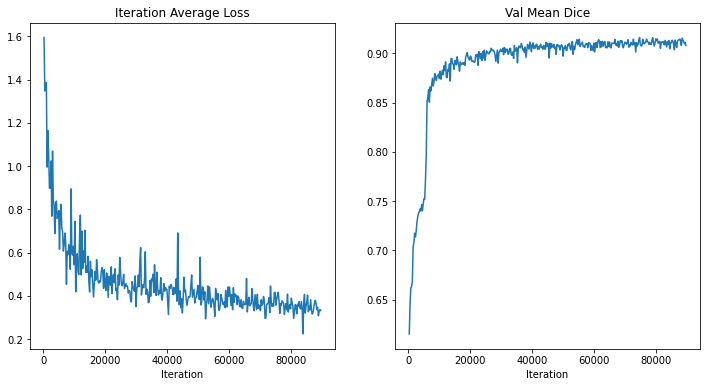

In [12]:
plt.figure("train", (12, 6))
plt.subplot(1, 2, 1)
plt.title("Iteration Average Loss")
x = [eval_num * (i + 1) for i in range(len(epoch_loss_values))]
y = epoch_loss_values
plt.xlabel("Iteration")
plt.plot(x, y)
plt.subplot(1, 2, 2)
plt.title("Val Mean Dice")
x = [eval_num * (i + 1) for i in range(len(metric_values))]
y = metric_values
plt.xlabel("Iteration")
plt.plot(x, y)
plt.show()

### Check best model output with the input image and label

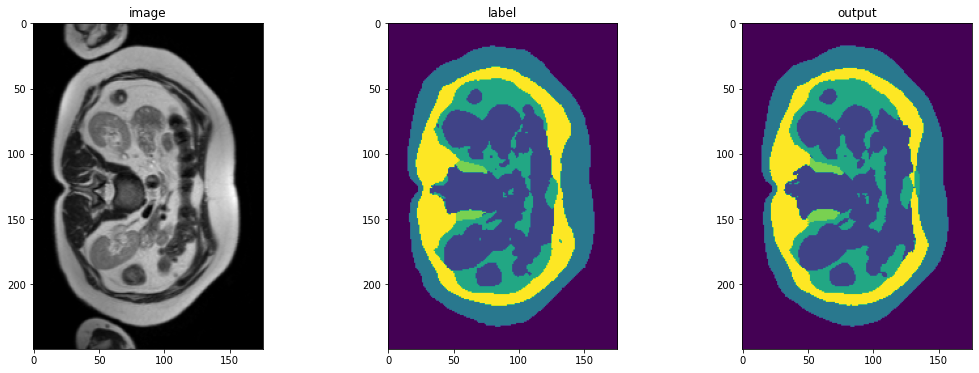

In [13]:
case_num = 0
model.load_state_dict(torch.load(os.path.join(data_dir, "TestMR06_multiclassUNetR_Sep23.pth")))
model.eval()
with torch.no_grad():
    img_name = os.path.split(val_ds[case_num]["image_meta_dict"]["filename_or_obj"])[1]
    img = val_ds[case_num]["image"]
    label = val_ds[case_num]["label"]
    val_inputs = torch.unsqueeze(img, 1).to(device)
    val_labels = torch.unsqueeze(label, 1).to(device)
    val_outputs = sliding_window_inference(
        val_inputs, (96, 96, 16), 4, model, overlap=0.8
    )
    plt.figure("check", (18, 6))
    plt.subplot(1, 3, 1)
    plt.title("image")
    plt.imshow(val_inputs.cpu().numpy()[0, 0, :, :, 5], cmap="gray")
    plt.subplot(1, 3, 2)
    plt.title("label")
    plt.imshow(val_labels.cpu().numpy()[0, 0, :, :, 5])
    plt.subplot(1, 3, 3)
    plt.title("output")
    plt.imshow(
        torch.argmax(val_outputs, dim=1).detach().cpu()[0, :, :, 5]
    )
    plt.show()
    

In [ ]:
# val_inputs.shape

### Inference on test images

In [ ]:
# if directory is None:
#     shutil.rmtree(root_dir)

In [14]:
import glob
from monai.data import Dataset
from monai.handlers.utils import from_engine
from monai.transforms import (
    AsDiscrete,
    AsDiscreted,
    EnsureChannelFirstd,
    Compose,
    CropForegroundd,
    LoadImaged,
    Orientationd,
    RandCropByPosNegLabeld,
    SaveImaged,
    ScaleIntensityRanged,
    Spacingd,
    EnsureTyped,
    EnsureType,
    Invertd,
)

test_images = sorted(
    glob.glob(os.path.join(data_dir, "imagesTs/AllVisits", "*.nii.gz")))

test_data = [{"image": image} for image in test_images]


test_org_transforms = Compose(
    [
        LoadImaged(keys="image"),
        EnsureChannelFirstd(keys="image"),
        Orientationd(keys=["image"], axcodes="RAS"),
        Spacingd(keys=["image"], pixdim=(
            1.5, 1.5, 2.0), mode="bilinear"),
        ScaleIntensityRanged(
            keys=["image"], a_min=0, a_max=250,
            b_min=0.0, b_max=1.0, clip=False,
        ),
        CropForegroundd(keys=["image"], source_key="image"),
        EnsureTyped(keys="image"),
    ]
)

test_org_ds = Dataset(
    data=test_data, transform=test_org_transforms)

test_org_loader = DataLoader(test_org_ds, batch_size=1, num_workers=4)

post_transforms = Compose([
    EnsureTyped(keys="pred"),
    Invertd(
        keys="pred",
        transform=test_org_transforms,
        orig_keys="image",
        meta_keys="pred_meta_dict",
        orig_meta_keys="image_meta_dict",
        meta_key_postfix="meta_dict",
        nearest_interp=False,
        to_tensor=True,
    ),
    AsDiscreted(keys="pred", argmax=True, to_onehot=6),
    SaveImaged(keys="pred", meta_keys="pred_meta_dict", output_dir="./outMR06_Sep23", output_postfix="seg", resample=False, separate_folder=False),
])

In [ ]:
# print(data_dir)

2023-09-14 17:49:26,095 INFO image_writer.py:194 - writing: outMR06_Sep23/A002_v1_T2W_seg.nii.gz


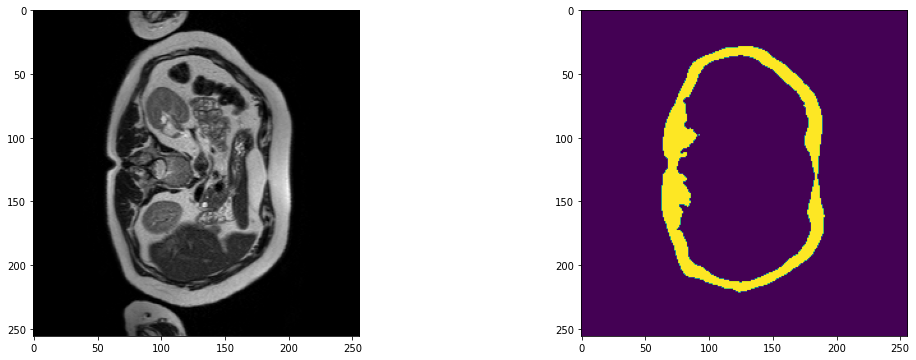

2023-09-14 17:49:31,540 INFO image_writer.py:194 - writing: outMR06_Sep23/A002_v2_T2W_seg.nii.gz


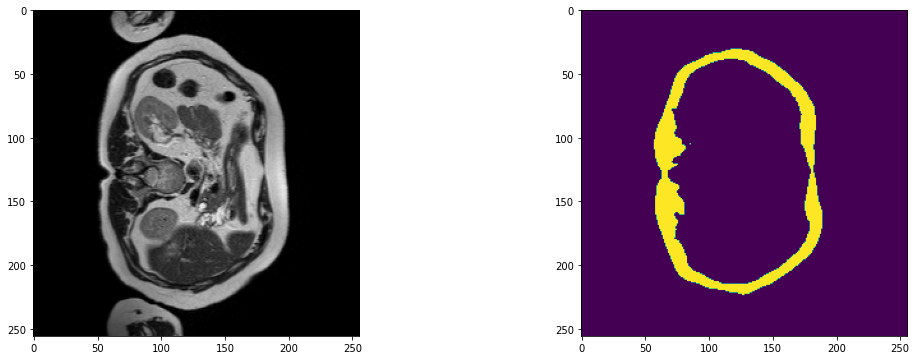

2023-09-14 17:49:36,994 INFO image_writer.py:194 - writing: outMR06_Sep23/A002_v3_T2W_seg.nii.gz


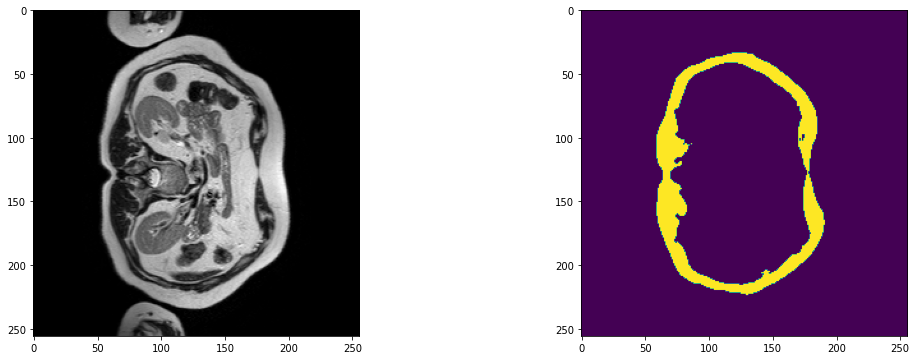

2023-09-14 17:49:42,483 INFO image_writer.py:194 - writing: outMR06_Sep23/A002_v4_T2W_seg.nii.gz


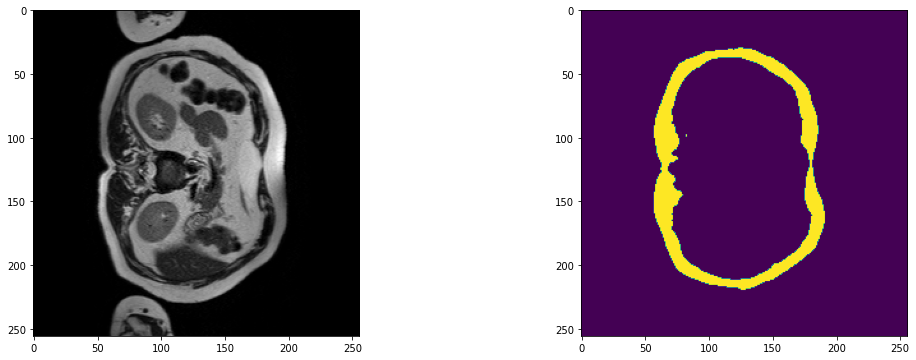

2023-09-14 17:49:48,110 INFO image_writer.py:194 - writing: outMR06_Sep23/A002_v5_T2W_seg.nii.gz


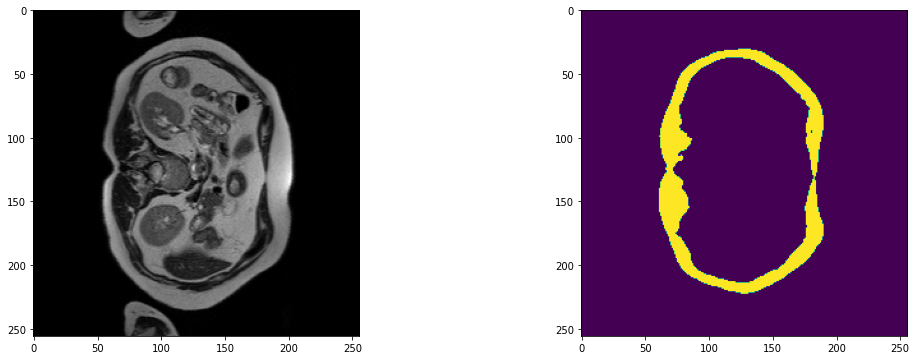

2023-09-14 17:49:53,642 INFO image_writer.py:194 - writing: outMR06_Sep23/A003_v1_T2W_seg.nii.gz


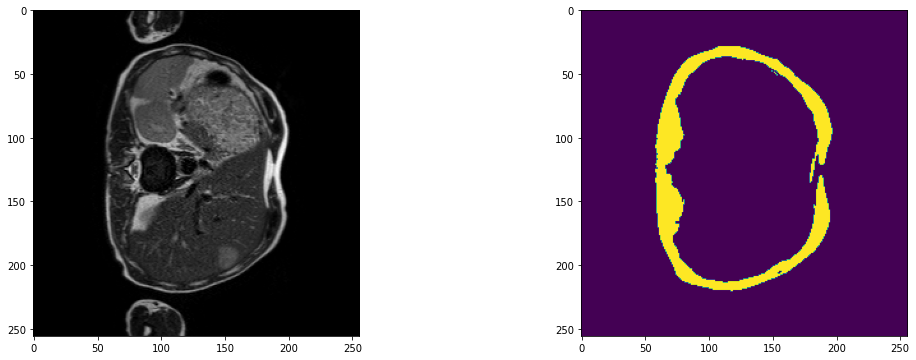

2023-09-14 17:49:59,196 INFO image_writer.py:194 - writing: outMR06_Sep23/A003_v2_T2W_seg.nii.gz


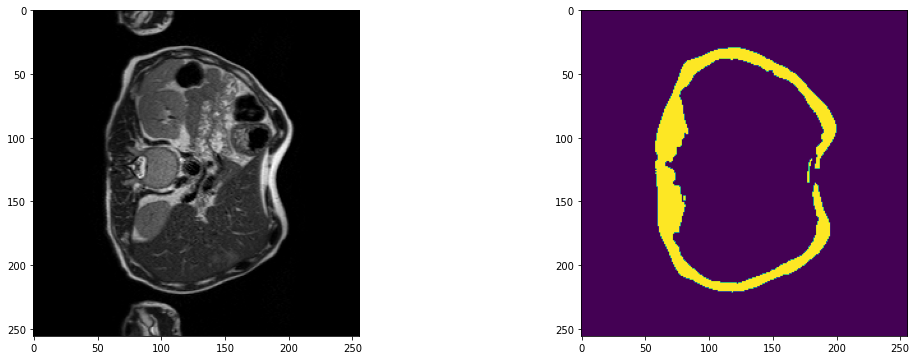

2023-09-14 17:50:04,761 INFO image_writer.py:194 - writing: outMR06_Sep23/A003_v3_T2W_seg.nii.gz


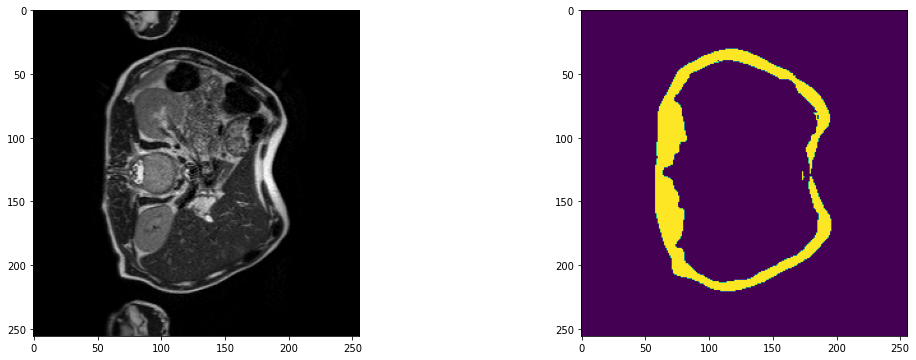

2023-09-14 17:50:10,359 INFO image_writer.py:194 - writing: outMR06_Sep23/A003_v4_T2W_seg.nii.gz


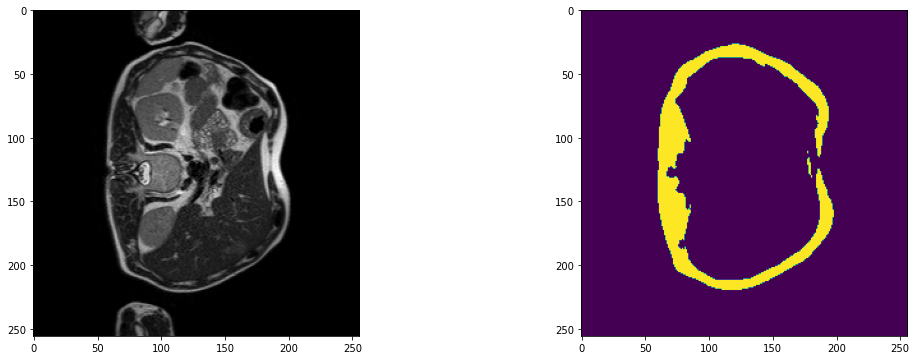

2023-09-14 17:50:15,975 INFO image_writer.py:194 - writing: outMR06_Sep23/A003_v5_T2W_seg.nii.gz


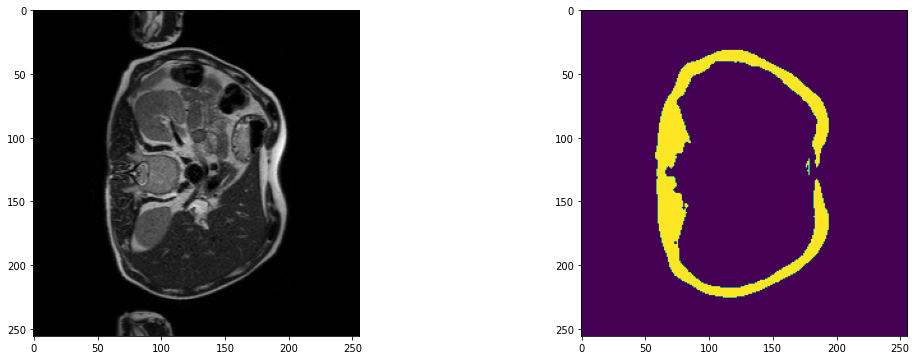

2023-09-14 17:50:21,598 INFO image_writer.py:194 - writing: outMR06_Sep23/A003_v6_T2W_seg.nii.gz


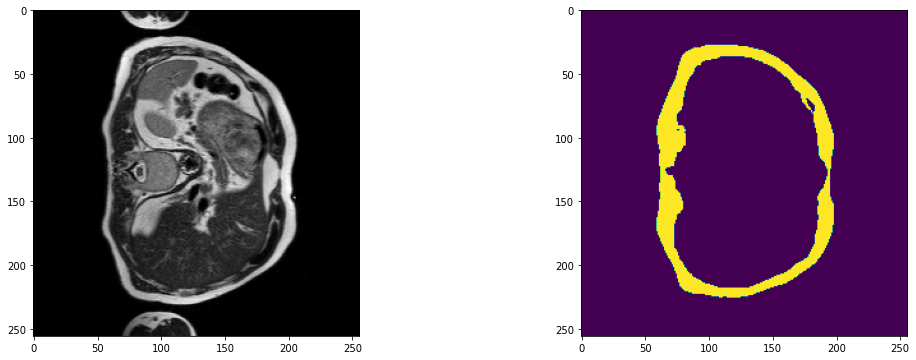

2023-09-14 17:50:27,247 INFO image_writer.py:194 - writing: outMR06_Sep23/A003_v7_T2W_seg.nii.gz


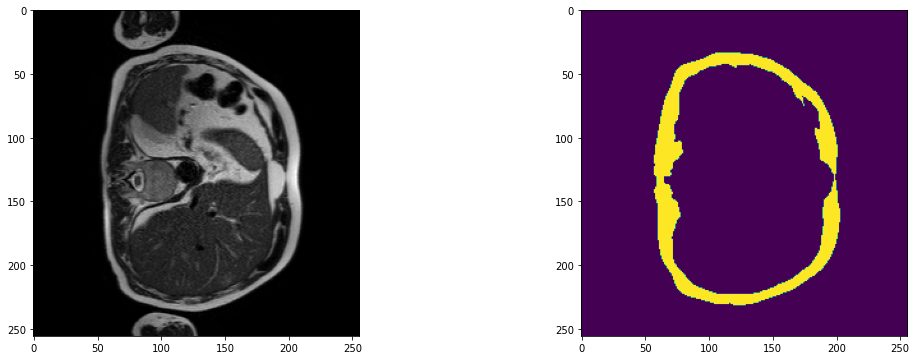

2023-09-14 17:50:32,901 INFO image_writer.py:194 - writing: outMR06_Sep23/A009_v1_T2W_seg.nii.gz


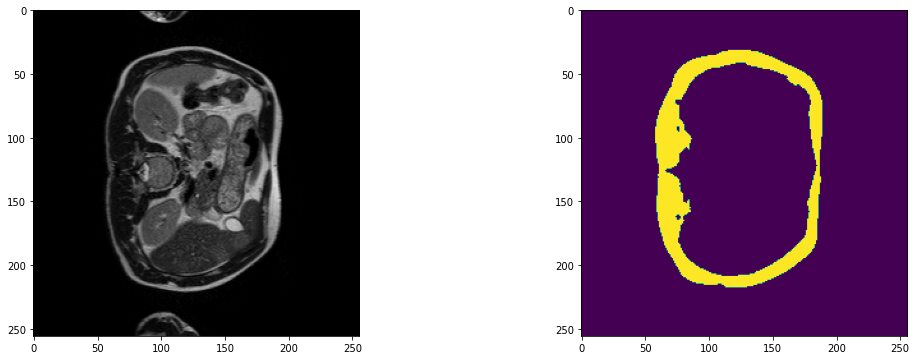

2023-09-14 17:50:38,555 INFO image_writer.py:194 - writing: outMR06_Sep23/A009_v2_T2W_seg.nii.gz


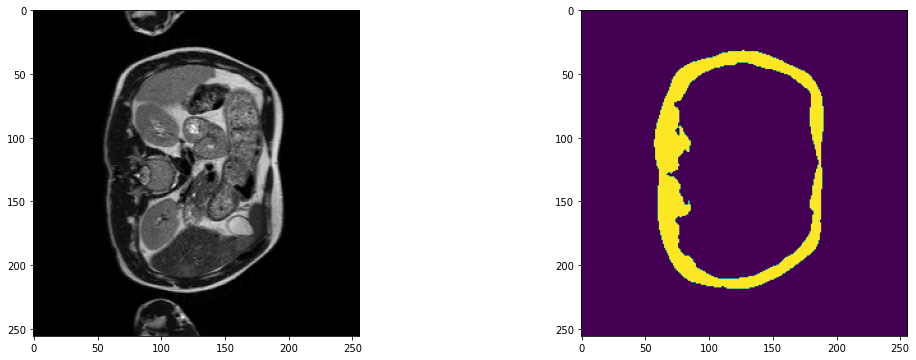

2023-09-14 17:50:44,369 INFO image_writer.py:194 - writing: outMR06_Sep23/A009_v3_T2W_seg.nii.gz


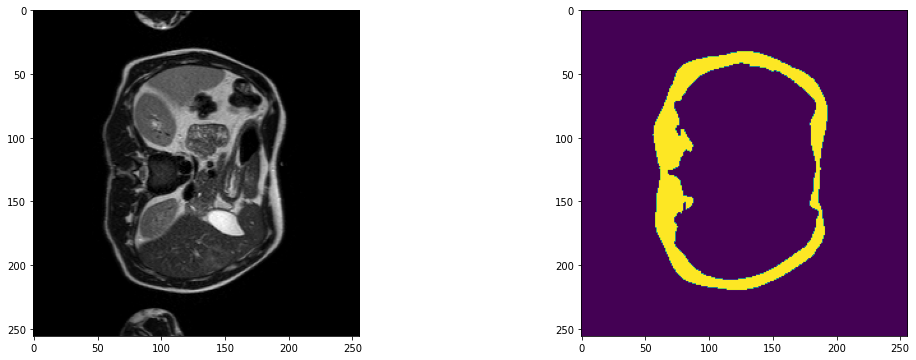

2023-09-14 17:50:50,058 INFO image_writer.py:194 - writing: outMR06_Sep23/A009_v4_T2W_seg.nii.gz


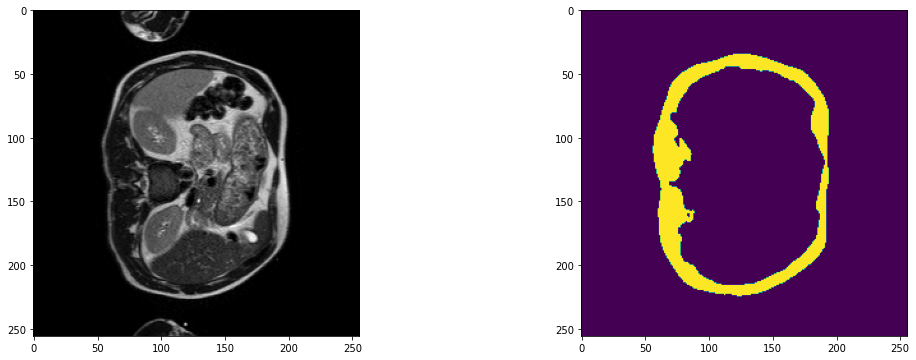

2023-09-14 17:50:55,758 INFO image_writer.py:194 - writing: outMR06_Sep23/A009_v5_T2W_seg.nii.gz


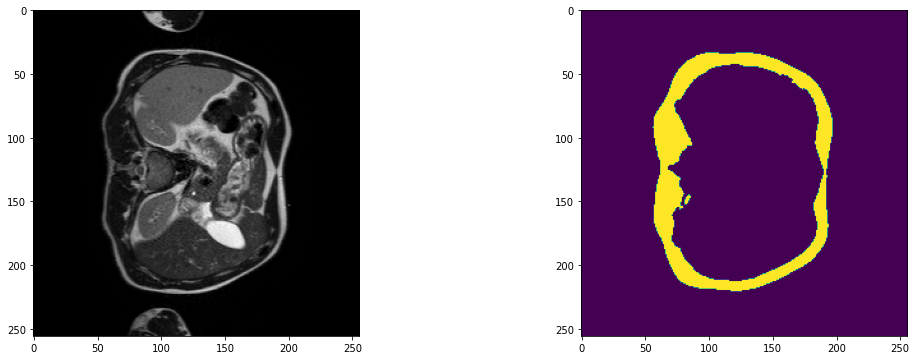

2023-09-14 17:51:01,439 INFO image_writer.py:194 - writing: outMR06_Sep23/A009_v6_T2W_seg.nii.gz


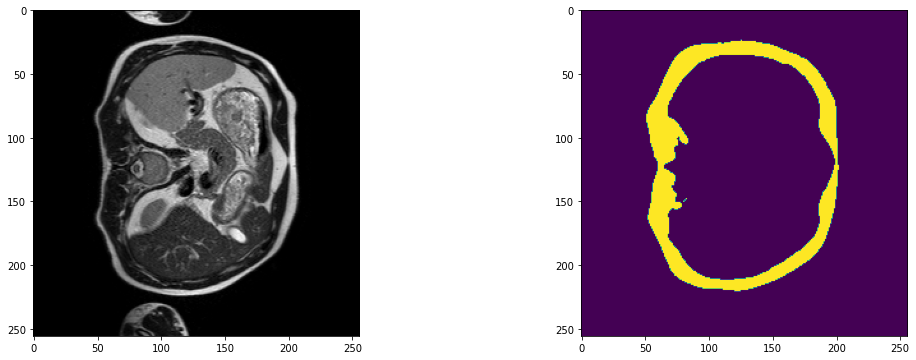

2023-09-14 17:51:07,103 INFO image_writer.py:194 - writing: outMR06_Sep23/A011_v1_T2W_seg.nii.gz


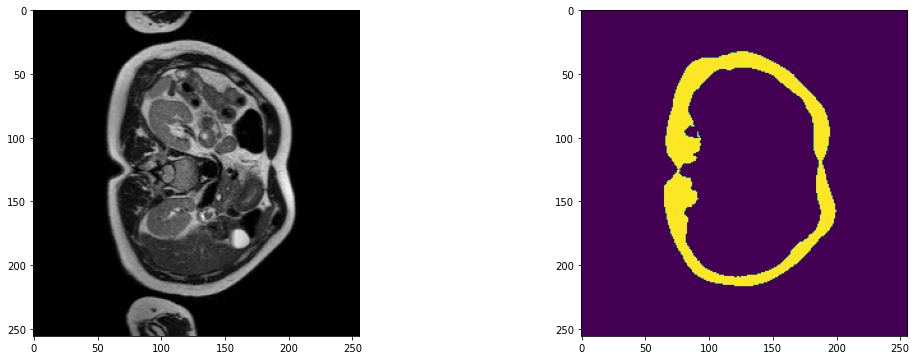

2023-09-14 17:51:12,815 INFO image_writer.py:194 - writing: outMR06_Sep23/A011_v2_T2W_seg.nii.gz


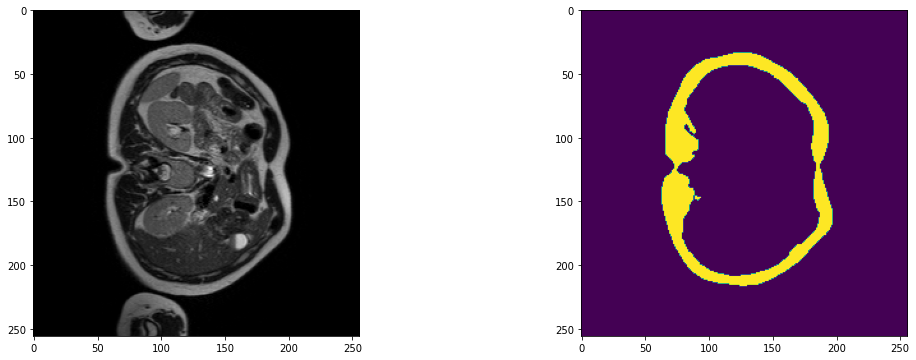

2023-09-14 17:51:18,538 INFO image_writer.py:194 - writing: outMR06_Sep23/A011_v3_T2W_seg.nii.gz


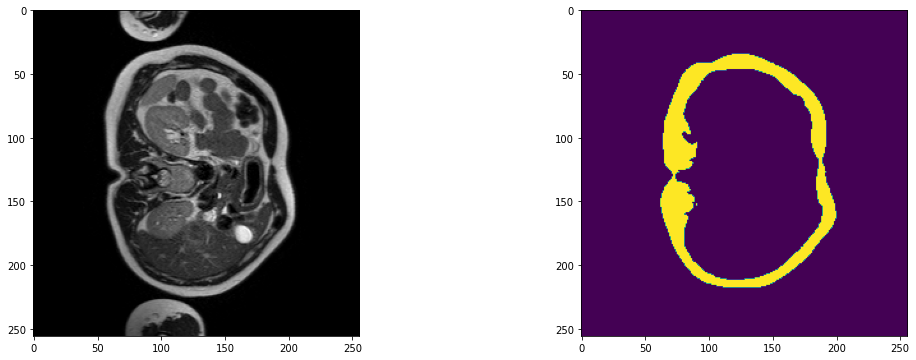

2023-09-14 17:51:24,250 INFO image_writer.py:194 - writing: outMR06_Sep23/A011_v4_T2W_seg.nii.gz


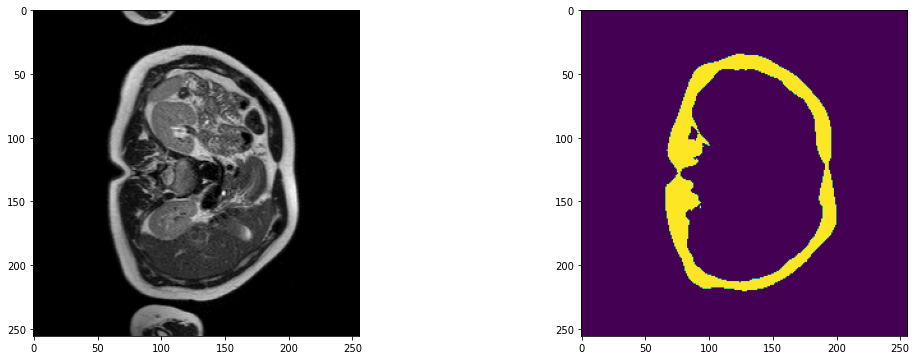

2023-09-14 17:51:29,972 INFO image_writer.py:194 - writing: outMR06_Sep23/A011_v5_T2W_seg.nii.gz


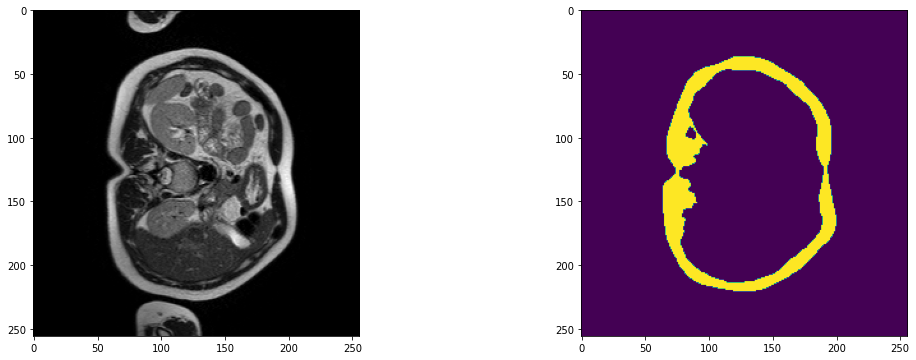

2023-09-14 17:51:35,682 INFO image_writer.py:194 - writing: outMR06_Sep23/A011_v6_T2W_seg.nii.gz


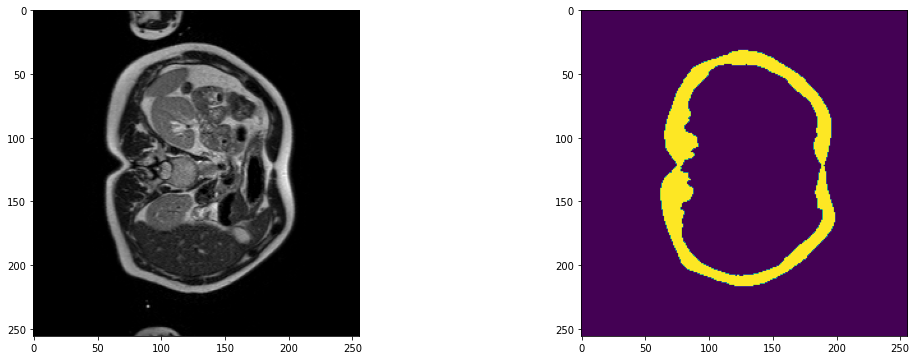

2023-09-14 17:51:41,355 INFO image_writer.py:194 - writing: outMR06_Sep23/A011_v7_T2W_seg.nii.gz


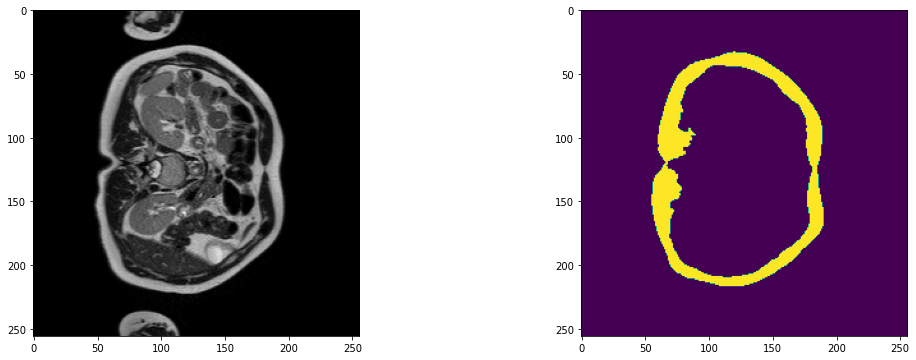

2023-09-14 17:51:47,110 INFO image_writer.py:194 - writing: outMR06_Sep23/A011_v8_T2W_seg.nii.gz


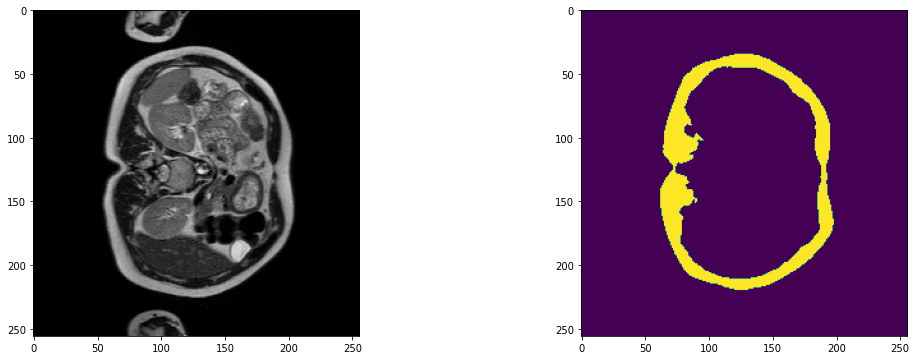

2023-09-14 17:51:52,796 INFO image_writer.py:194 - writing: outMR06_Sep23/A011_v9_T2W_seg.nii.gz


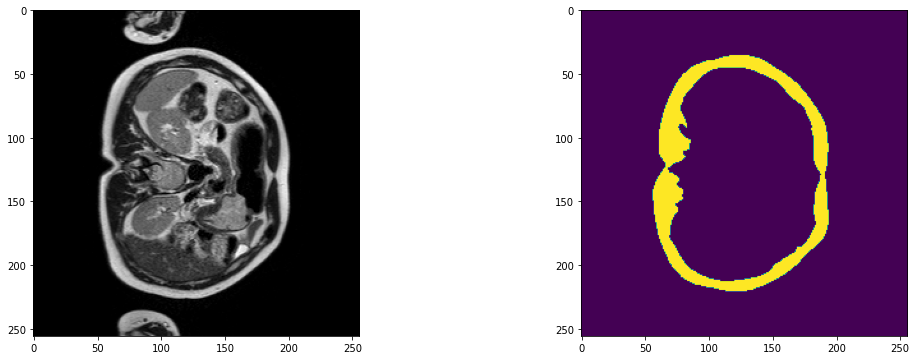

2023-09-14 17:51:58,542 INFO image_writer.py:194 - writing: outMR06_Sep23/A013_v1_T2W_seg.nii.gz


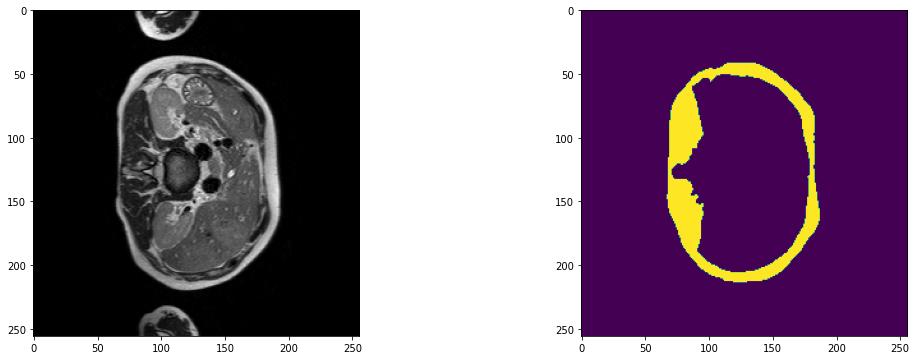

2023-09-14 17:52:03,583 INFO image_writer.py:194 - writing: outMR06_Sep23/A013_v2_T2W_seg.nii.gz


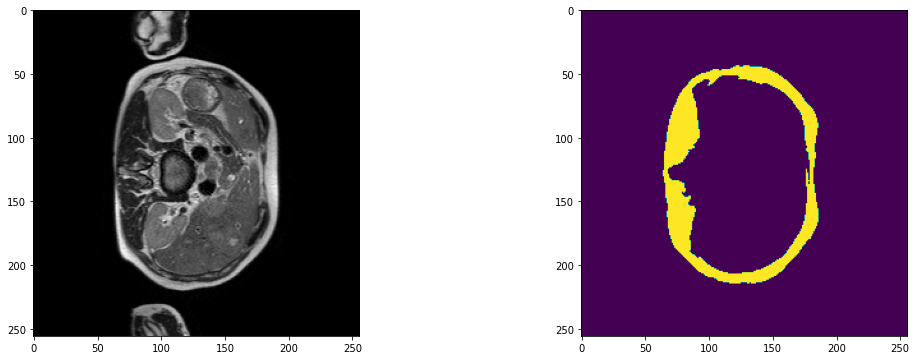

2023-09-14 17:52:08,469 INFO image_writer.py:194 - writing: outMR06_Sep23/A013_v3_T2W_seg.nii.gz


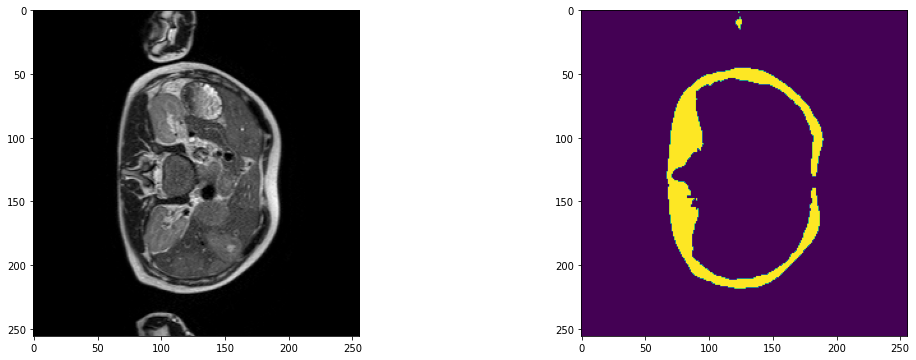

2023-09-14 17:52:13,344 INFO image_writer.py:194 - writing: outMR06_Sep23/A013_v4_T2W_seg.nii.gz


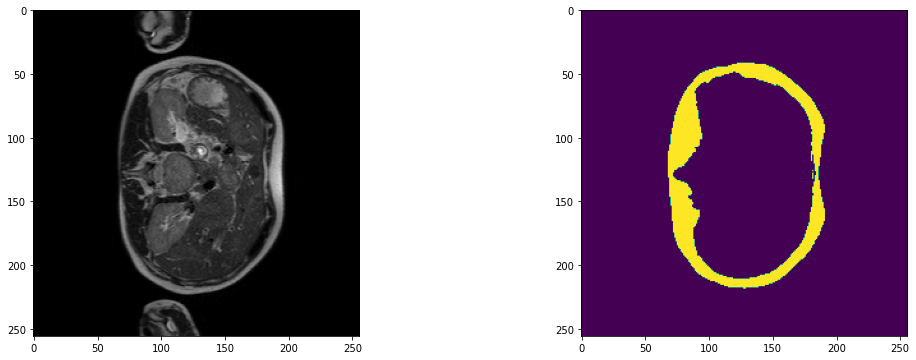

2023-09-14 17:52:18,238 INFO image_writer.py:194 - writing: outMR06_Sep23/A013_v5_T2W_seg.nii.gz


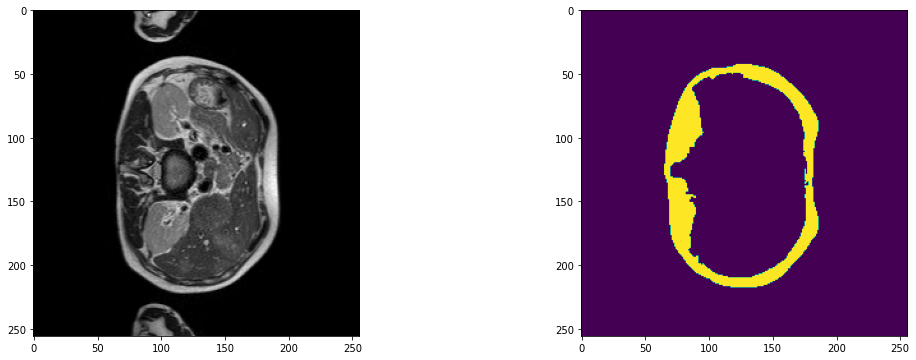

2023-09-14 17:52:23,971 INFO image_writer.py:194 - writing: outMR06_Sep23/A014_v1_T2W_seg.nii.gz


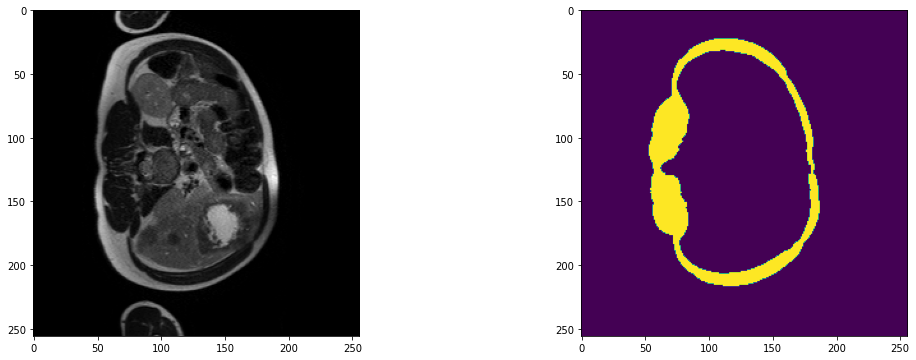

2023-09-14 17:52:29,707 INFO image_writer.py:194 - writing: outMR06_Sep23/A014_v2_T2W_seg.nii.gz


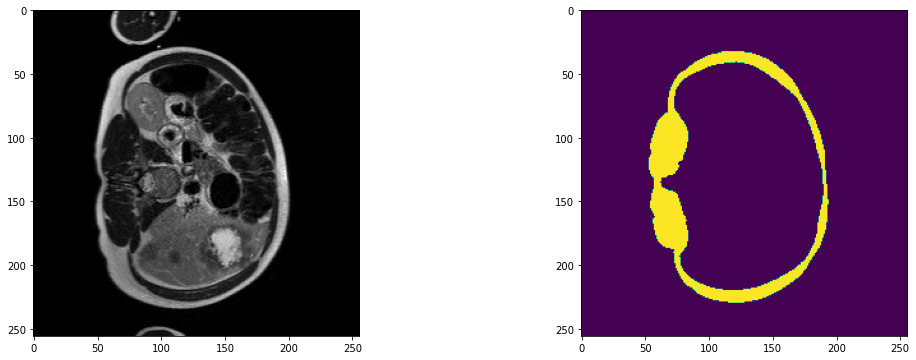

2023-09-14 17:52:35,426 INFO image_writer.py:194 - writing: outMR06_Sep23/A014_v3_T2W_seg.nii.gz


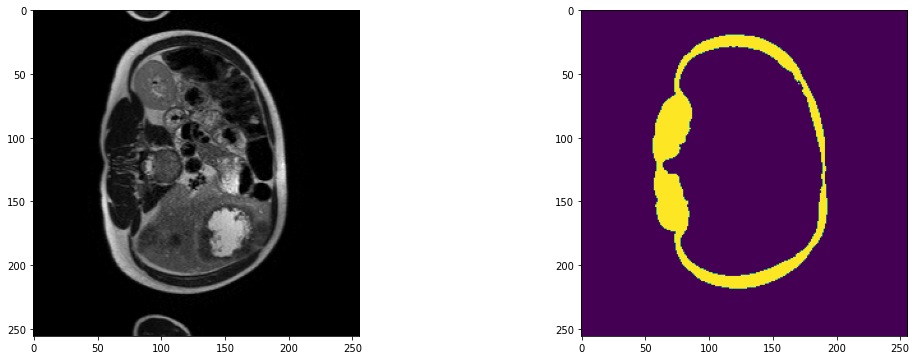

2023-09-14 17:52:41,159 INFO image_writer.py:194 - writing: outMR06_Sep23/A014_v4_T2W_seg.nii.gz


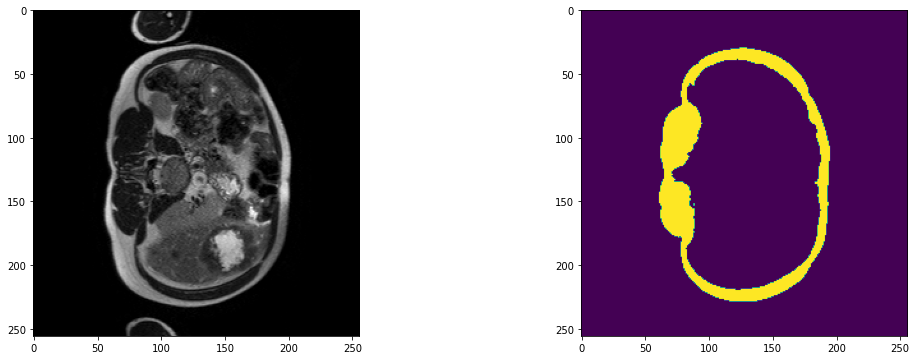

2023-09-14 17:52:46,907 INFO image_writer.py:194 - writing: outMR06_Sep23/A014_v5_T2W_seg.nii.gz


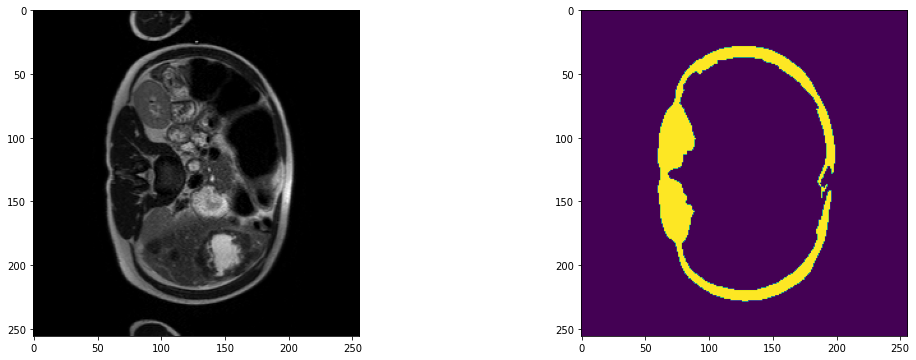

2023-09-14 17:52:51,806 INFO image_writer.py:194 - writing: outMR06_Sep23/A014_v6_T2W_seg.nii.gz


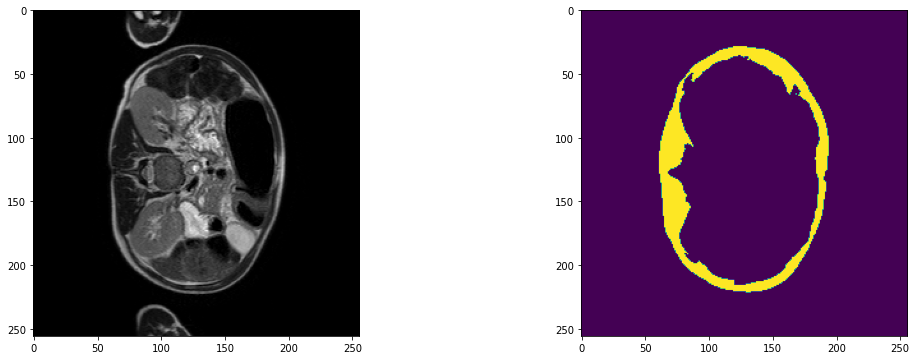

2023-09-14 17:52:57,522 INFO image_writer.py:194 - writing: outMR06_Sep23/A014_v7_T2W_seg.nii.gz


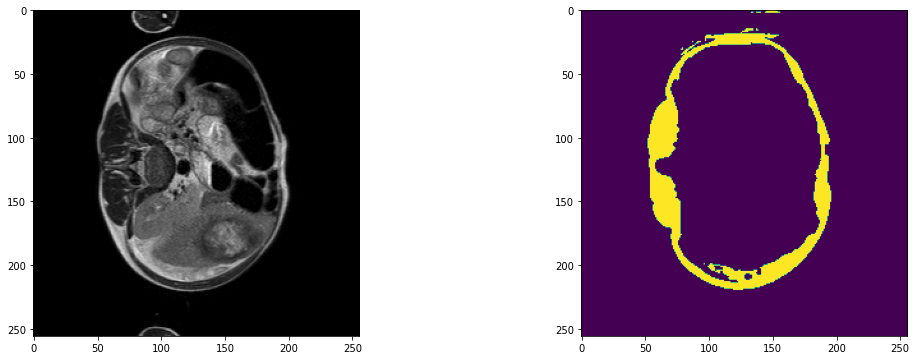

2023-09-14 17:53:03,235 INFO image_writer.py:194 - writing: outMR06_Sep23/A015_v1_T2W_seg.nii.gz


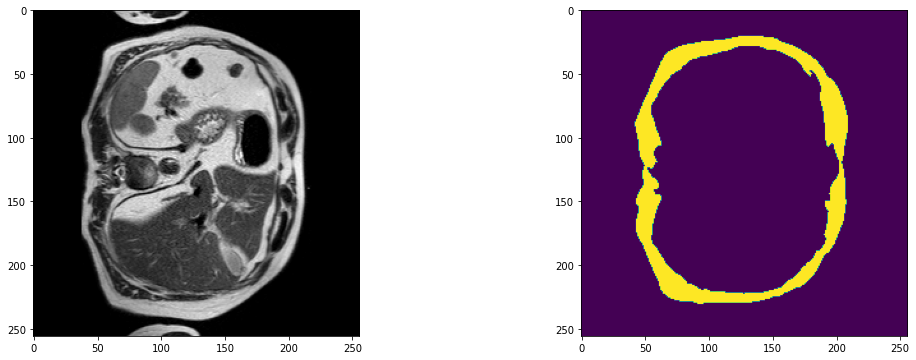

2023-09-14 17:53:08,965 INFO image_writer.py:194 - writing: outMR06_Sep23/A015_v2_T2W_seg.nii.gz


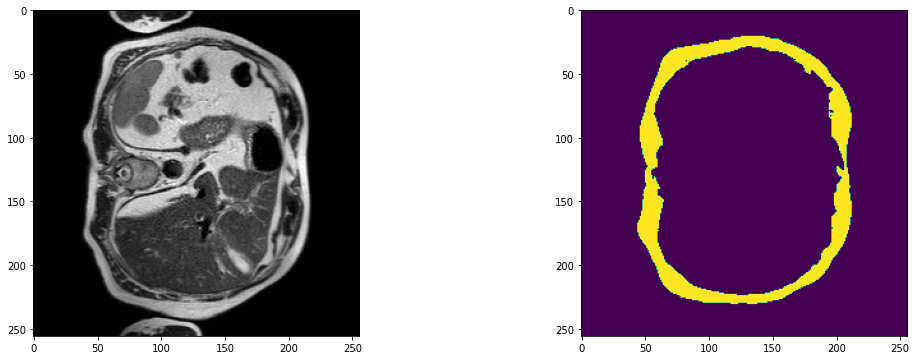

2023-09-14 17:53:14,704 INFO image_writer.py:194 - writing: outMR06_Sep23/A015_v3_T2W_seg.nii.gz


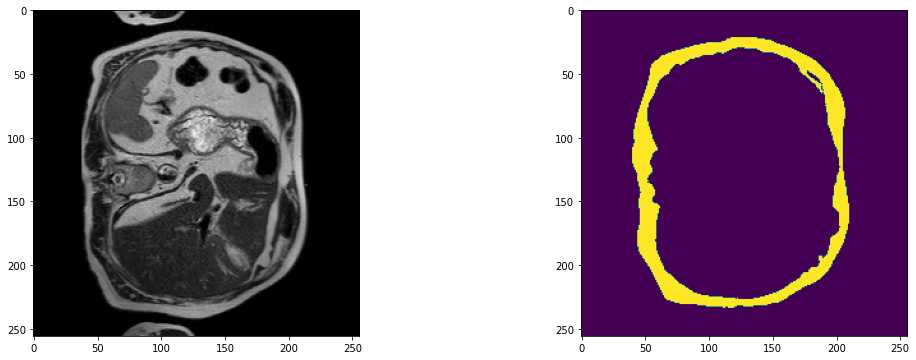

2023-09-14 17:53:20,614 INFO image_writer.py:194 - writing: outMR06_Sep23/A015_v4_T2W_seg.nii.gz


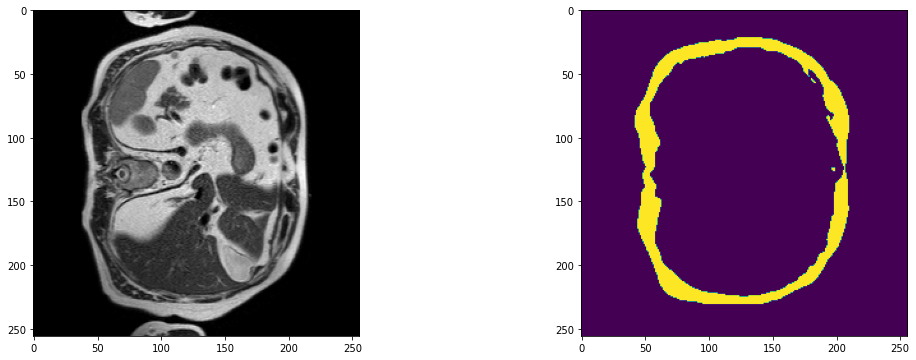

2023-09-14 17:53:26,393 INFO image_writer.py:194 - writing: outMR06_Sep23/A015_v5_T2W_seg.nii.gz


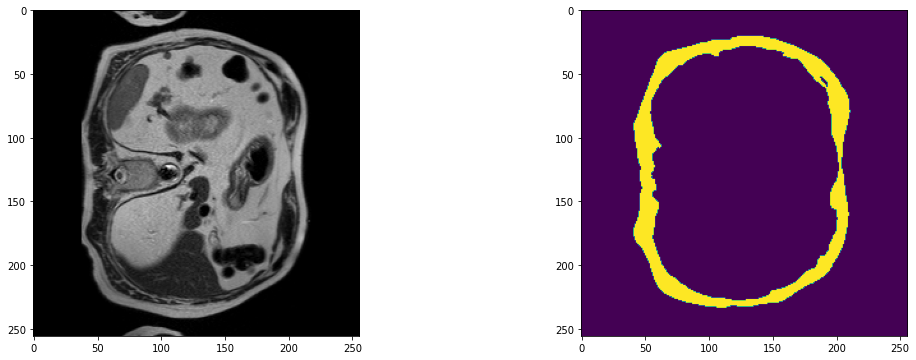

2023-09-14 17:53:32,145 INFO image_writer.py:194 - writing: outMR06_Sep23/A015_v6_T2W_seg.nii.gz


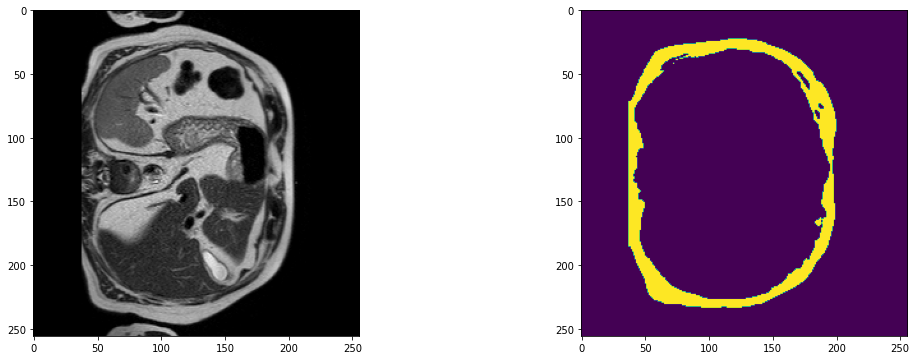

2023-09-14 17:53:37,900 INFO image_writer.py:194 - writing: outMR06_Sep23/A015_v7_T2W_seg.nii.gz


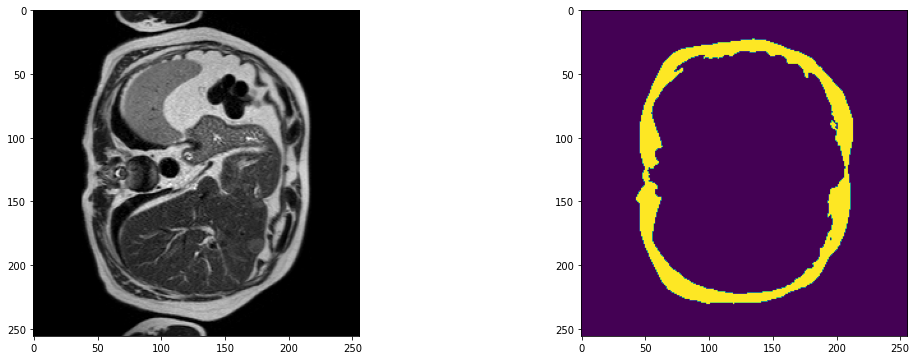

2023-09-14 17:53:43,657 INFO image_writer.py:194 - writing: outMR06_Sep23/A015_v8_T2W_seg.nii.gz


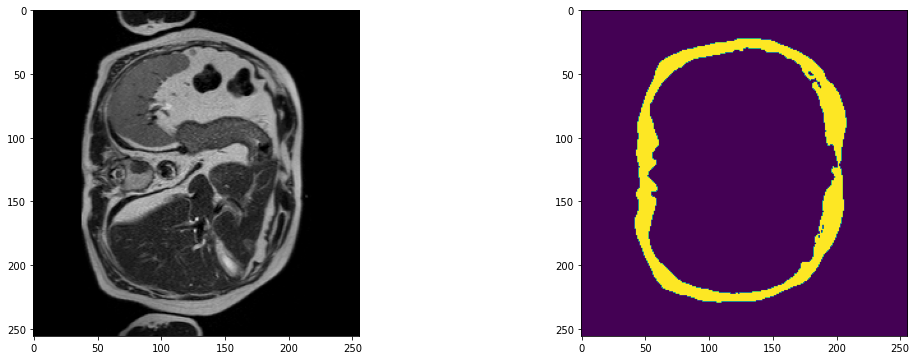

2023-09-14 17:53:49,407 INFO image_writer.py:194 - writing: outMR06_Sep23/A016_v1_T2W_seg.nii.gz


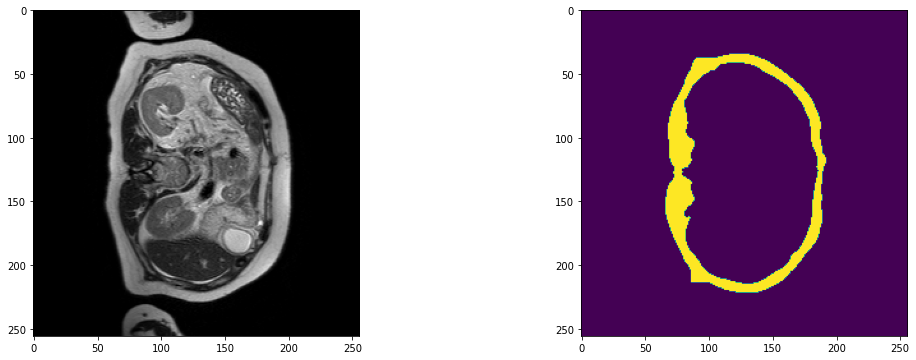

2023-09-14 17:53:55,165 INFO image_writer.py:194 - writing: outMR06_Sep23/A016_v2_T2W_seg.nii.gz


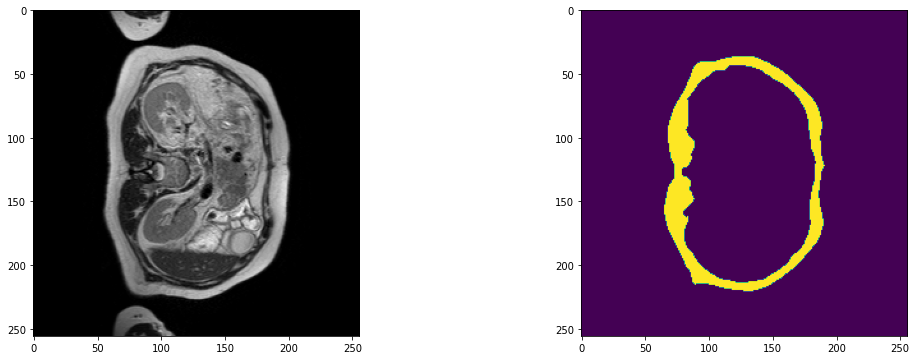

2023-09-14 17:54:00,924 INFO image_writer.py:194 - writing: outMR06_Sep23/A016_v3_T2W_seg.nii.gz


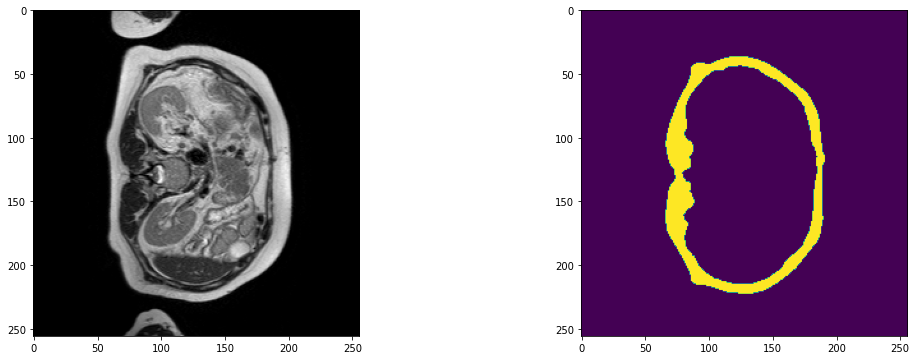

2023-09-14 17:54:06,673 INFO image_writer.py:194 - writing: outMR06_Sep23/A016_v4_T2W_seg.nii.gz


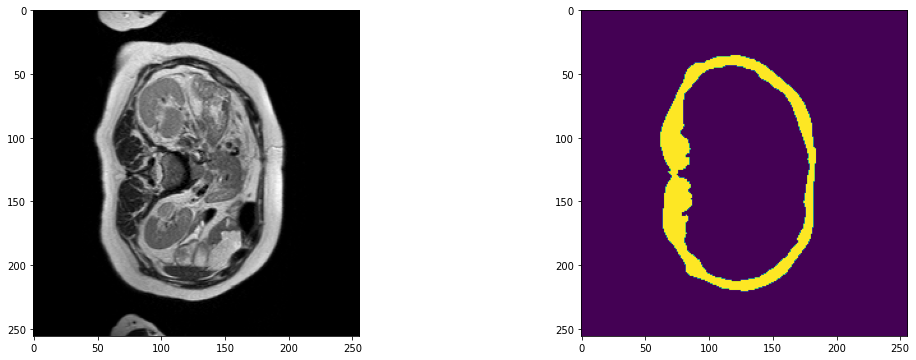

2023-09-14 17:54:12,446 INFO image_writer.py:194 - writing: outMR06_Sep23/A016_v5_T2W_seg.nii.gz


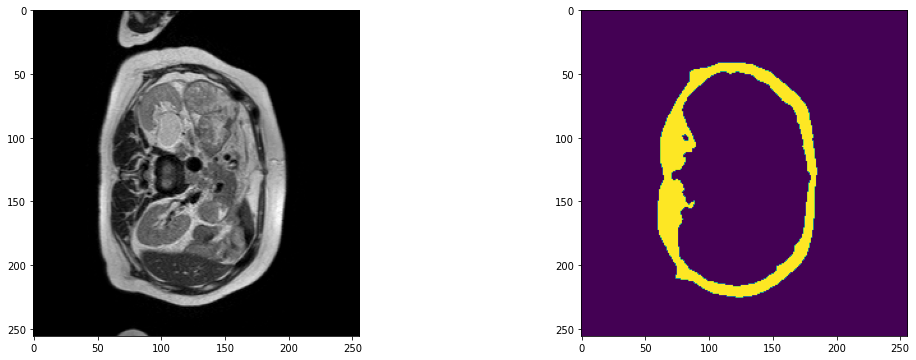

2023-09-14 17:54:18,217 INFO image_writer.py:194 - writing: outMR06_Sep23/A016_v6_T2W_seg.nii.gz


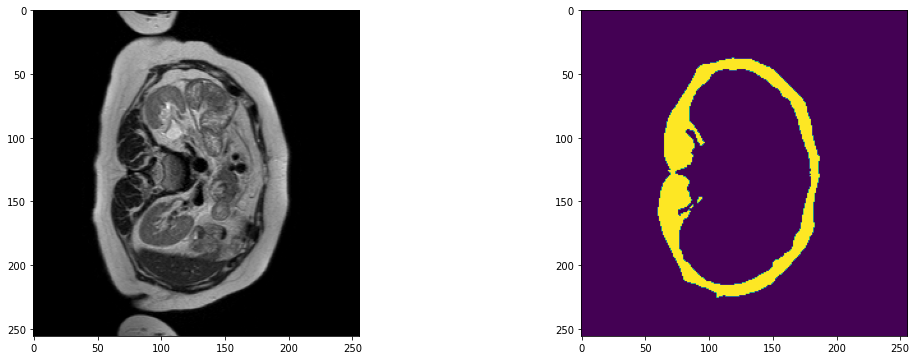

2023-09-14 17:54:23,981 INFO image_writer.py:194 - writing: outMR06_Sep23/A016_v7_T2W_seg.nii.gz


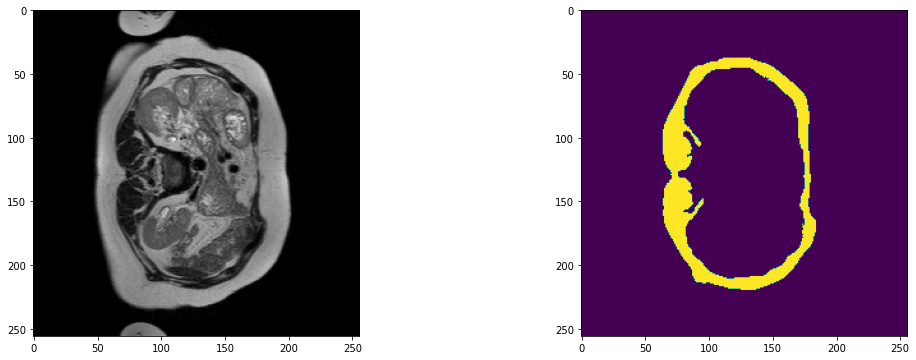

2023-09-14 17:54:29,749 INFO image_writer.py:194 - writing: outMR06_Sep23/A017_v1_T2W_seg.nii.gz


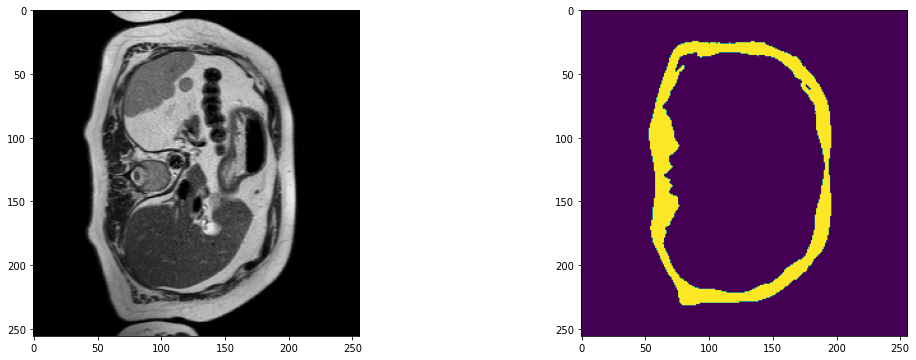

2023-09-14 17:54:35,535 INFO image_writer.py:194 - writing: outMR06_Sep23/A017_v2_T2W_seg.nii.gz


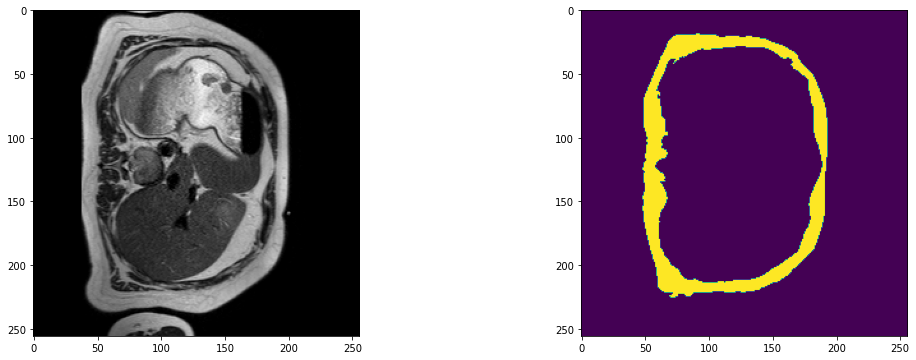

2023-09-14 17:54:41,605 INFO image_writer.py:194 - writing: outMR06_Sep23/A017_v3_T2W_seg.nii.gz


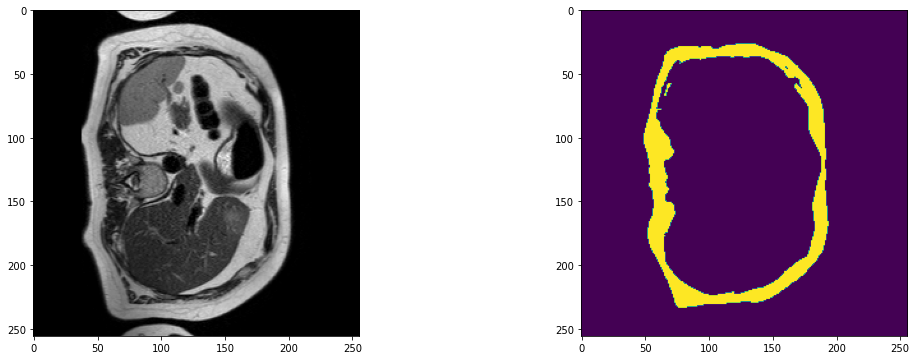

2023-09-14 17:54:47,440 INFO image_writer.py:194 - writing: outMR06_Sep23/A017_v4_T2W_seg.nii.gz


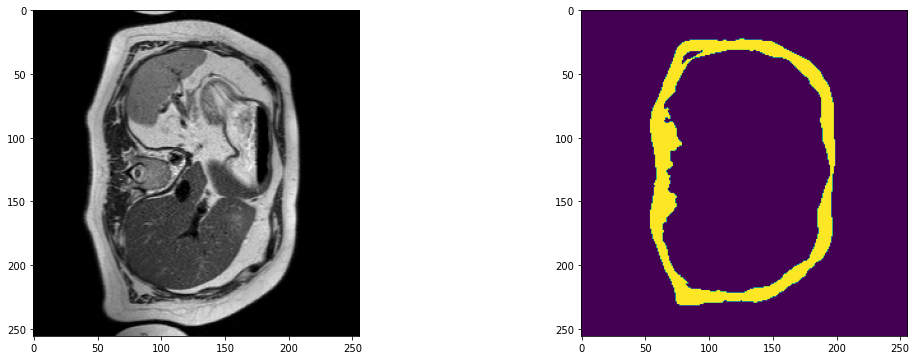

2023-09-14 17:54:53,214 INFO image_writer.py:194 - writing: outMR06_Sep23/A017_v5_T2W_seg.nii.gz


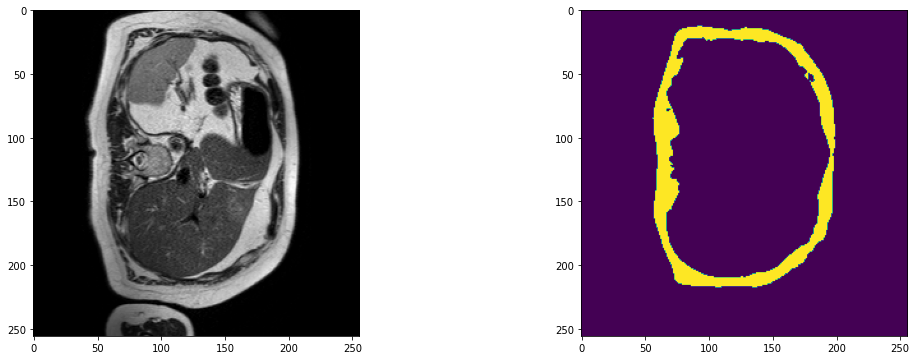

2023-09-14 17:54:59,036 INFO image_writer.py:194 - writing: outMR06_Sep23/A017_v6_T2W_seg.nii.gz


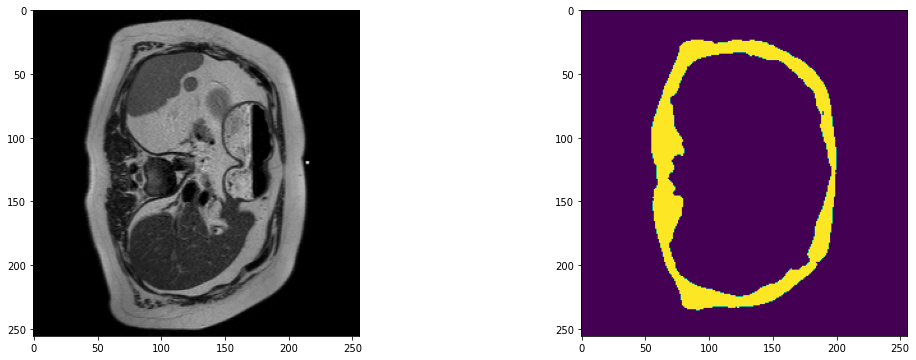

2023-09-14 17:55:04,843 INFO image_writer.py:194 - writing: outMR06_Sep23/A017_v7_T2W_seg.nii.gz


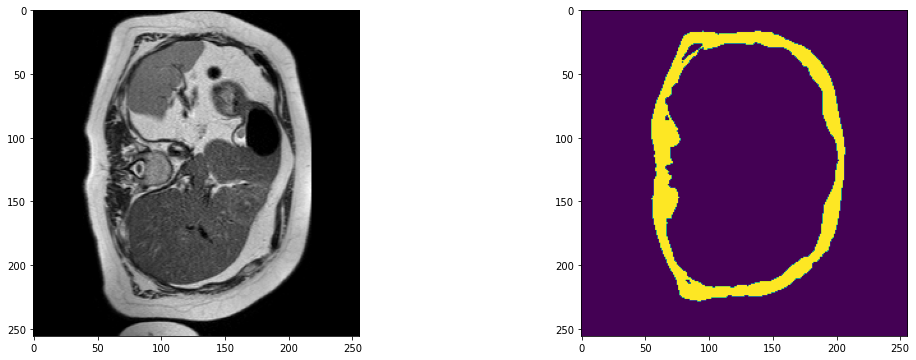

2023-09-14 17:55:10,635 INFO image_writer.py:194 - writing: outMR06_Sep23/A018_v1_T2W_seg.nii.gz


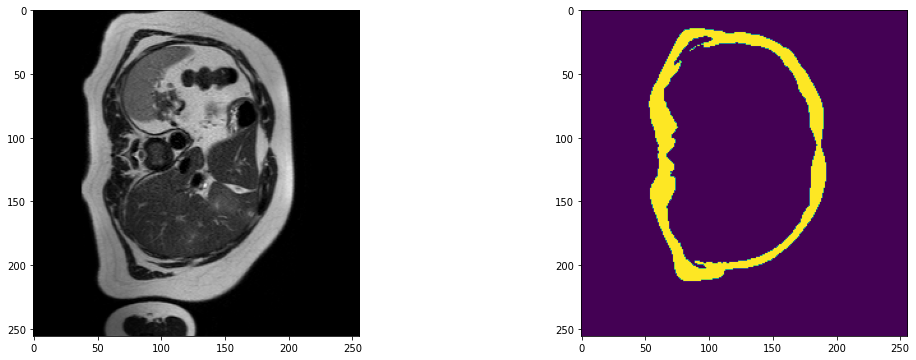

2023-09-14 17:55:16,422 INFO image_writer.py:194 - writing: outMR06_Sep23/A018_v2_T2W_seg.nii.gz


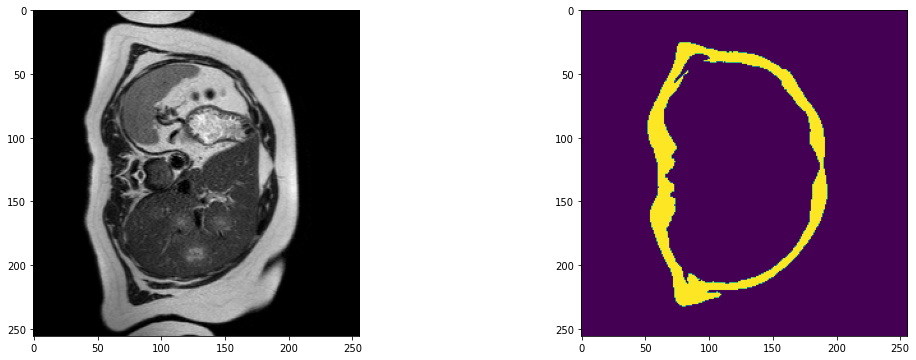

2023-09-14 17:55:22,206 INFO image_writer.py:194 - writing: outMR06_Sep23/A018_v3_T2W_seg.nii.gz


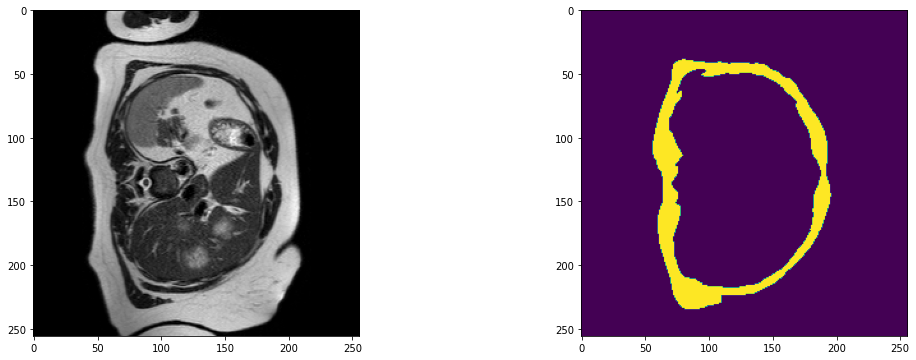

2023-09-14 17:55:27,979 INFO image_writer.py:194 - writing: outMR06_Sep23/A018_v4_T2W_seg.nii.gz


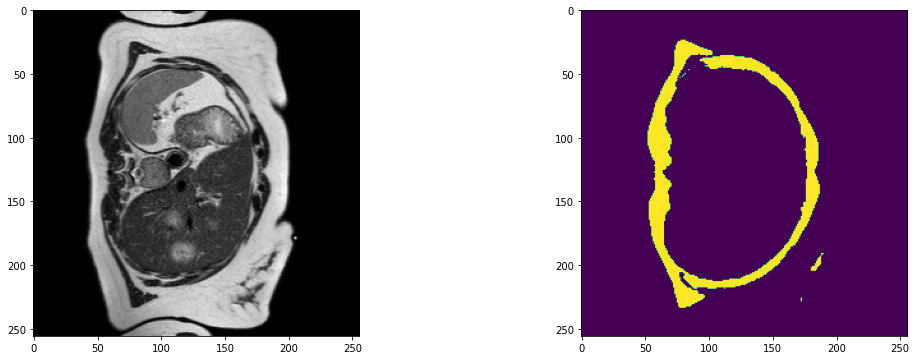

2023-09-14 17:55:33,756 INFO image_writer.py:194 - writing: outMR06_Sep23/A018_v5_T2W_seg.nii.gz


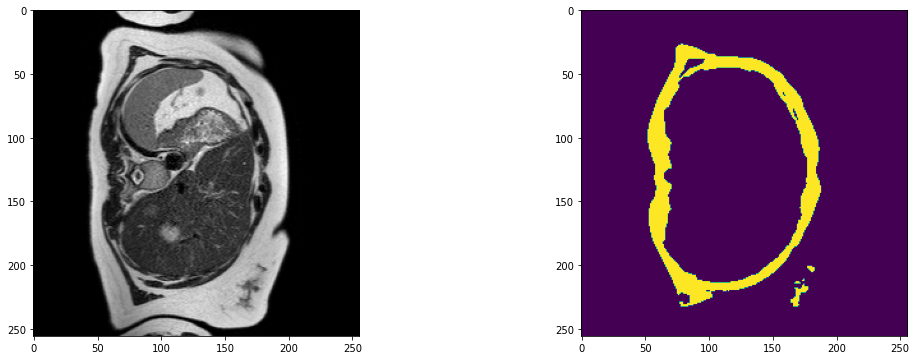

2023-09-14 17:55:39,528 INFO image_writer.py:194 - writing: outMR06_Sep23/A018_v6_T2W_seg.nii.gz


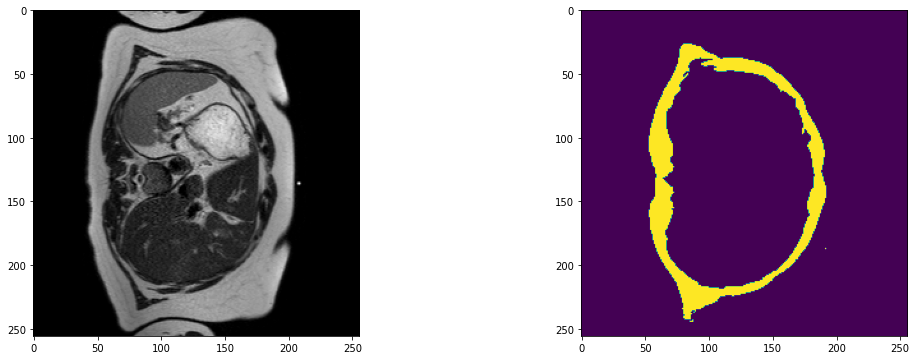

2023-09-14 17:55:45,293 INFO image_writer.py:194 - writing: outMR06_Sep23/A018_v7_T2W_seg.nii.gz


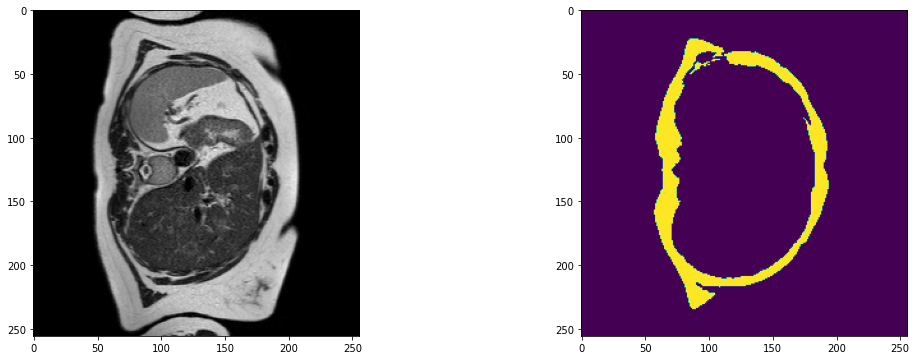

2023-09-14 17:55:51,064 INFO image_writer.py:194 - writing: outMR06_Sep23/A021_v1_T2W_seg.nii.gz


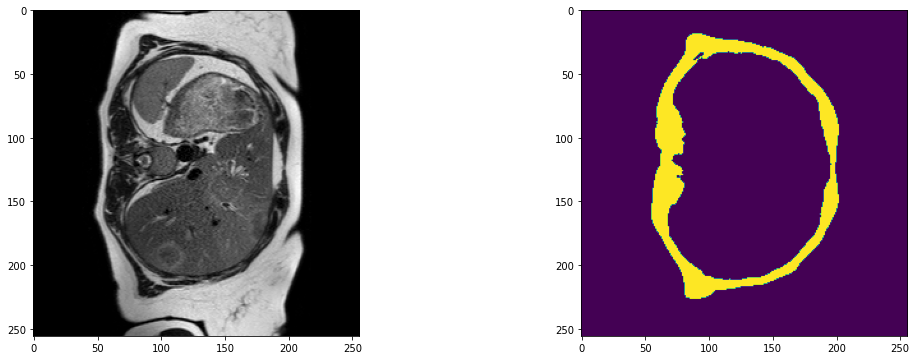

2023-09-14 17:55:56,863 INFO image_writer.py:194 - writing: outMR06_Sep23/A021_v2_T2W_seg.nii.gz


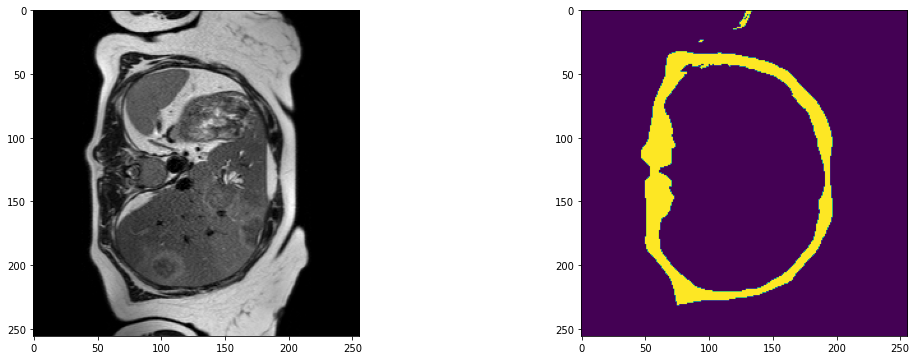

2023-09-14 17:56:02,883 INFO image_writer.py:194 - writing: outMR06_Sep23/A021_v3_T2W_seg.nii.gz


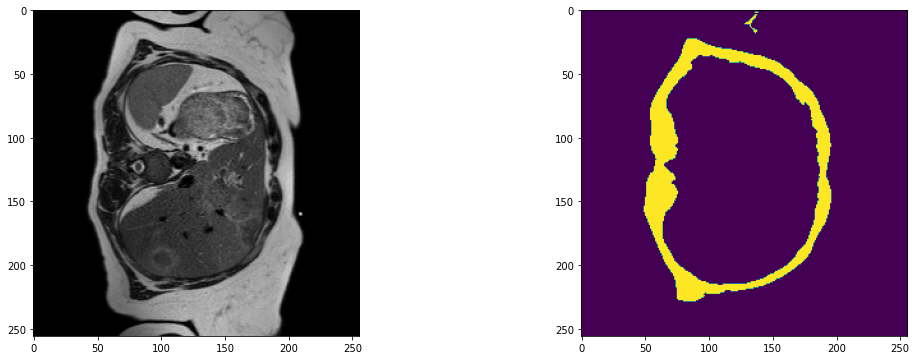

2023-09-14 17:56:08,674 INFO image_writer.py:194 - writing: outMR06_Sep23/A021_v4_T2W_seg.nii.gz


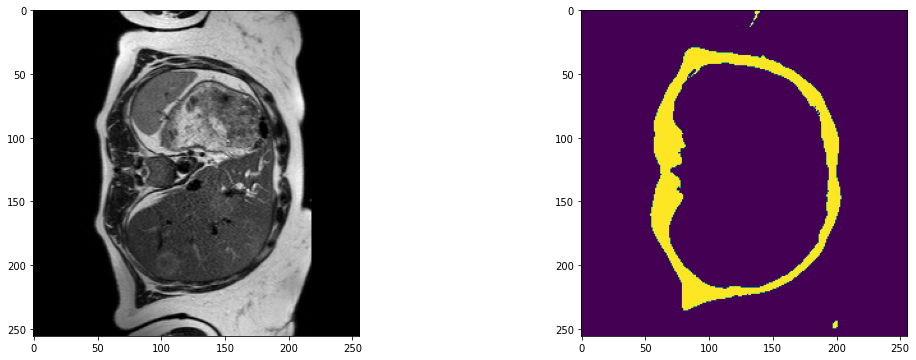

2023-09-14 17:56:14,460 INFO image_writer.py:194 - writing: outMR06_Sep23/A021_v5_T2W_seg.nii.gz


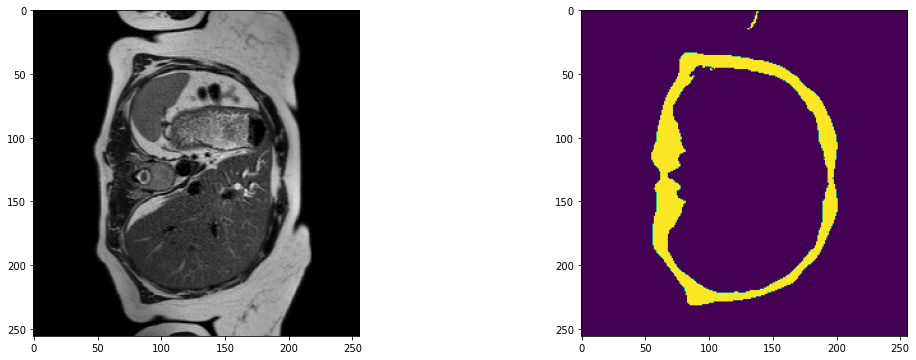

2023-09-14 17:56:20,257 INFO image_writer.py:194 - writing: outMR06_Sep23/A021_v6_T2W_seg.nii.gz


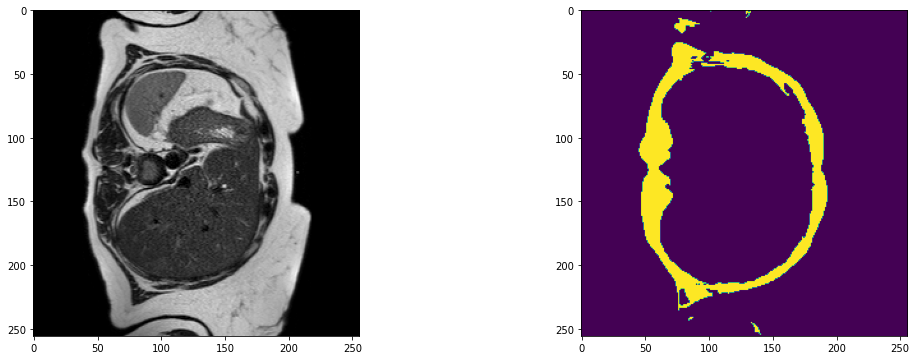

2023-09-14 17:56:26,062 INFO image_writer.py:194 - writing: outMR06_Sep23/A021_v7_T2W_seg.nii.gz


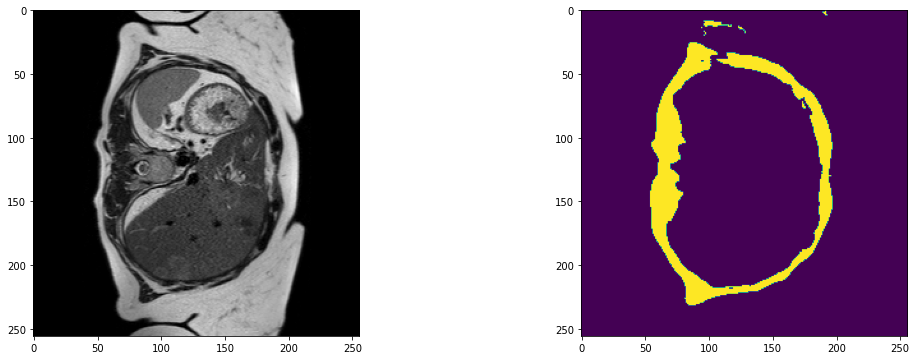

2023-09-14 17:56:38,766 INFO image_writer.py:194 - writing: outMR06_Sep23/A022_v1_T2W_seg.nii.gz


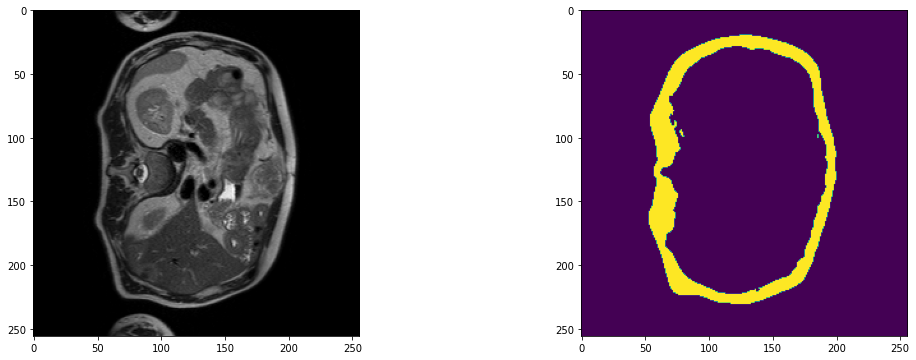

2023-09-14 17:56:51,512 INFO image_writer.py:194 - writing: outMR06_Sep23/A022_v2_T2W_seg.nii.gz


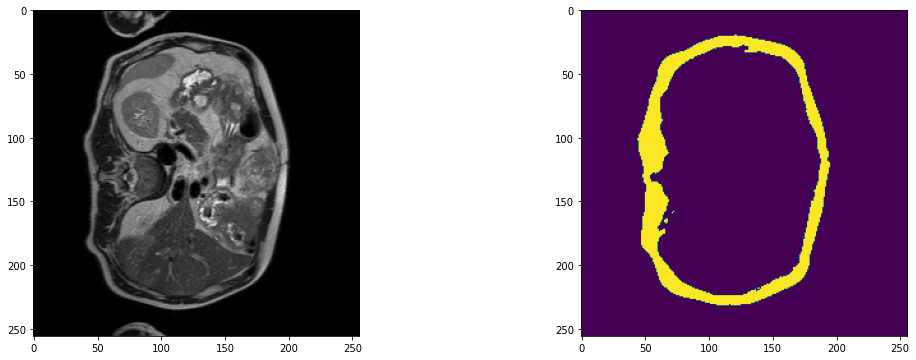

2023-09-14 17:57:04,245 INFO image_writer.py:194 - writing: outMR06_Sep23/A022_v3_T2W_seg.nii.gz


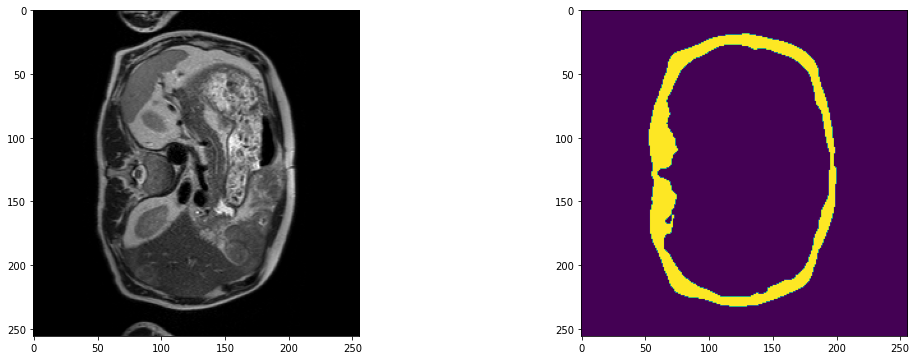

2023-09-14 17:57:16,974 INFO image_writer.py:194 - writing: outMR06_Sep23/A022_v4_T2W_seg.nii.gz


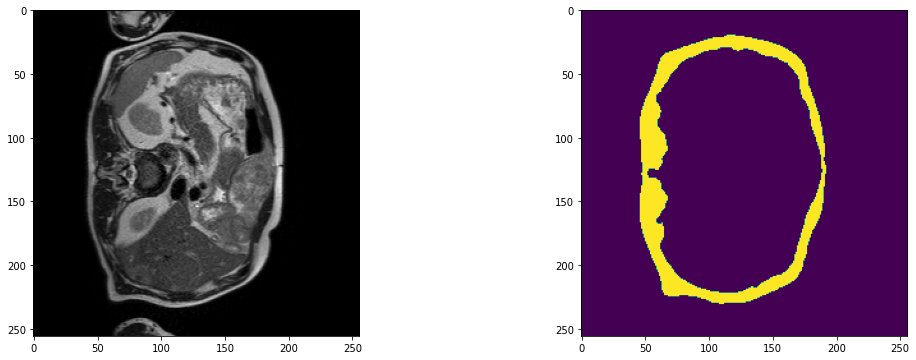

2023-09-14 17:57:29,740 INFO image_writer.py:194 - writing: outMR06_Sep23/A022_v5_T2W_seg.nii.gz


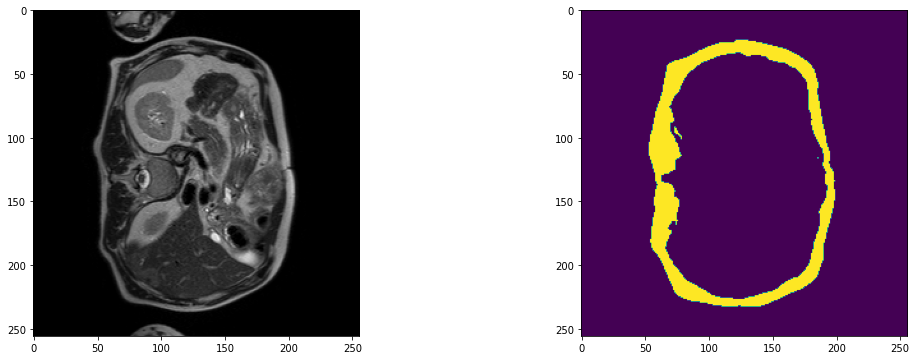

2023-09-14 17:57:42,500 INFO image_writer.py:194 - writing: outMR06_Sep23/A022_v6_T2W_seg.nii.gz


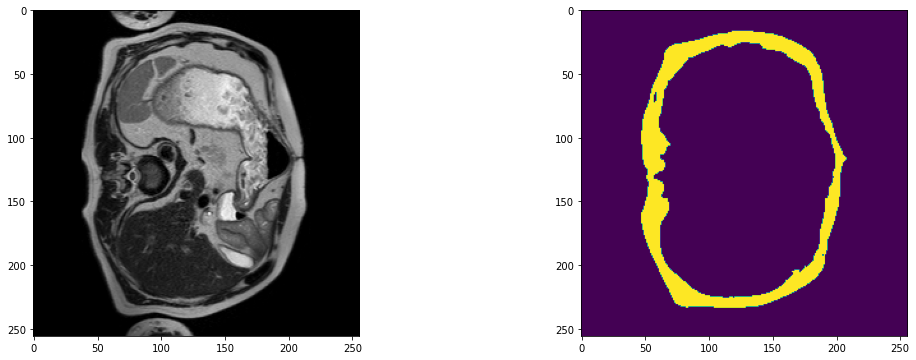

2023-09-14 17:57:55,246 INFO image_writer.py:194 - writing: outMR06_Sep23/A022_v7_T2W_seg.nii.gz


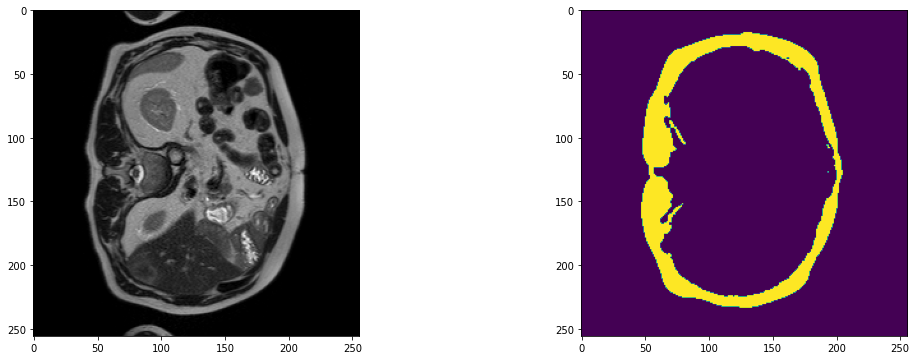

2023-09-14 17:58:08,019 INFO image_writer.py:194 - writing: outMR06_Sep23/A022_v8_T2W_seg.nii.gz


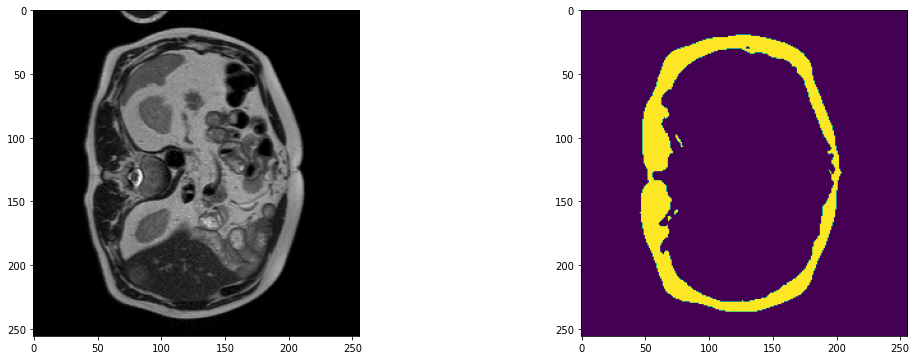

2023-09-14 17:58:20,827 INFO image_writer.py:194 - writing: outMR06_Sep23/A022_v9_T2W_seg.nii.gz


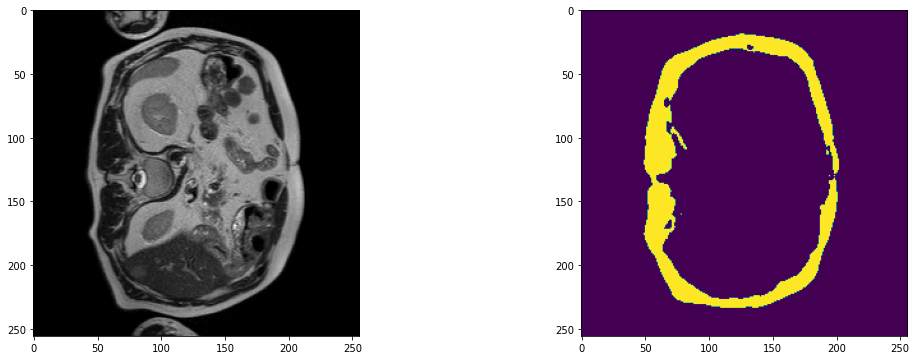

2023-09-14 17:58:26,799 INFO image_writer.py:194 - writing: outMR06_Sep23/A024_v1_T2W_seg.nii.gz


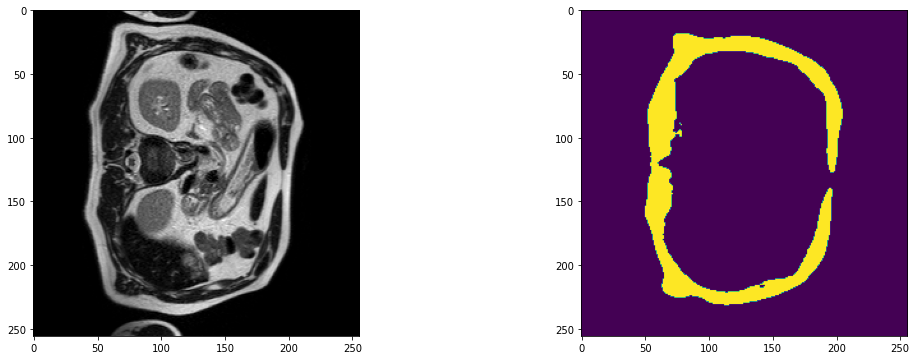

2023-09-14 17:58:32,598 INFO image_writer.py:194 - writing: outMR06_Sep23/A024_v2_T2W_seg.nii.gz


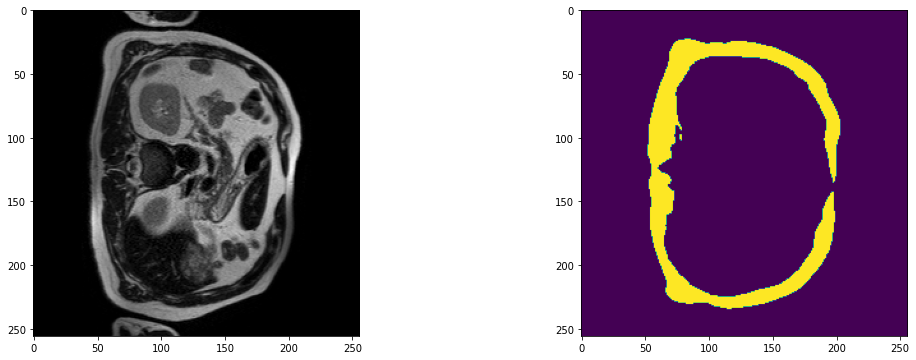

2023-09-14 17:58:38,408 INFO image_writer.py:194 - writing: outMR06_Sep23/A024_v3_T2W_seg.nii.gz


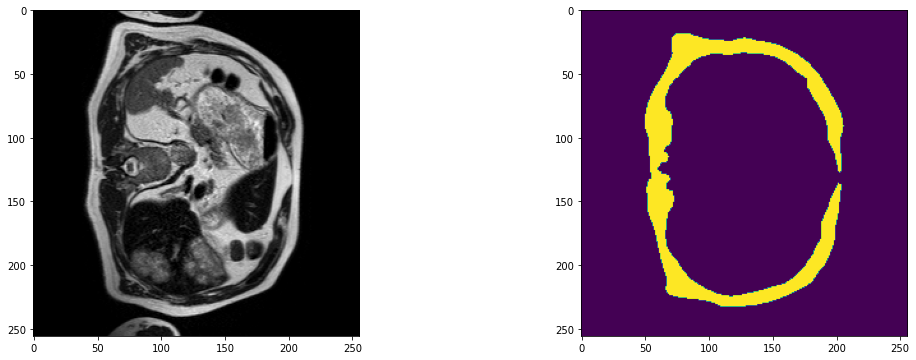

2023-09-14 17:58:44,216 INFO image_writer.py:194 - writing: outMR06_Sep23/A024_v4_T2W_seg.nii.gz


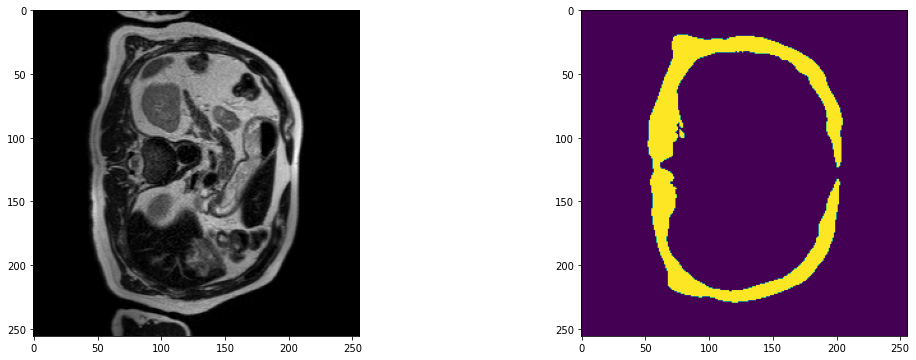

2023-09-14 17:58:50,023 INFO image_writer.py:194 - writing: outMR06_Sep23/A024_v5_T2W_seg.nii.gz


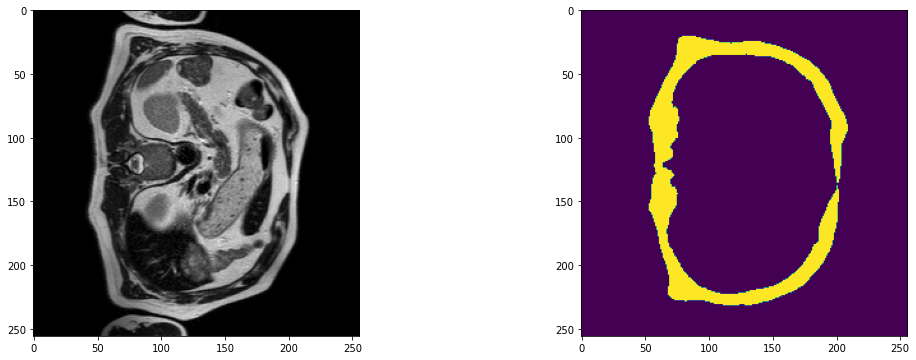

2023-09-14 17:58:55,826 INFO image_writer.py:194 - writing: outMR06_Sep23/A024_v6_T2W_seg.nii.gz


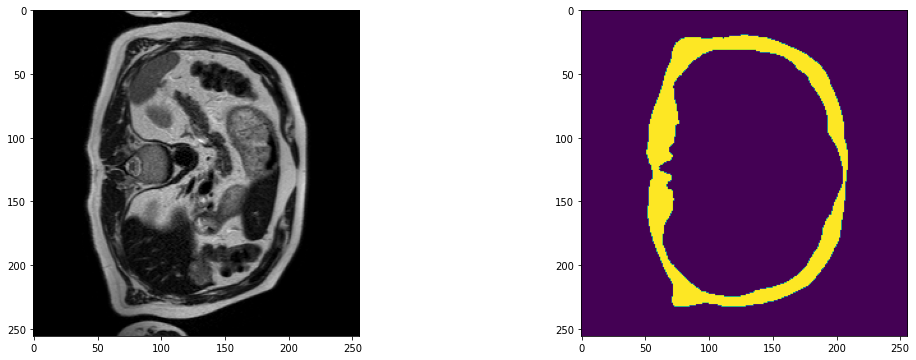

2023-09-14 17:59:01,595 INFO image_writer.py:194 - writing: outMR06_Sep23/A024_v7_T2W_seg.nii.gz


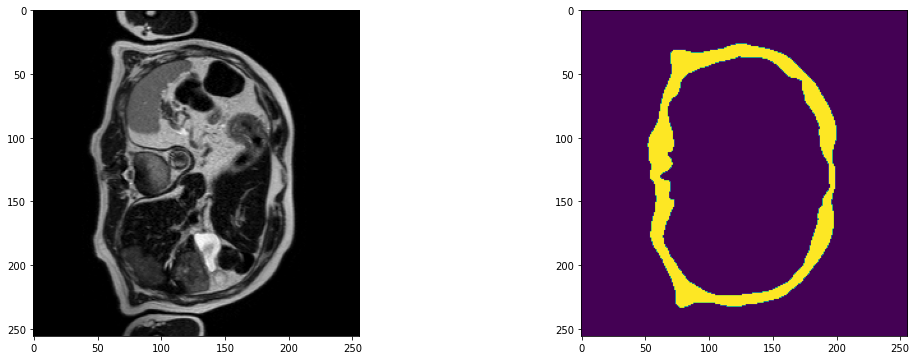

2023-09-14 17:59:07,414 INFO image_writer.py:194 - writing: outMR06_Sep23/A024_v8_T2W_seg.nii.gz


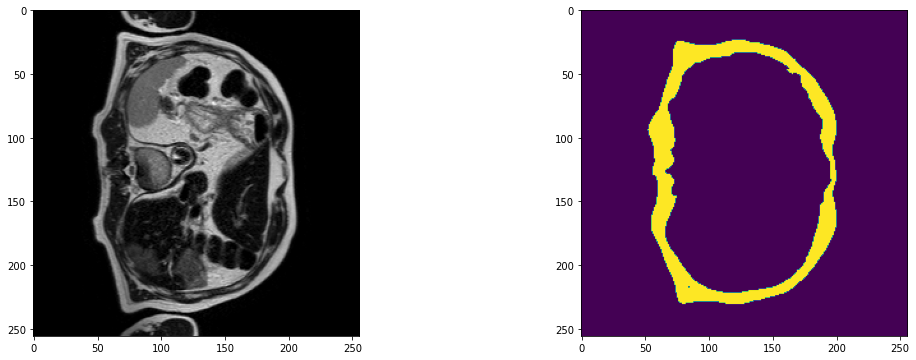

2023-09-14 17:59:13,210 INFO image_writer.py:194 - writing: outMR06_Sep23/A024_v9_T2W_seg.nii.gz


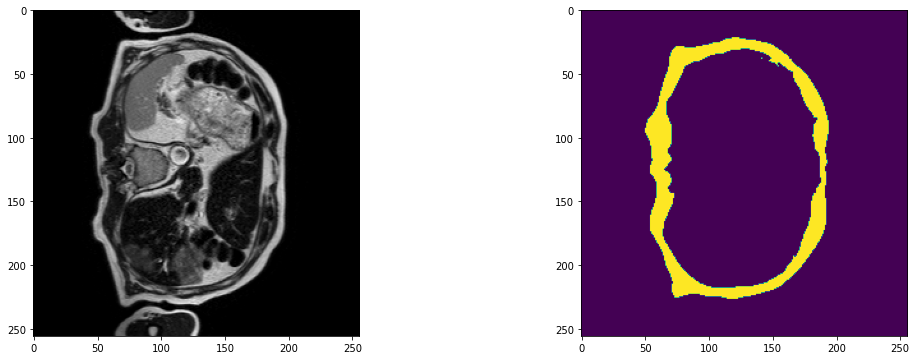

2023-09-14 17:59:25,985 INFO image_writer.py:194 - writing: outMR06_Sep23/A026_v1_T2W_seg.nii.gz


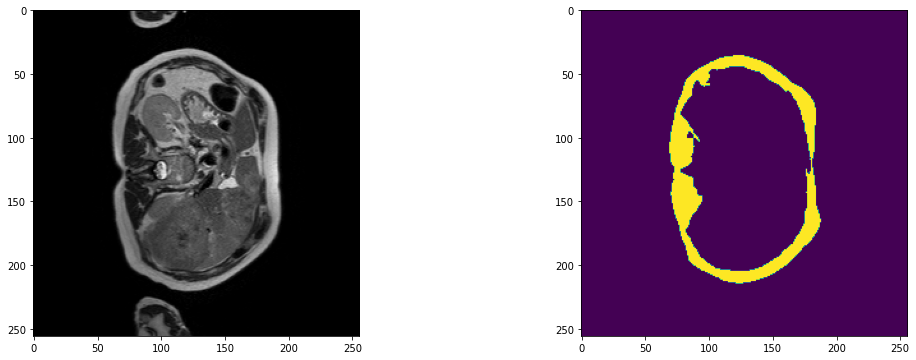

2023-09-14 17:59:38,761 INFO image_writer.py:194 - writing: outMR06_Sep23/A026_v2_T2W_seg.nii.gz


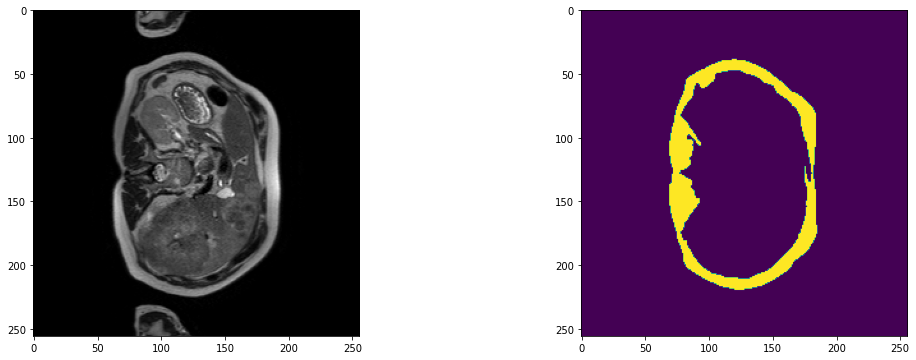

2023-09-14 17:59:51,528 INFO image_writer.py:194 - writing: outMR06_Sep23/A026_v3_T2W_seg.nii.gz


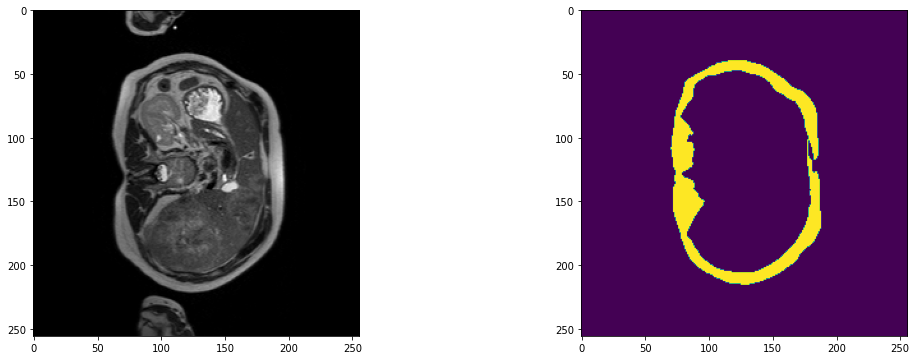

2023-09-14 18:00:04,247 INFO image_writer.py:194 - writing: outMR06_Sep23/A026_v4_T2W_seg.nii.gz


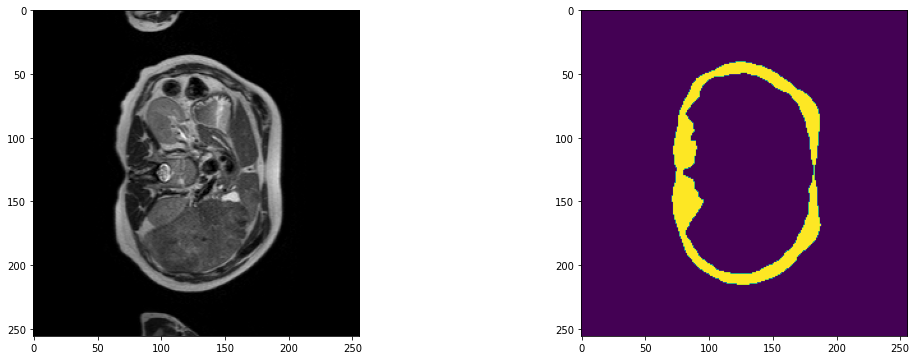

2023-09-14 18:00:17,141 INFO image_writer.py:194 - writing: outMR06_Sep23/A026_v5_T2W_seg.nii.gz


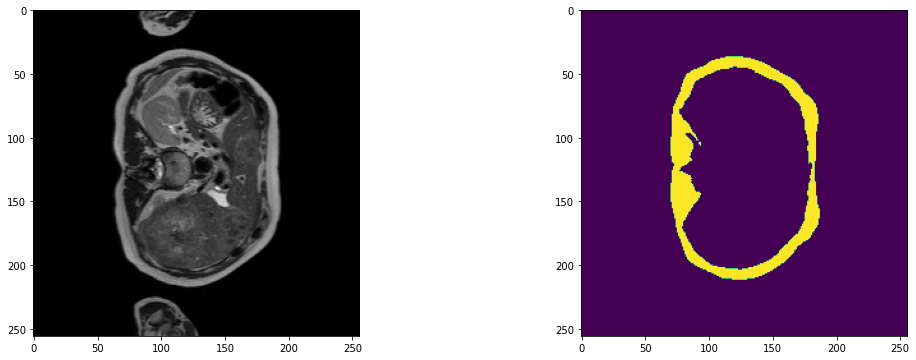

2023-09-14 18:00:22,919 INFO image_writer.py:194 - writing: outMR06_Sep23/A029_v1_T2W_seg.nii.gz


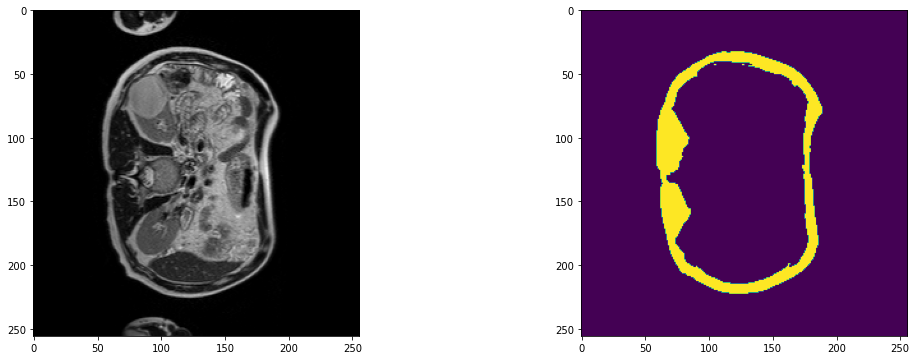

2023-09-14 18:00:27,865 INFO image_writer.py:194 - writing: outMR06_Sep23/A029_v2_T2W_seg.nii.gz


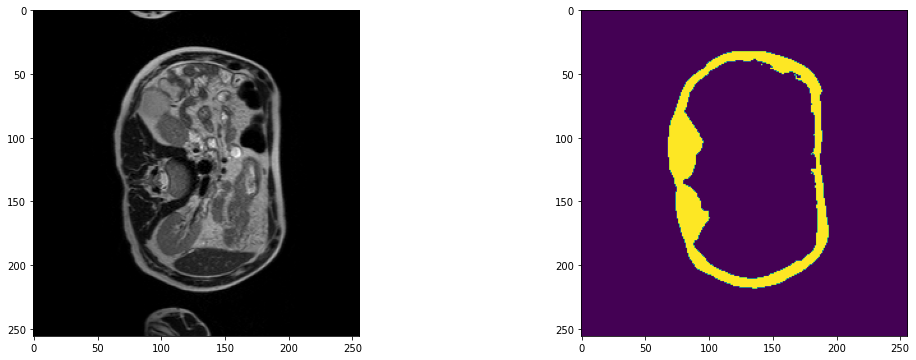

2023-09-14 18:00:33,642 INFO image_writer.py:194 - writing: outMR06_Sep23/A029_v3_T2W_seg.nii.gz


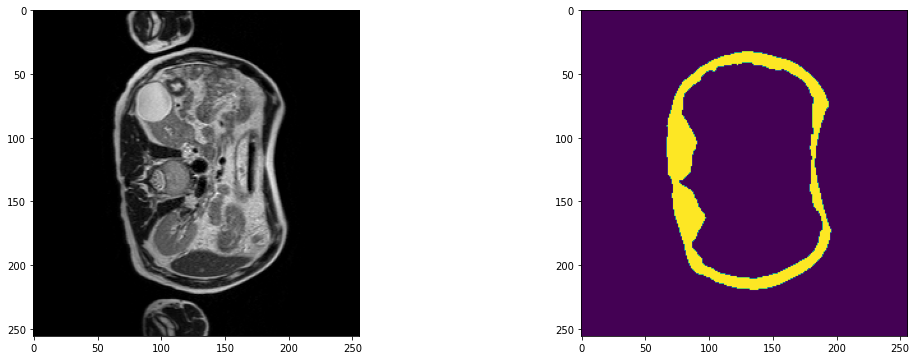

2023-09-14 18:00:38,561 INFO image_writer.py:194 - writing: outMR06_Sep23/A029_v4_T2W_seg.nii.gz


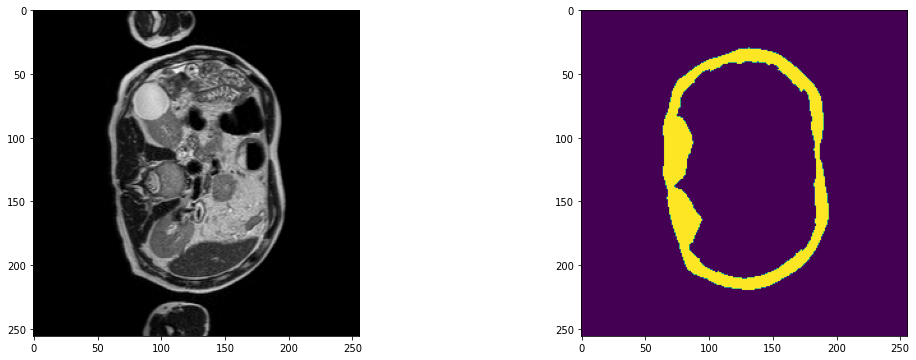

2023-09-14 18:00:43,571 INFO image_writer.py:194 - writing: outMR06_Sep23/A029_v5_T2W_seg.nii.gz


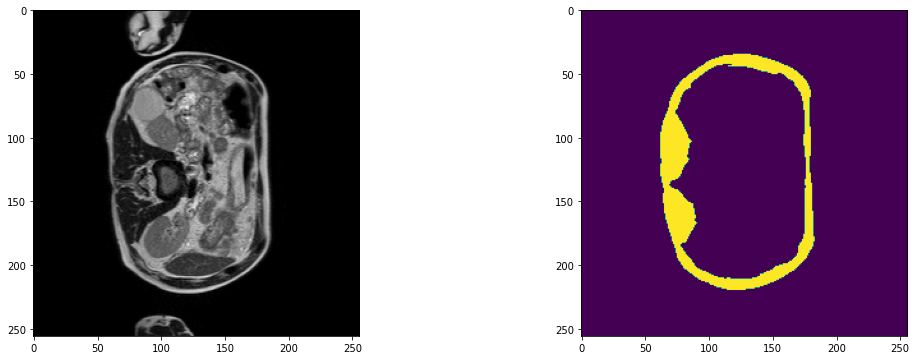

2023-09-14 18:00:49,369 INFO image_writer.py:194 - writing: outMR06_Sep23/A030_v1_T2W_seg.nii.gz


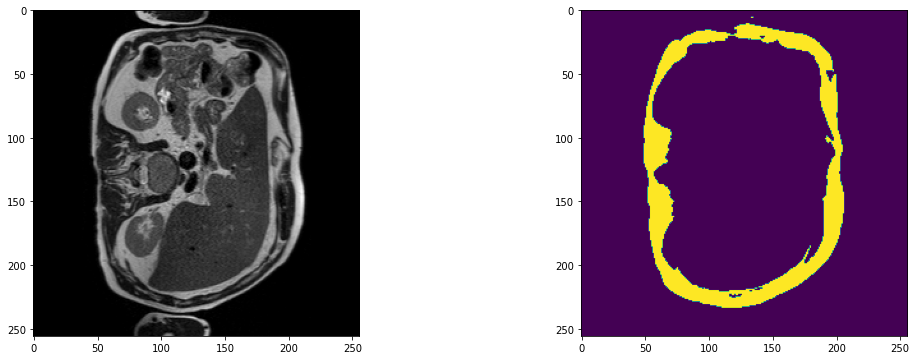

2023-09-14 18:00:55,147 INFO image_writer.py:194 - writing: outMR06_Sep23/A030_v2_T2W_seg.nii.gz


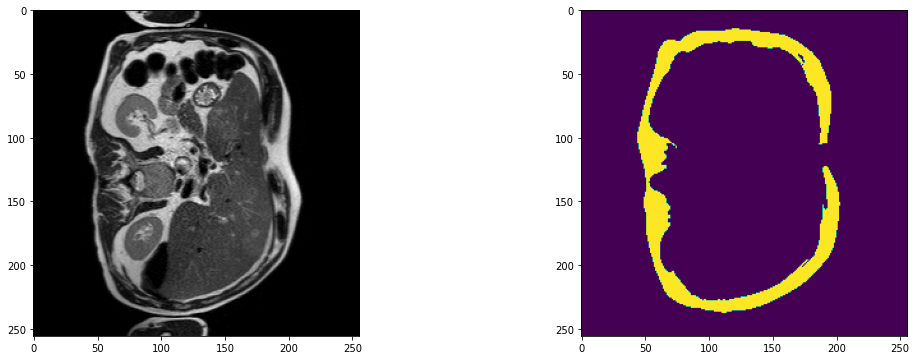

2023-09-14 18:01:00,920 INFO image_writer.py:194 - writing: outMR06_Sep23/A030_v3_T2W_seg.nii.gz


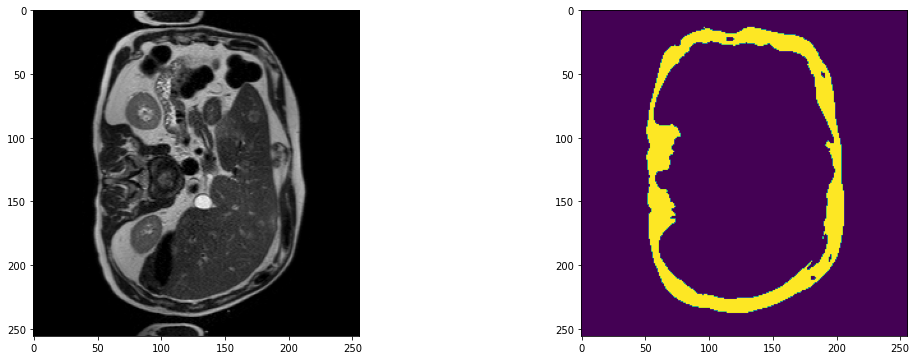

2023-09-14 18:01:06,714 INFO image_writer.py:194 - writing: outMR06_Sep23/A030_v4_T2W_seg.nii.gz


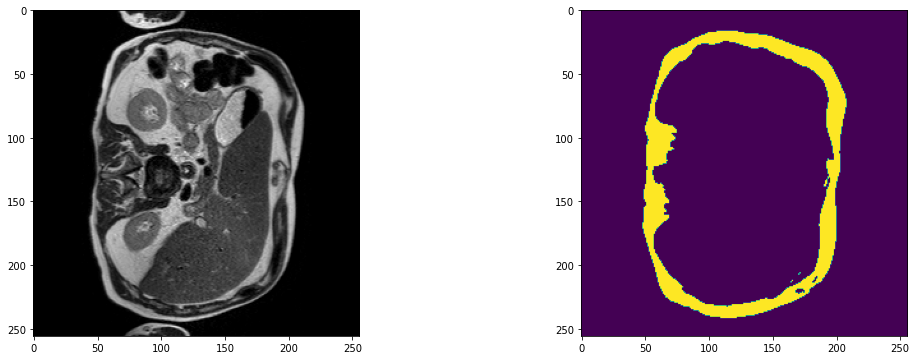

2023-09-14 18:01:12,503 INFO image_writer.py:194 - writing: outMR06_Sep23/A030_v5_T2W_seg.nii.gz


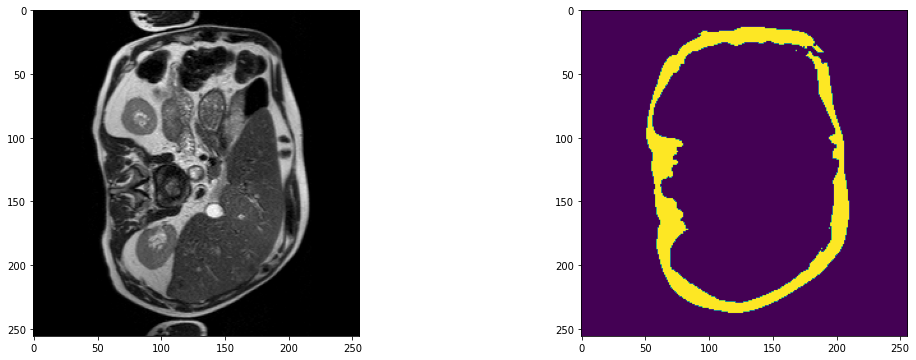

2023-09-14 18:01:18,303 INFO image_writer.py:194 - writing: outMR06_Sep23/A030_v6_T2W_seg.nii.gz


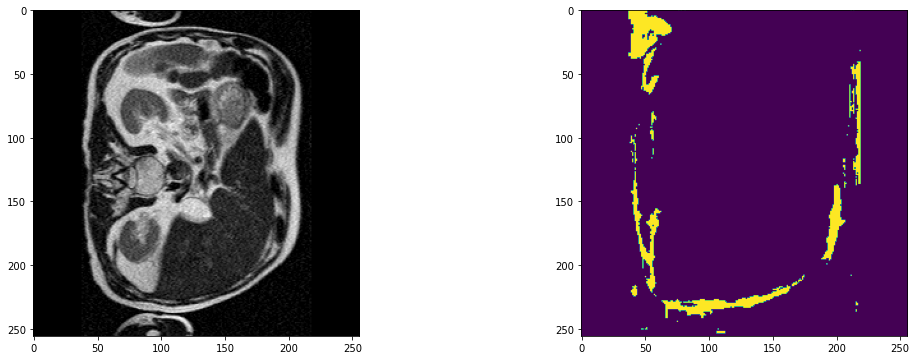

2023-09-14 18:01:24,242 INFO image_writer.py:194 - writing: outMR06_Sep23/A030_v7_T2W_seg.nii.gz


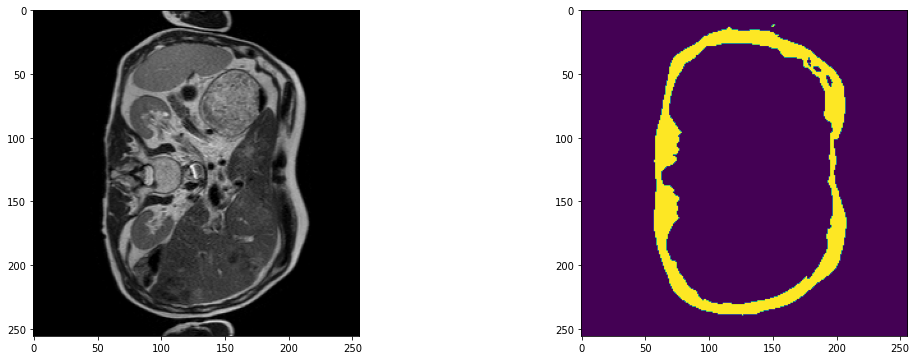

2023-09-14 18:01:29,174 INFO image_writer.py:194 - writing: outMR06_Sep23/A031_v1_T2W_seg.nii.gz


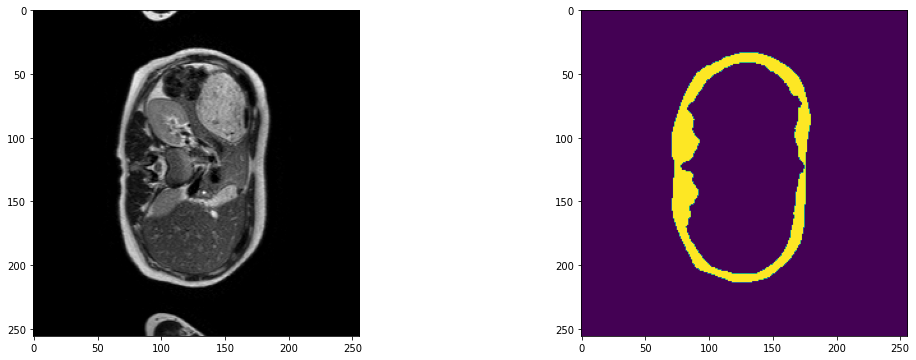

2023-09-14 18:01:34,100 INFO image_writer.py:194 - writing: outMR06_Sep23/A031_v2_T2W_seg.nii.gz


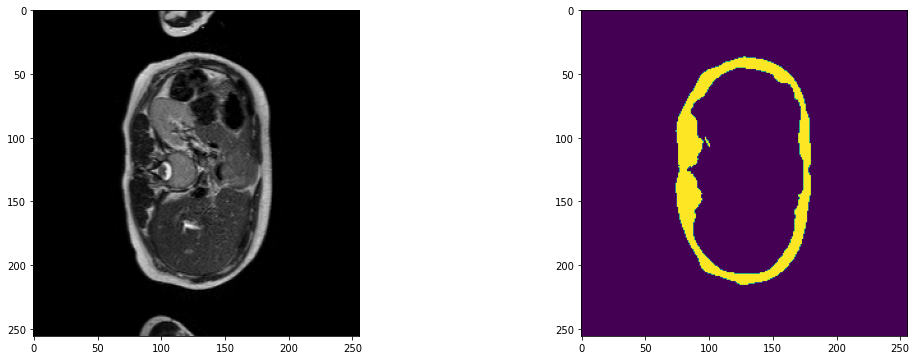

2023-09-14 18:01:39,056 INFO image_writer.py:194 - writing: outMR06_Sep23/A031_v3_T2W_seg.nii.gz


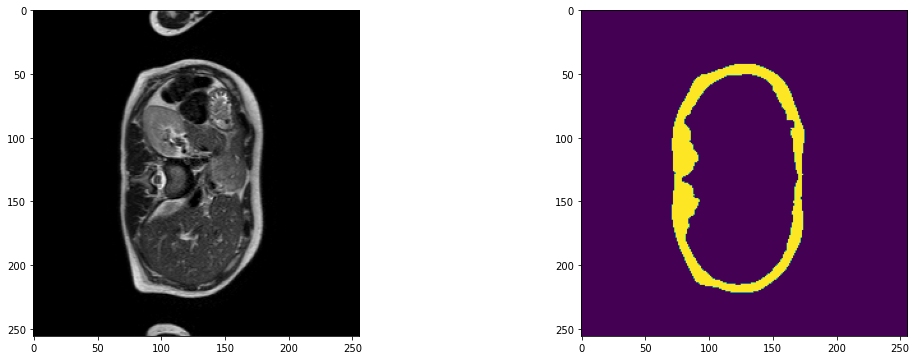

2023-09-14 18:01:43,984 INFO image_writer.py:194 - writing: outMR06_Sep23/A031_v4_T2W_seg.nii.gz


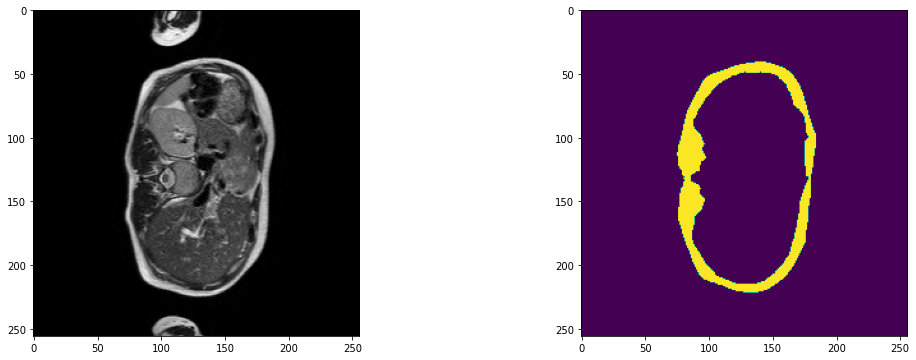

2023-09-14 18:01:48,897 INFO image_writer.py:194 - writing: outMR06_Sep23/A031_v5_T2W_seg.nii.gz


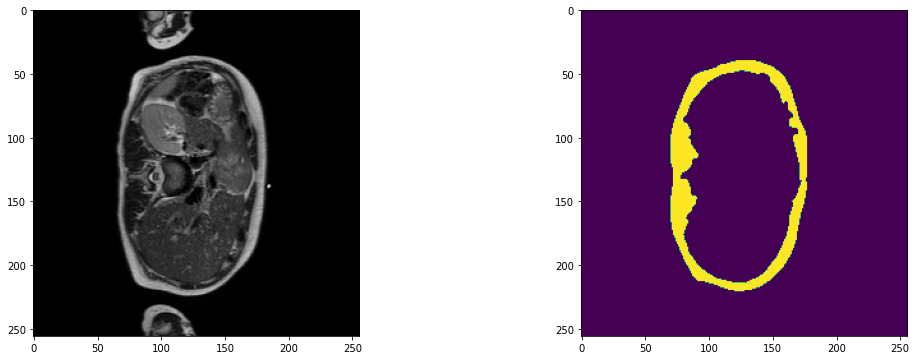

2023-09-14 18:01:53,805 INFO image_writer.py:194 - writing: outMR06_Sep23/A031_v6_T2W_seg.nii.gz


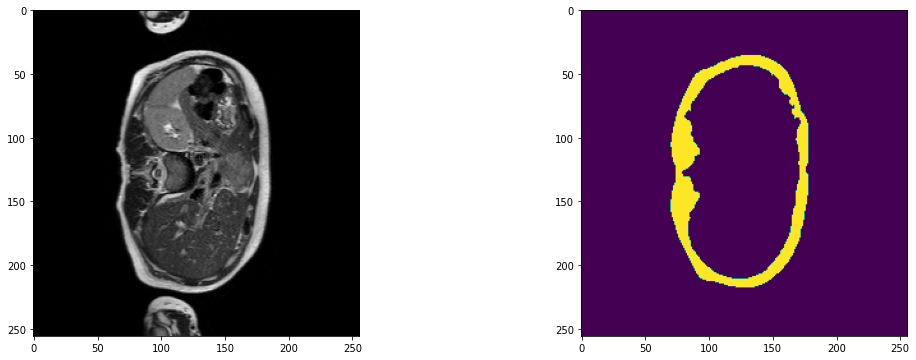

2023-09-14 18:02:06,508 INFO image_writer.py:194 - writing: outMR06_Sep23/A032_v1_T2W_seg.nii.gz


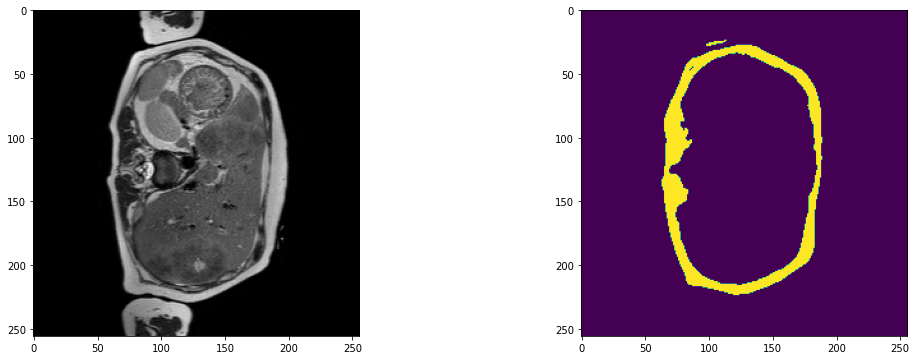

2023-09-14 18:02:19,231 INFO image_writer.py:194 - writing: outMR06_Sep23/A032_v2_T2W_seg.nii.gz


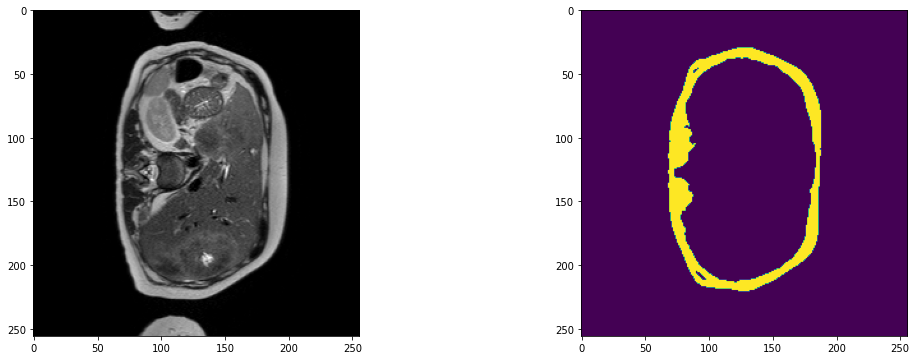

2023-09-14 18:02:31,952 INFO image_writer.py:194 - writing: outMR06_Sep23/A032_v3_T2W_seg.nii.gz


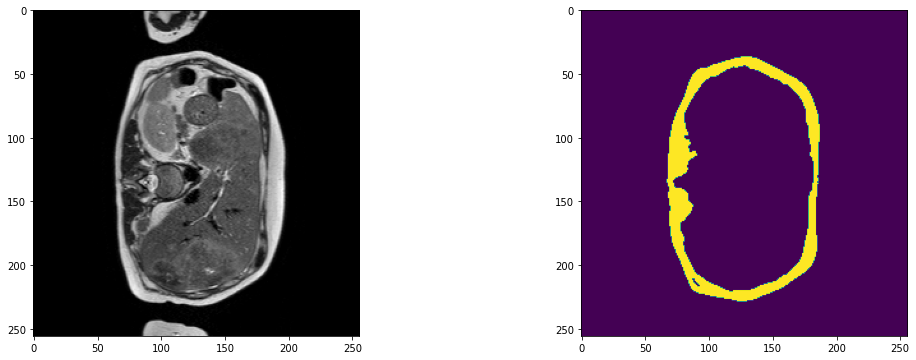

2023-09-14 18:02:44,719 INFO image_writer.py:194 - writing: outMR06_Sep23/A032_v4_T2W_seg.nii.gz


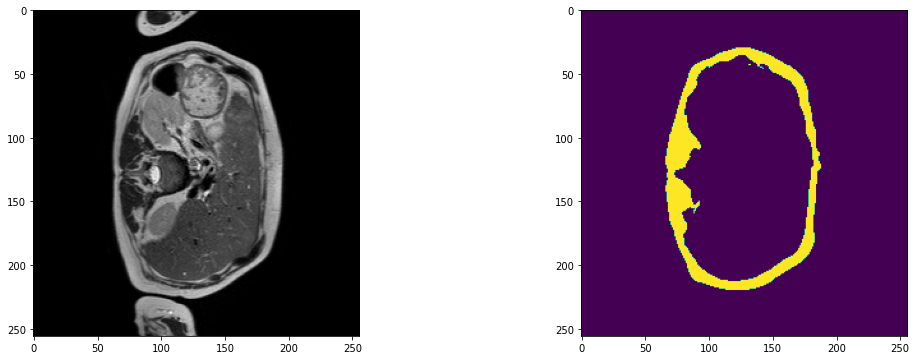

2023-09-14 18:02:57,443 INFO image_writer.py:194 - writing: outMR06_Sep23/A032_v5_T2W_seg.nii.gz


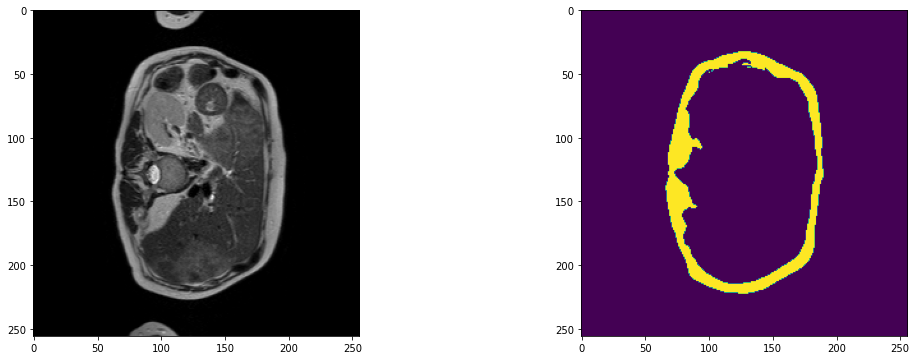

2023-09-14 18:03:08,172 INFO image_writer.py:194 - writing: outMR06_Sep23/A032_v6_T2W_seg.nii.gz


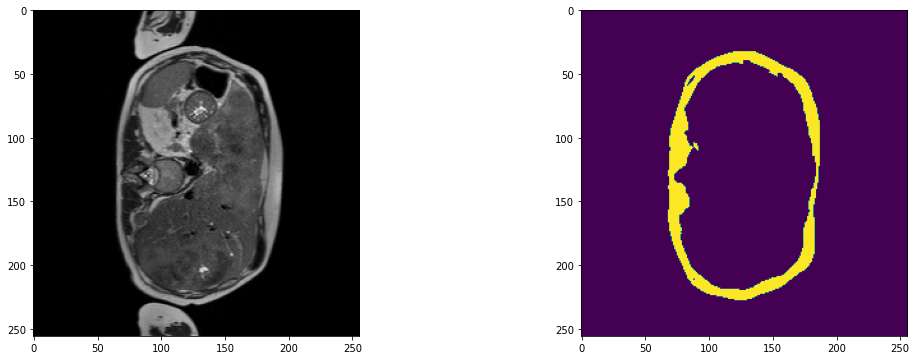

2023-09-14 18:03:18,924 INFO image_writer.py:194 - writing: outMR06_Sep23/A032_v7_T2W_seg.nii.gz


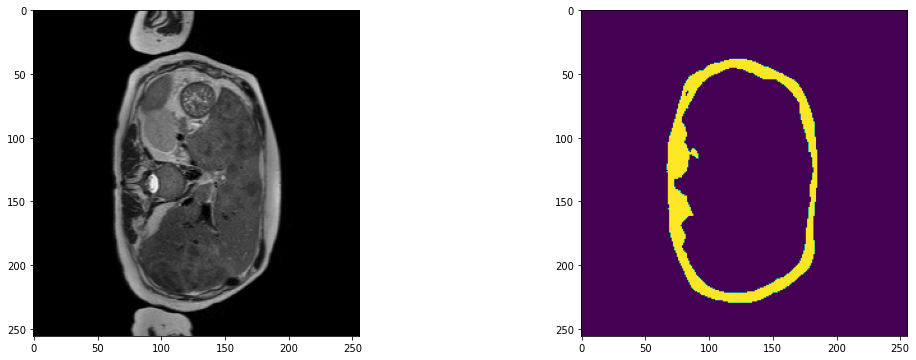

2023-09-14 18:03:29,796 INFO image_writer.py:194 - writing: outMR06_Sep23/A032_v8_T2W_seg.nii.gz


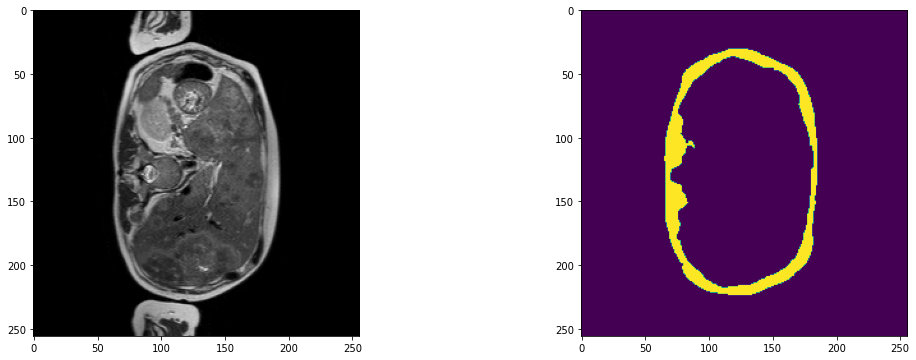

2023-09-14 18:03:42,544 INFO image_writer.py:194 - writing: outMR06_Sep23/A032_v9_T2W_seg.nii.gz


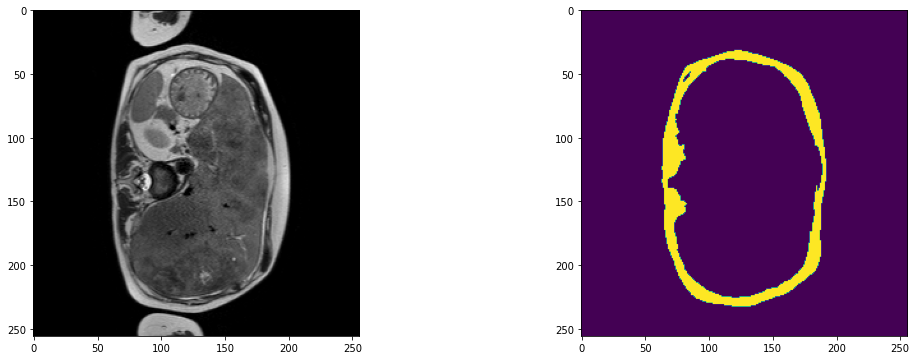

2023-09-14 18:03:55,274 INFO image_writer.py:194 - writing: outMR06_Sep23/A033_v1_T2W_seg.nii.gz


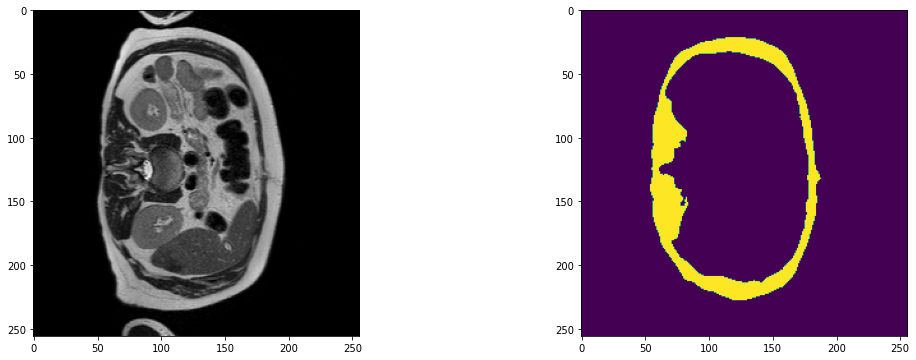

2023-09-14 18:04:08,018 INFO image_writer.py:194 - writing: outMR06_Sep23/A033_v2_T2W_seg.nii.gz


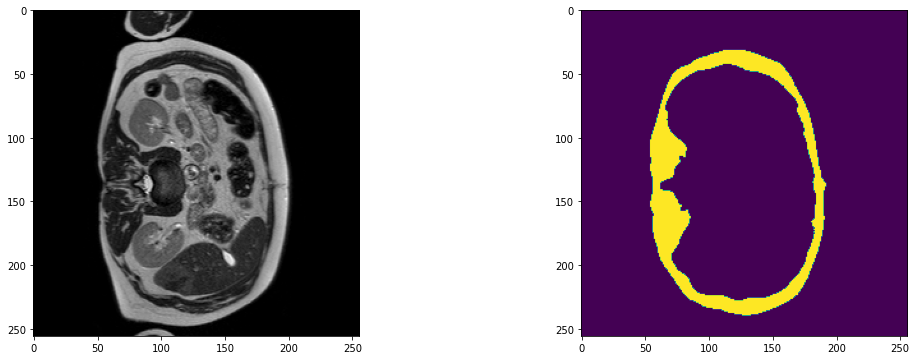

2023-09-14 18:04:20,740 INFO image_writer.py:194 - writing: outMR06_Sep23/A033_v3_T2W_seg.nii.gz


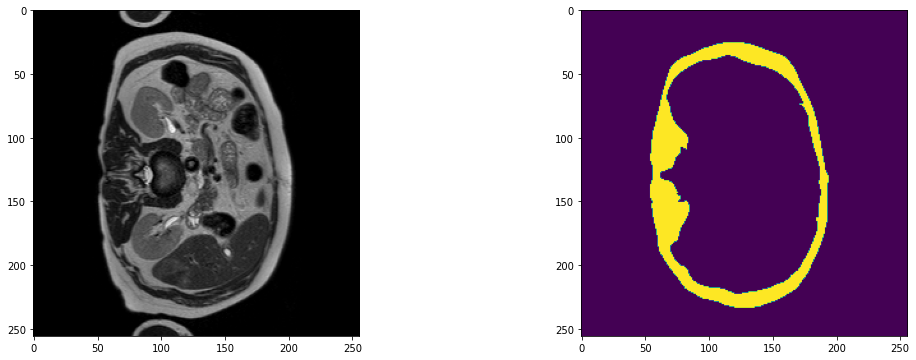

2023-09-14 18:04:33,492 INFO image_writer.py:194 - writing: outMR06_Sep23/A033_v4_T2W_seg.nii.gz


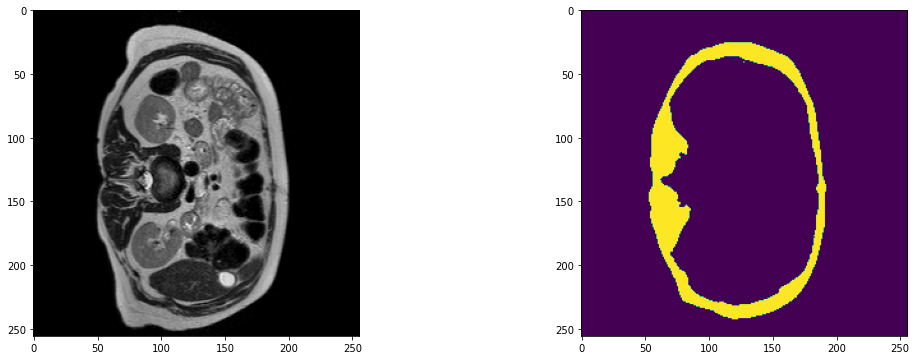

2023-09-14 18:04:46,243 INFO image_writer.py:194 - writing: outMR06_Sep23/A033_v5_T2W_seg.nii.gz


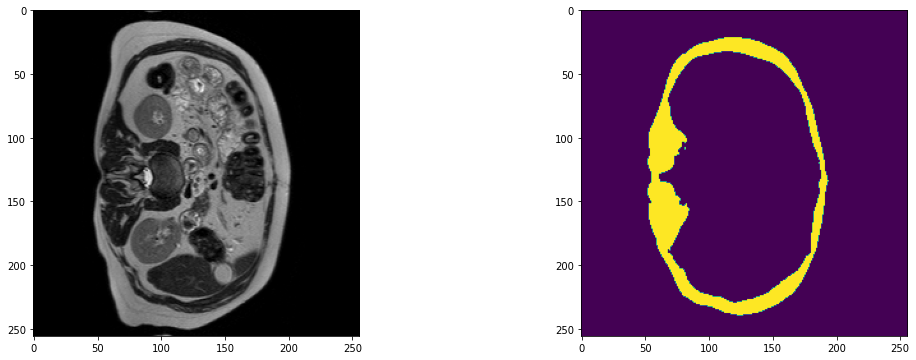

2023-09-14 18:04:59,003 INFO image_writer.py:194 - writing: outMR06_Sep23/A034_v1_T2W_seg.nii.gz


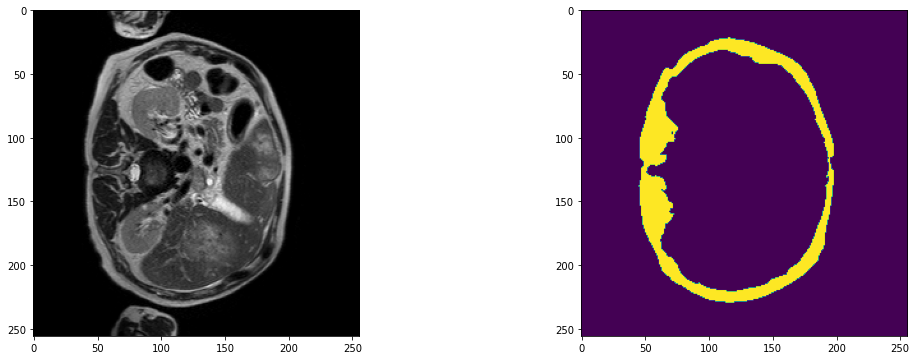

2023-09-14 18:05:11,750 INFO image_writer.py:194 - writing: outMR06_Sep23/A034_v2_T2W_seg.nii.gz


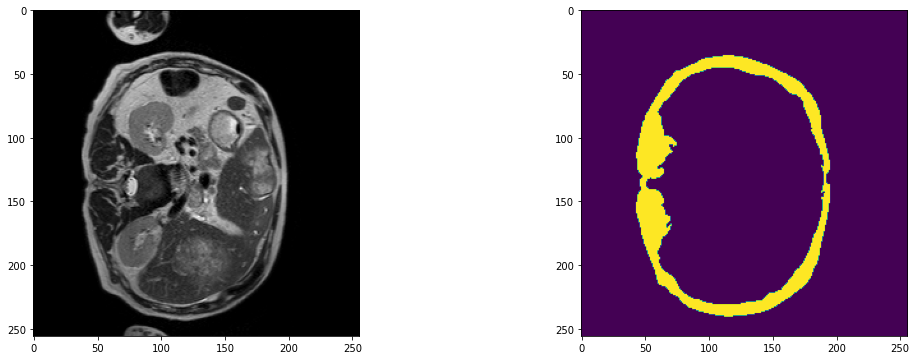

2023-09-14 18:05:24,484 INFO image_writer.py:194 - writing: outMR06_Sep23/A034_v3_T2W_seg.nii.gz


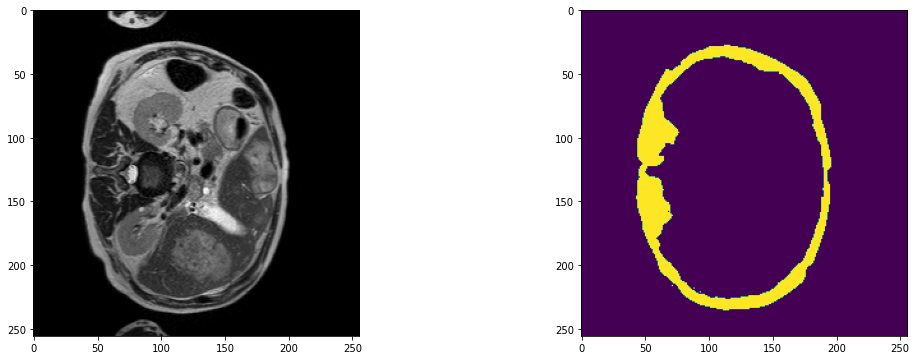

2023-09-14 18:05:37,237 INFO image_writer.py:194 - writing: outMR06_Sep23/A034_v4_T2W_seg.nii.gz


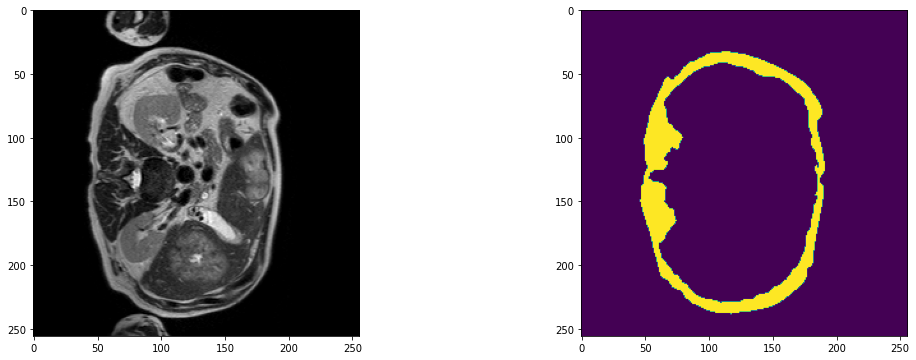

2023-09-14 18:05:50,011 INFO image_writer.py:194 - writing: outMR06_Sep23/A034_v5_T2W_seg.nii.gz


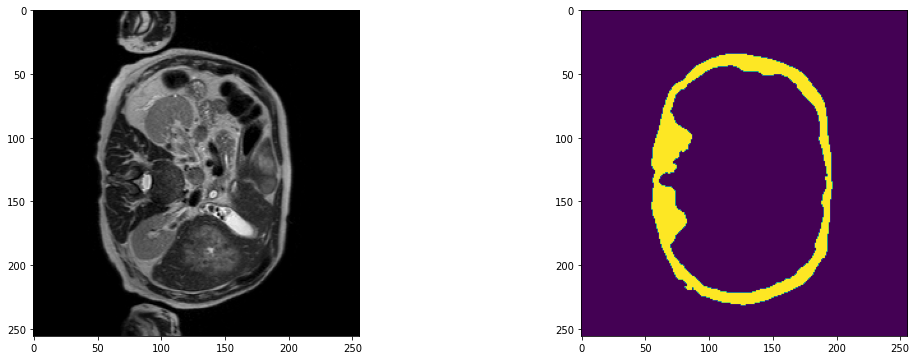

2023-09-14 18:06:02,899 INFO image_writer.py:194 - writing: outMR06_Sep23/A034_v6_T2W_seg.nii.gz


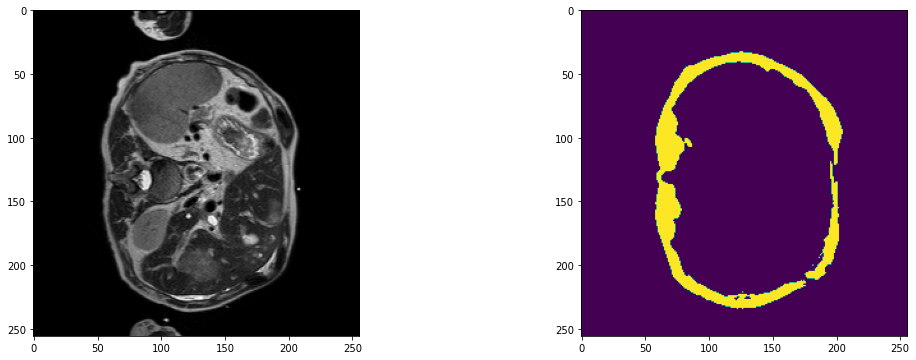

2023-09-14 18:06:15,640 INFO image_writer.py:194 - writing: outMR06_Sep23/A034_v7_T2W_seg.nii.gz


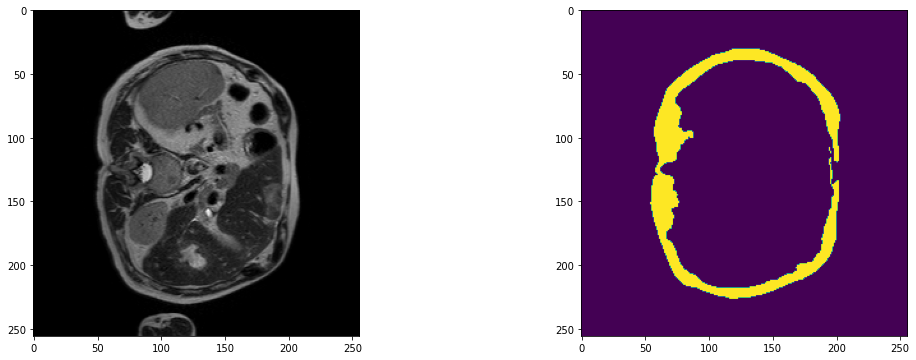

2023-09-14 18:06:28,355 INFO image_writer.py:194 - writing: outMR06_Sep23/A034_v8_T2W_seg.nii.gz


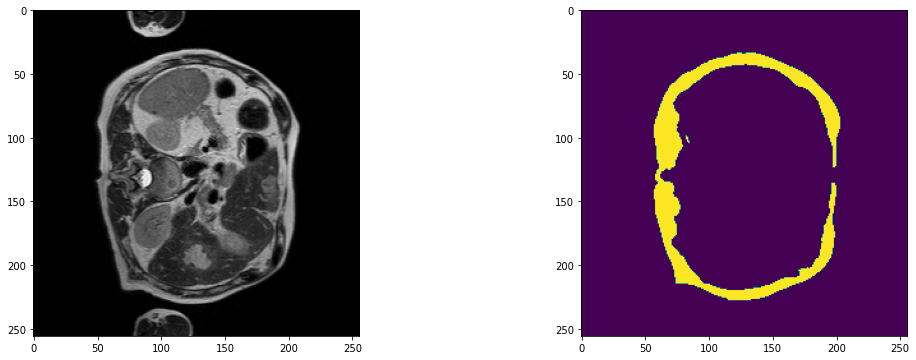

2023-09-14 18:06:41,089 INFO image_writer.py:194 - writing: outMR06_Sep23/A034_v9_T2W_seg.nii.gz


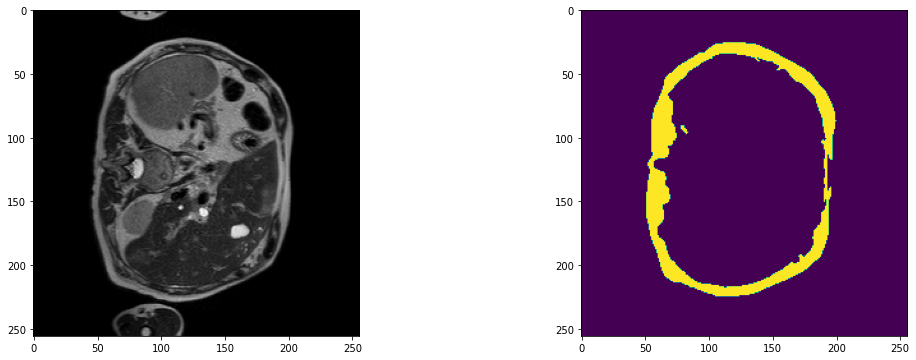

2023-09-14 18:06:51,803 INFO image_writer.py:194 - writing: outMR06_Sep23/A037_v1_T2W_seg.nii.gz


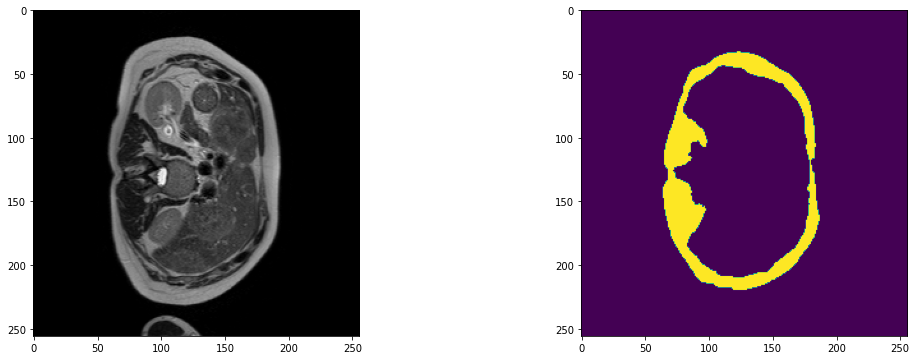

2023-09-14 18:07:04,541 INFO image_writer.py:194 - writing: outMR06_Sep23/A037_v2_T2W_seg.nii.gz


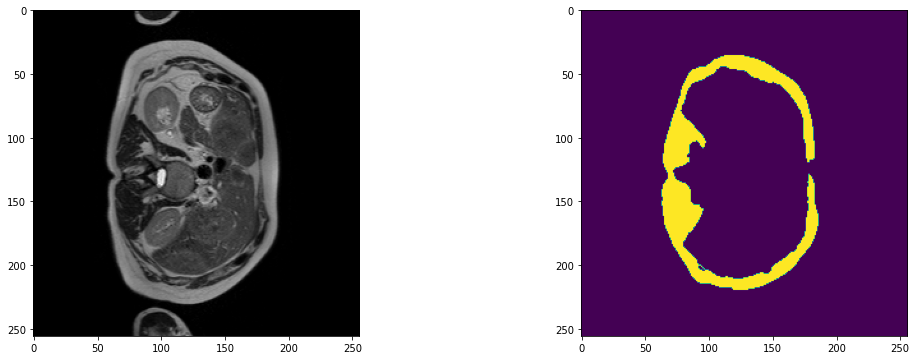

2023-09-14 18:07:17,235 INFO image_writer.py:194 - writing: outMR06_Sep23/A037_v3_T2W_seg.nii.gz


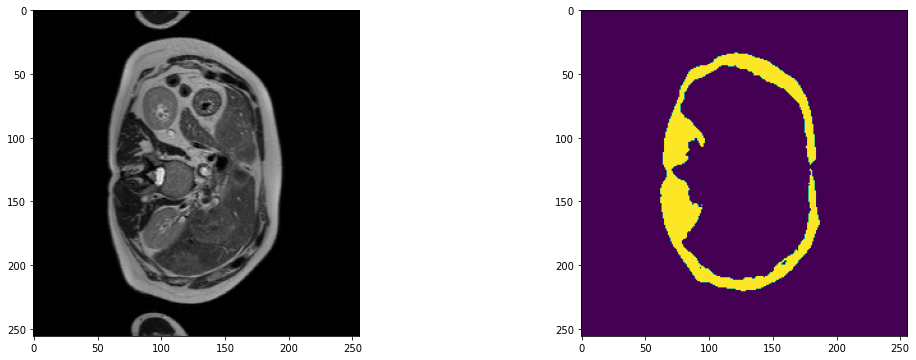

2023-09-14 18:07:27,930 INFO image_writer.py:194 - writing: outMR06_Sep23/A037_v6_T2W_seg.nii.gz


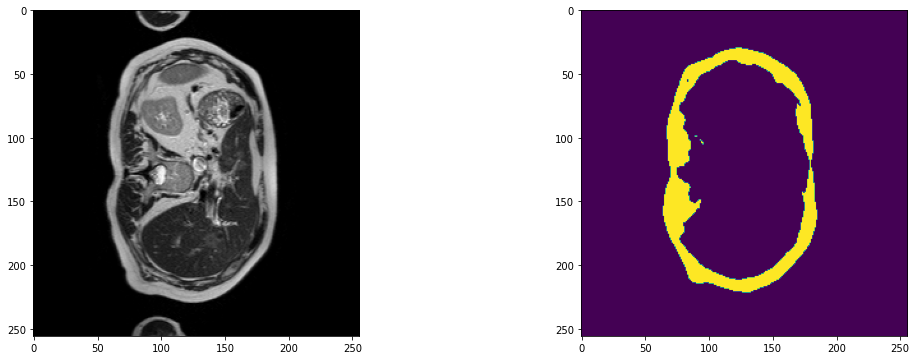

2023-09-14 18:07:38,633 INFO image_writer.py:194 - writing: outMR06_Sep23/A037_v7_T2W_seg.nii.gz


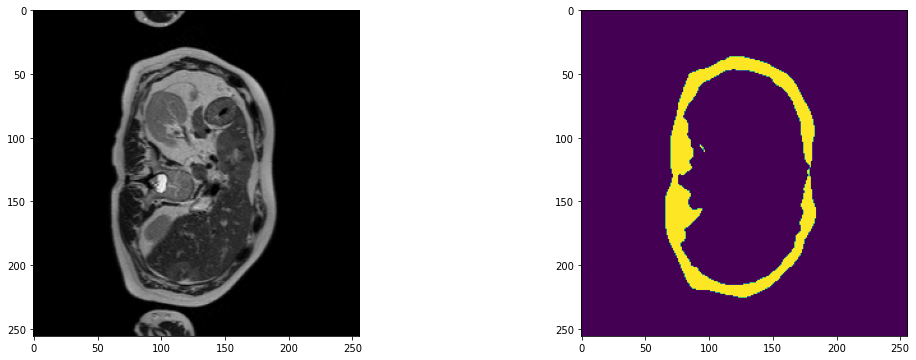

2023-09-14 18:07:44,431 INFO image_writer.py:194 - writing: outMR06_Sep23/A038_v1_T2W_seg.nii.gz


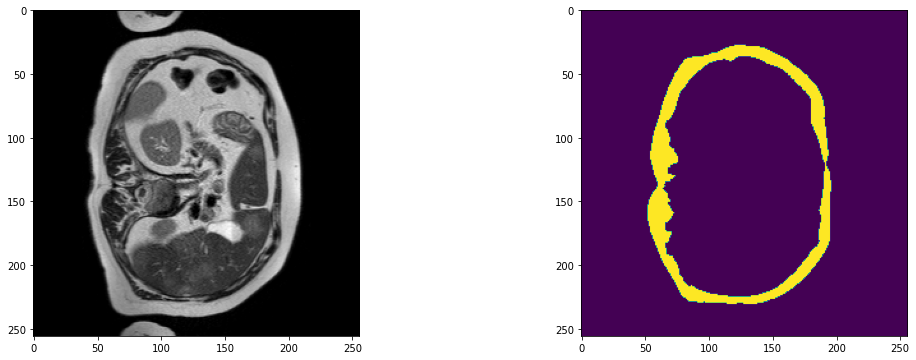

2023-09-14 18:07:50,210 INFO image_writer.py:194 - writing: outMR06_Sep23/A038_v2_T2W_seg.nii.gz


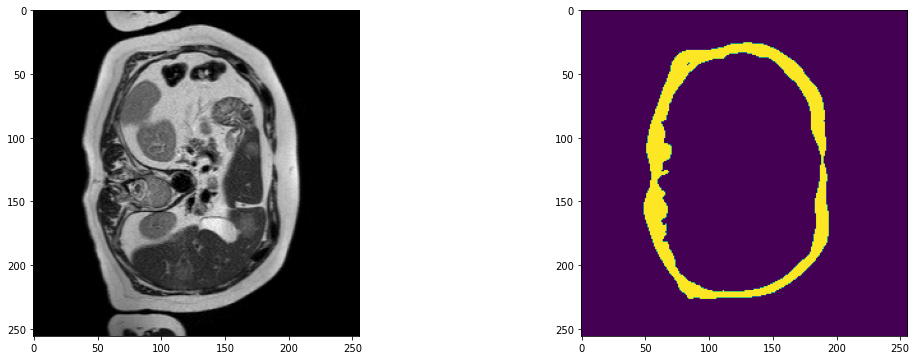

2023-09-14 18:07:55,996 INFO image_writer.py:194 - writing: outMR06_Sep23/A038_v3_T2W_seg.nii.gz


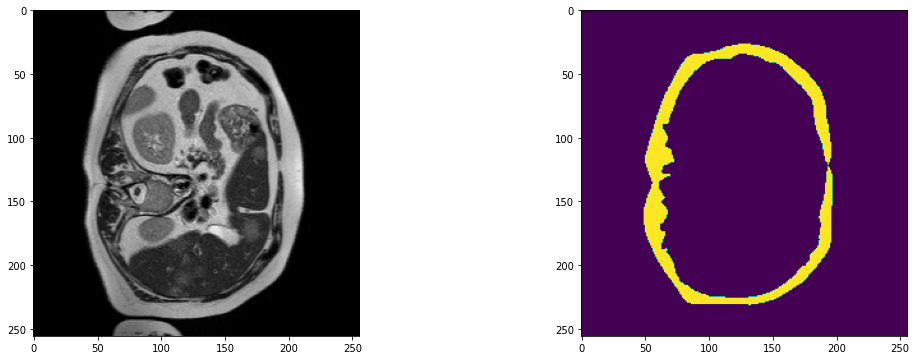

2023-09-14 18:08:01,785 INFO image_writer.py:194 - writing: outMR06_Sep23/A038_v4_T2W_seg.nii.gz


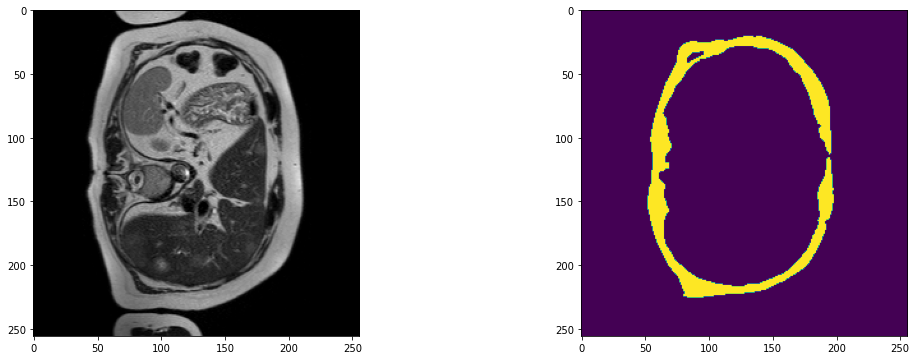

2023-09-14 18:08:07,719 INFO image_writer.py:194 - writing: outMR06_Sep23/A038_v5_T2W_seg.nii.gz


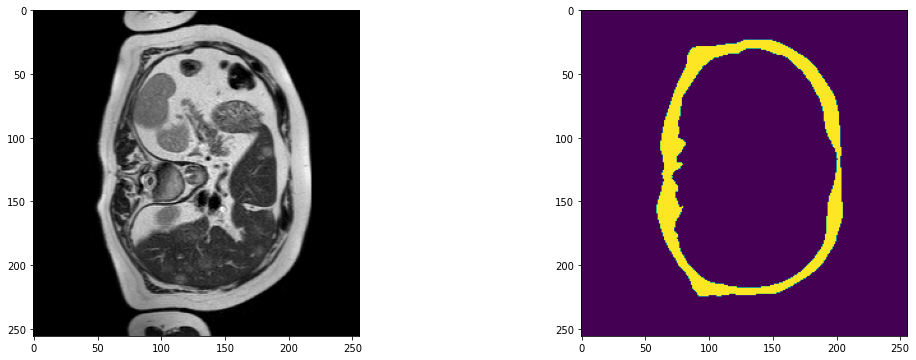

2023-09-14 18:08:13,497 INFO image_writer.py:194 - writing: outMR06_Sep23/A038_v6_T2W_seg.nii.gz


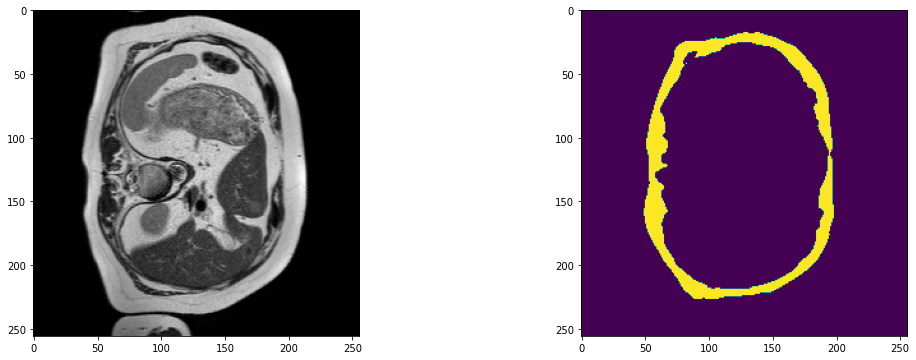

2023-09-14 18:08:19,280 INFO image_writer.py:194 - writing: outMR06_Sep23/A038_v7_T2W_seg.nii.gz


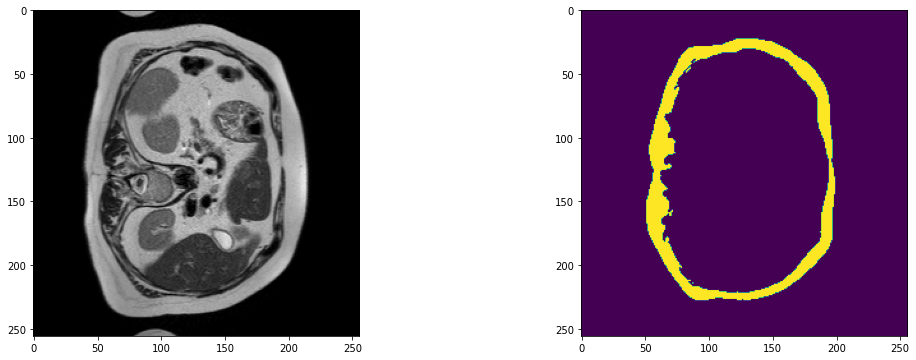

2023-09-14 18:08:25,046 INFO image_writer.py:194 - writing: outMR06_Sep23/A038_v8_T2W_seg.nii.gz


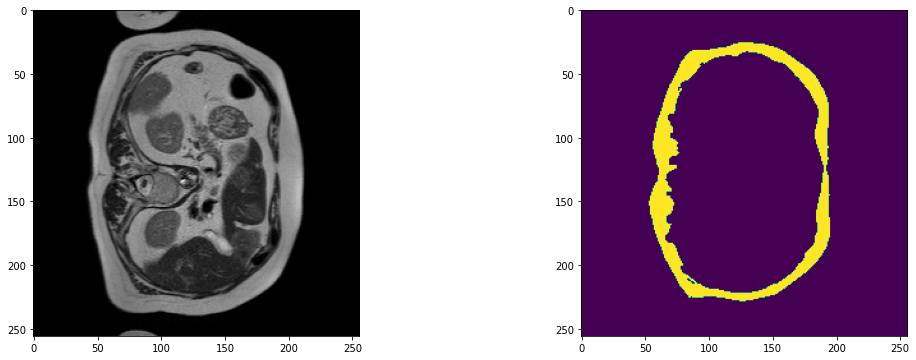

2023-09-14 18:08:30,818 INFO image_writer.py:194 - writing: outMR06_Sep23/A038_v9_T2W_seg.nii.gz


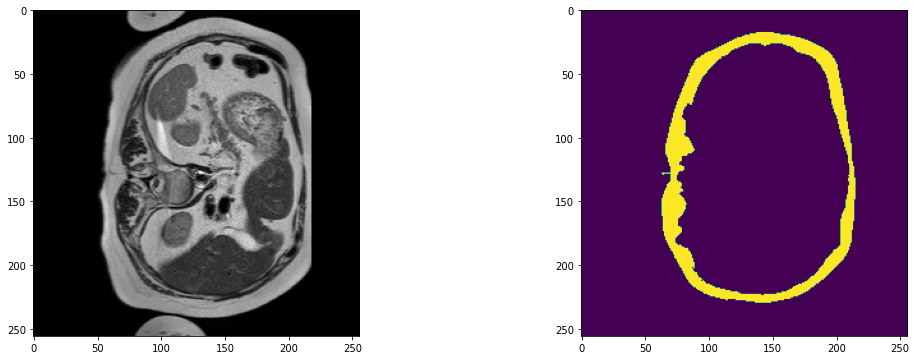

2023-09-14 18:08:35,752 INFO image_writer.py:194 - writing: outMR06_Sep23/A039_v1_T2W_seg.nii.gz


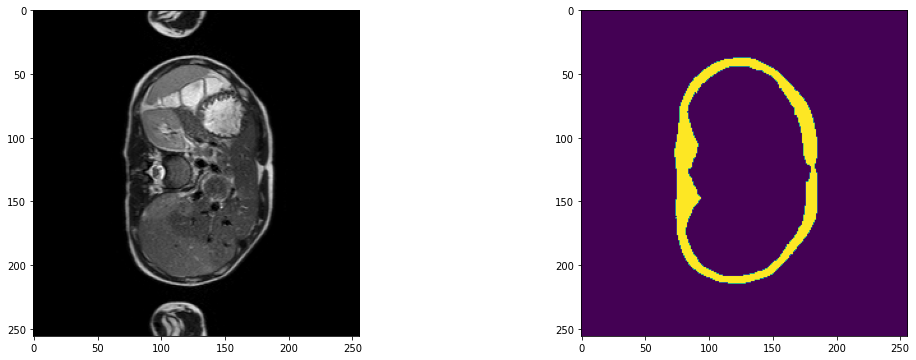

2023-09-14 18:08:39,838 INFO image_writer.py:194 - writing: outMR06_Sep23/A039_v2_T2W_seg.nii.gz


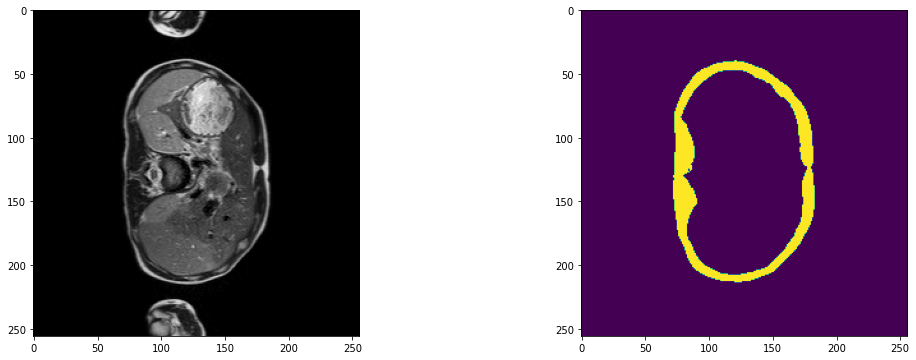

2023-09-14 18:08:43,899 INFO image_writer.py:194 - writing: outMR06_Sep23/A039_v3_T2W_seg.nii.gz


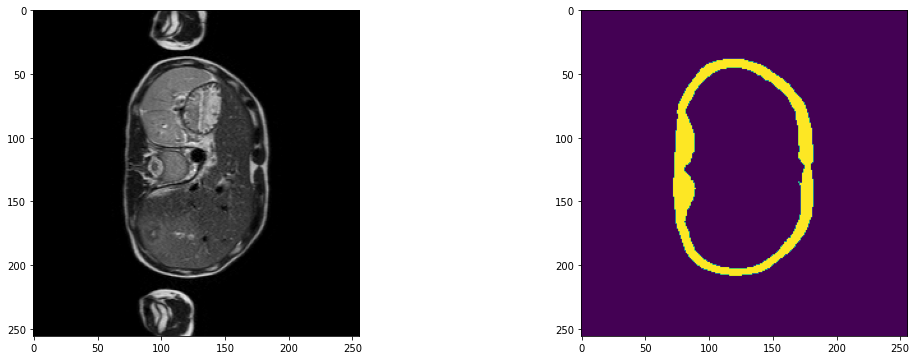

2023-09-14 18:08:47,955 INFO image_writer.py:194 - writing: outMR06_Sep23/A039_v4_T2W_seg.nii.gz


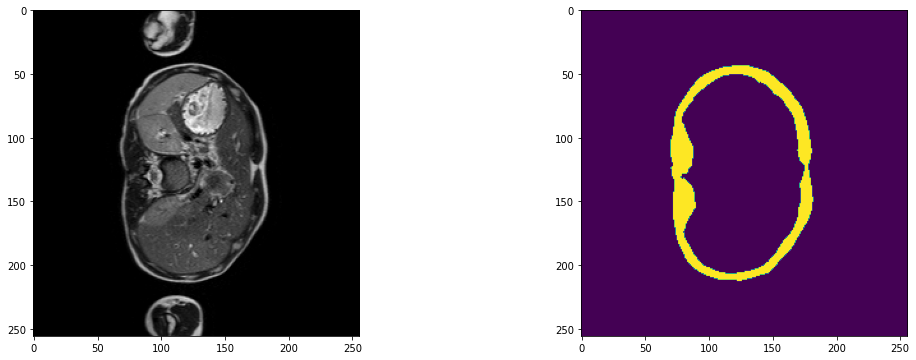

2023-09-14 18:08:52,072 INFO image_writer.py:194 - writing: outMR06_Sep23/A039_v5_T2W_seg.nii.gz


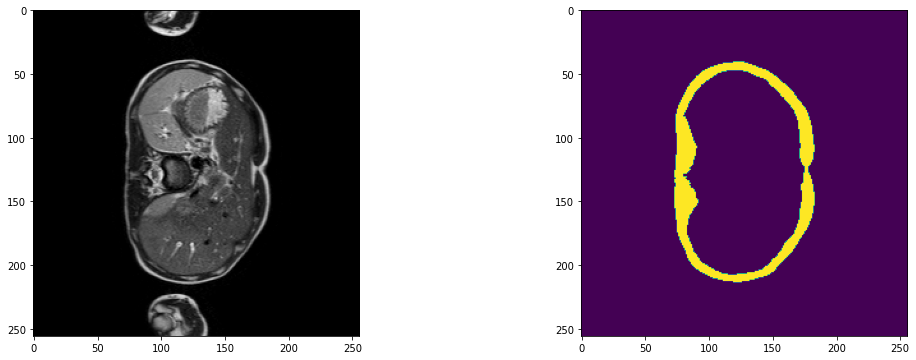

2023-09-14 18:08:56,981 INFO image_writer.py:194 - writing: outMR06_Sep23/A039_v6_T2W_seg.nii.gz


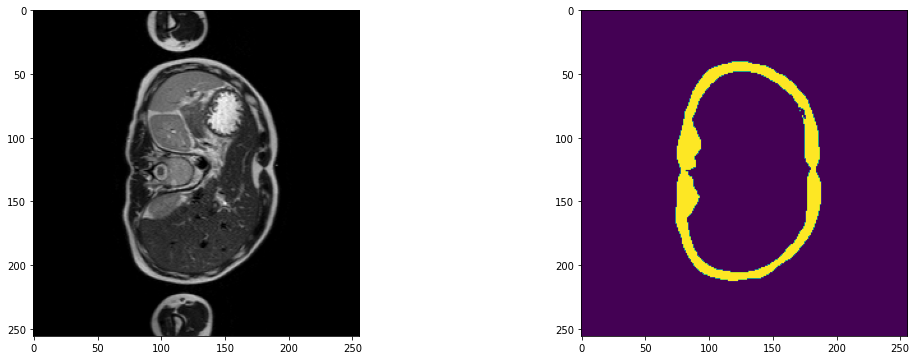

2023-09-14 18:09:01,041 INFO image_writer.py:194 - writing: outMR06_Sep23/A039_v7_T2W_seg.nii.gz


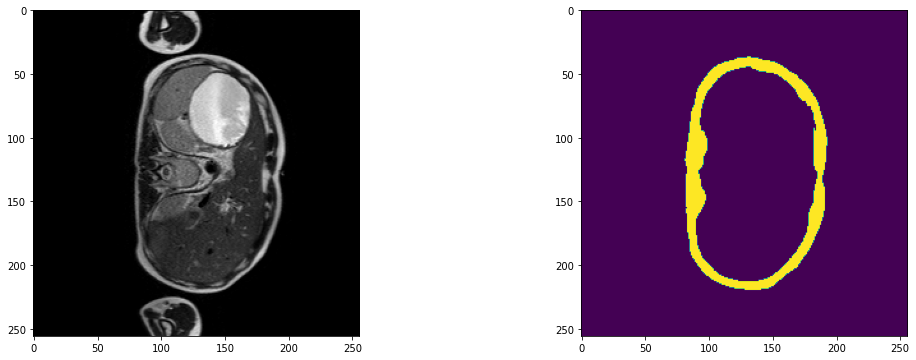

2023-09-14 18:09:05,956 INFO image_writer.py:194 - writing: outMR06_Sep23/A039_v9_T2W_seg.nii.gz


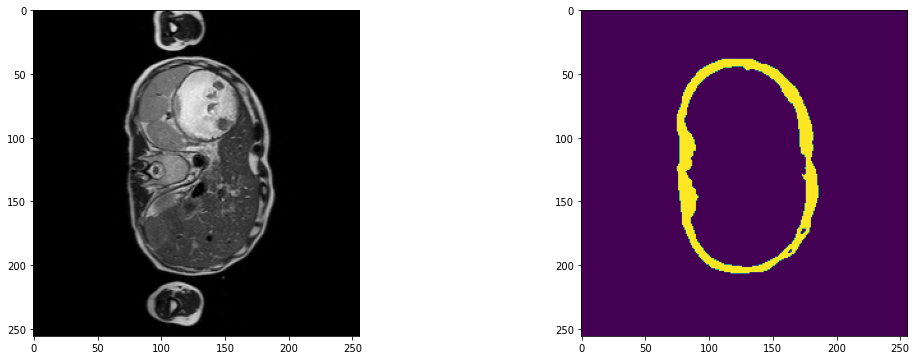

2023-09-14 18:09:18,587 INFO image_writer.py:194 - writing: outMR06_Sep23/A040_v1_T2W_seg.nii.gz


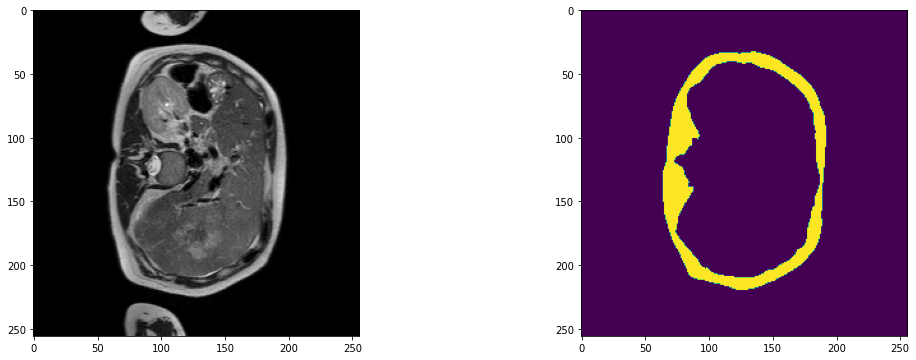

2023-09-14 18:09:31,373 INFO image_writer.py:194 - writing: outMR06_Sep23/A040_v2_T2W_seg.nii.gz


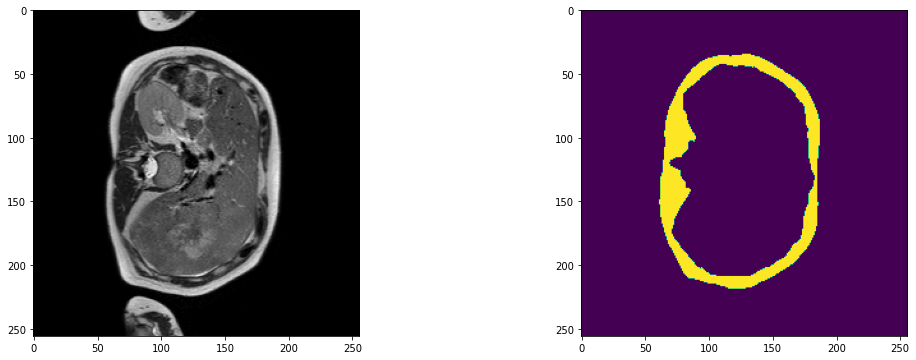

2023-09-14 18:09:43,983 INFO image_writer.py:194 - writing: outMR06_Sep23/A040_v3_T2W_seg.nii.gz


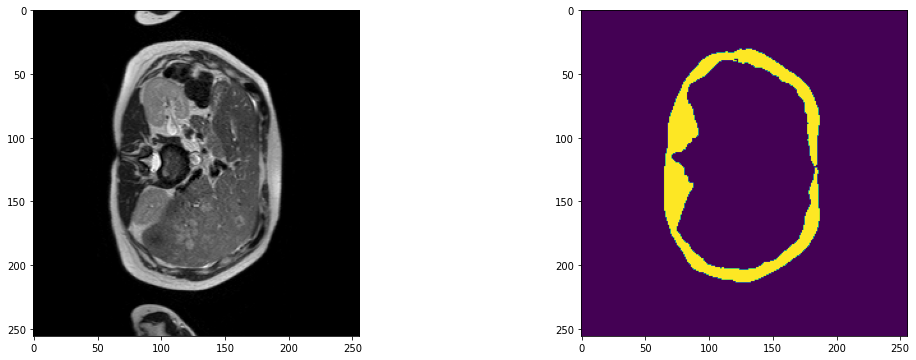

2023-09-14 18:09:54,615 INFO image_writer.py:194 - writing: outMR06_Sep23/A040_v4_T2W_seg.nii.gz


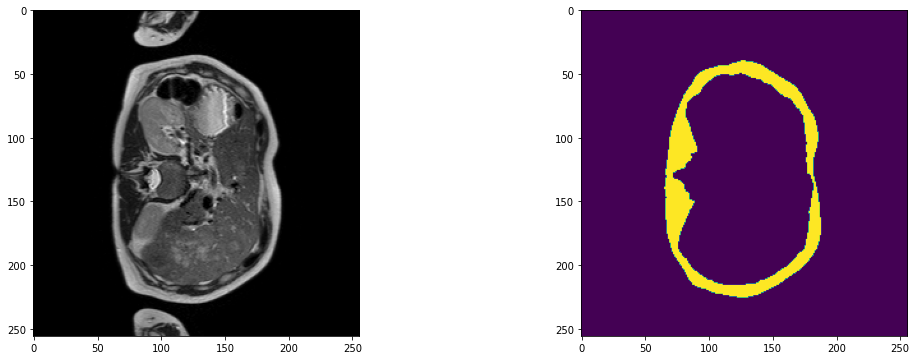

2023-09-14 18:10:05,264 INFO image_writer.py:194 - writing: outMR06_Sep23/A040_v5_T2W_seg.nii.gz


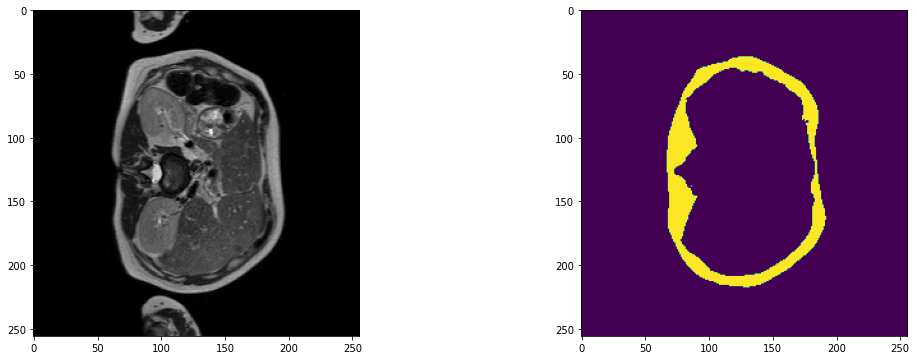

2023-09-14 18:10:11,002 INFO image_writer.py:194 - writing: outMR06_Sep23/A041_v1_T2W_seg.nii.gz


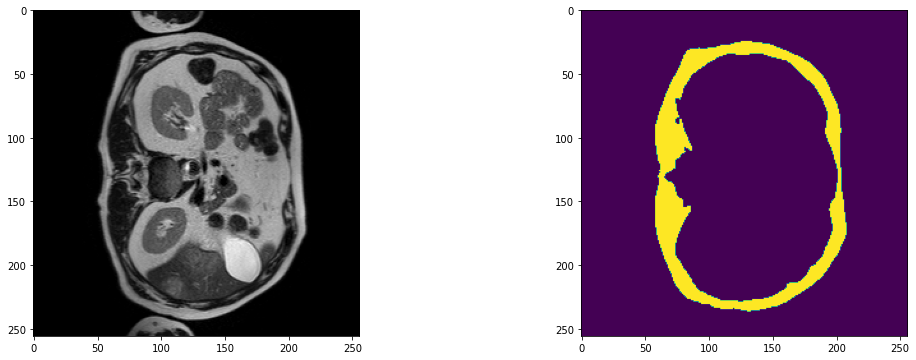

2023-09-14 18:10:16,748 INFO image_writer.py:194 - writing: outMR06_Sep23/A041_v2_T2W_seg.nii.gz


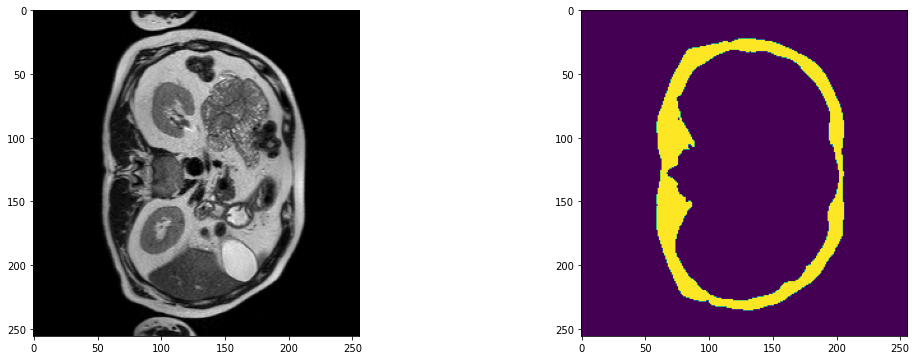

2023-09-14 18:10:22,499 INFO image_writer.py:194 - writing: outMR06_Sep23/A041_v4_T2W_seg.nii.gz


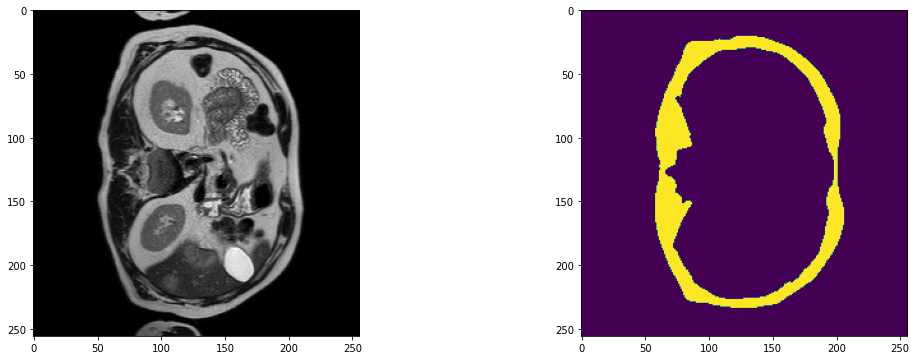

2023-09-14 18:10:28,278 INFO image_writer.py:194 - writing: outMR06_Sep23/A041_v5_T2W_seg.nii.gz


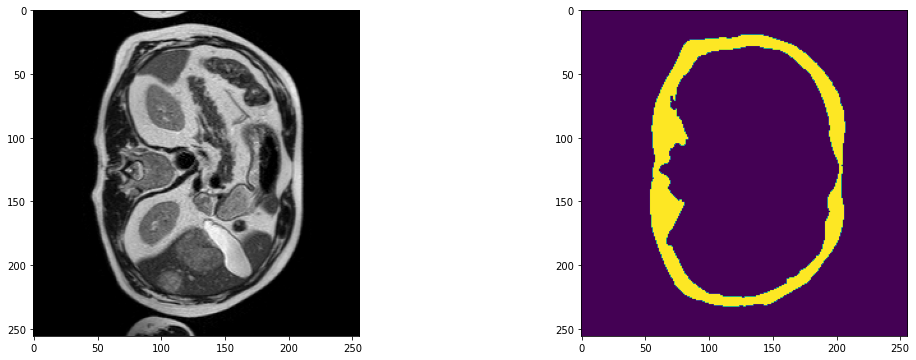

2023-09-14 18:10:34,023 INFO image_writer.py:194 - writing: outMR06_Sep23/A041_v6_T2W_seg.nii.gz


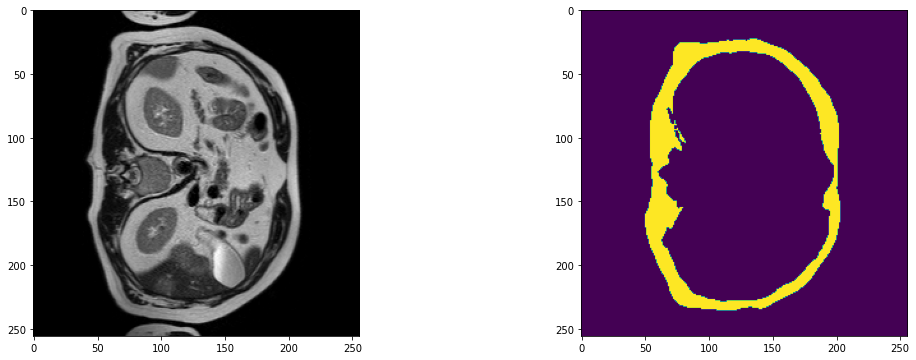

2023-09-14 18:10:39,793 INFO image_writer.py:194 - writing: outMR06_Sep23/A046_v1_T2W_seg.nii.gz


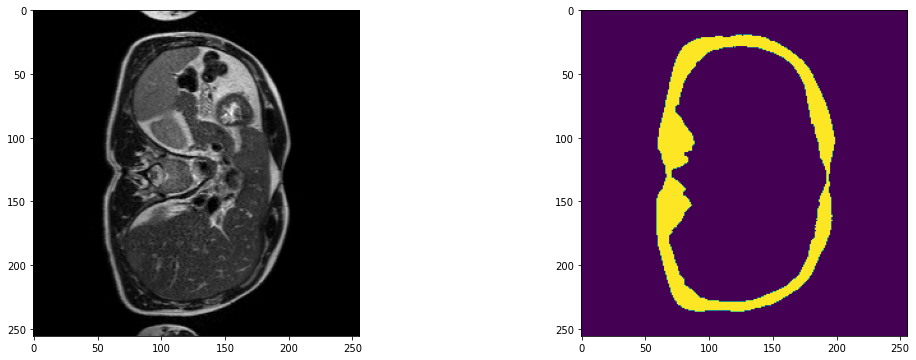

2023-09-14 18:10:45,517 INFO image_writer.py:194 - writing: outMR06_Sep23/A046_v2_T2W_seg.nii.gz


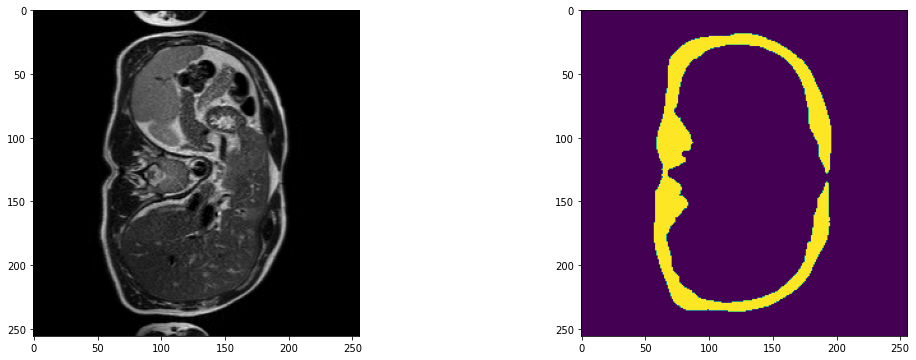

2023-09-14 18:10:50,447 INFO image_writer.py:194 - writing: outMR06_Sep23/A046_v3_T2W_seg.nii.gz


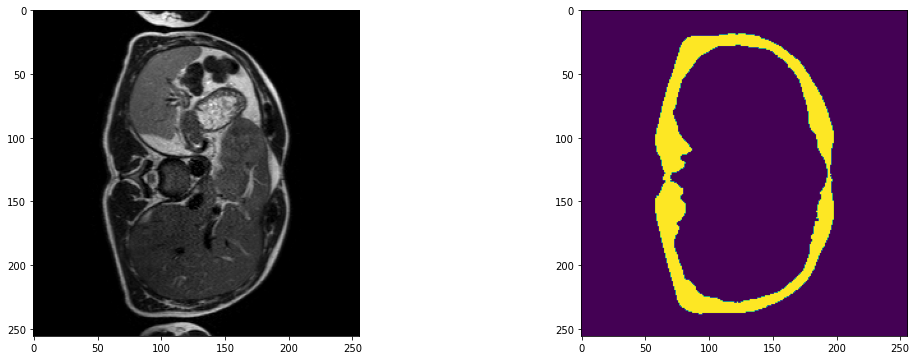

2023-09-14 18:10:56,319 INFO image_writer.py:194 - writing: outMR06_Sep23/A046_v4_T2W_seg.nii.gz


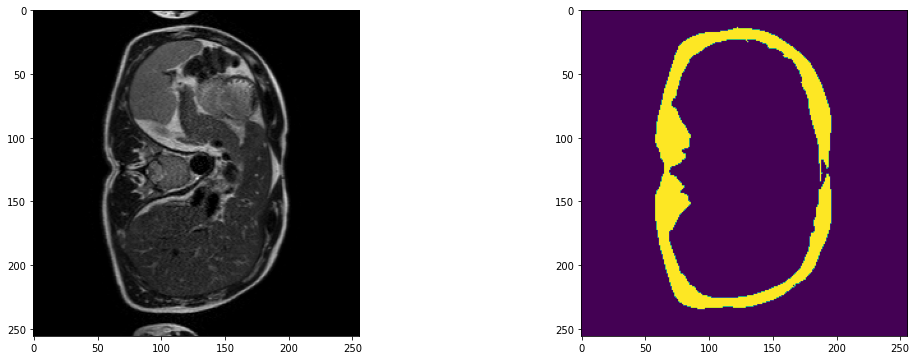

2023-09-14 18:11:02,070 INFO image_writer.py:194 - writing: outMR06_Sep23/A046_v5_T2W_seg.nii.gz


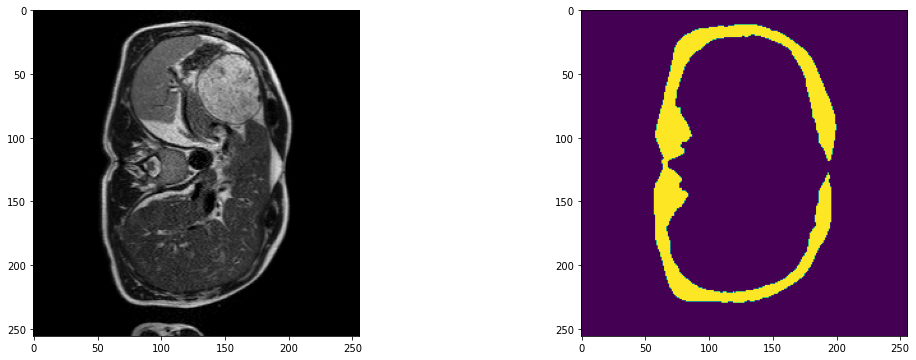

2023-09-14 18:11:07,847 INFO image_writer.py:194 - writing: outMR06_Sep23/A046_v6_T2W_seg.nii.gz


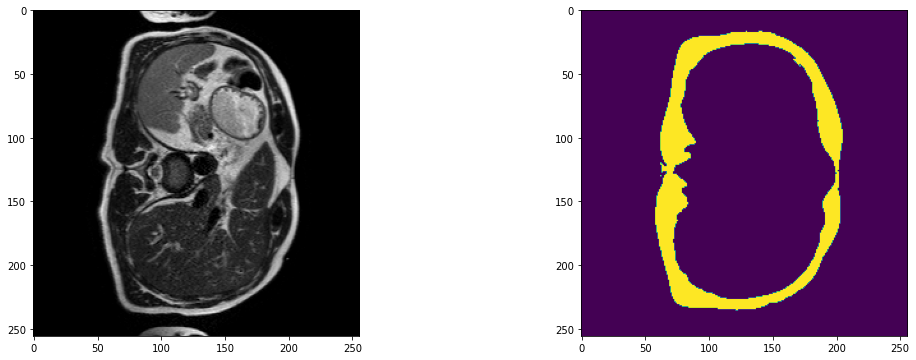

2023-09-14 18:11:13,624 INFO image_writer.py:194 - writing: outMR06_Sep23/A046_v7_T2W_seg.nii.gz


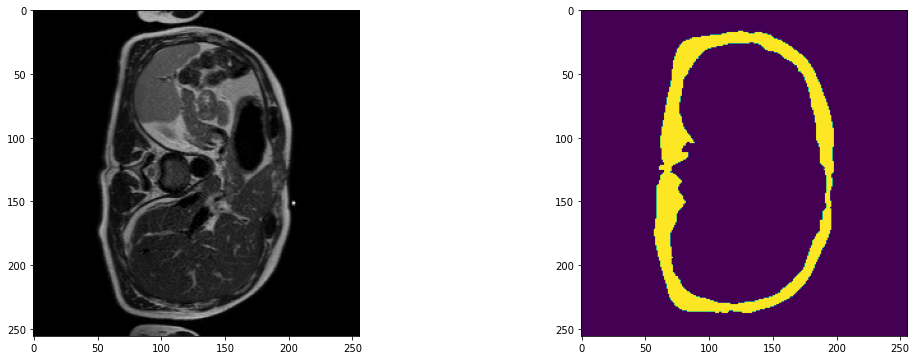

2023-09-14 18:11:19,387 INFO image_writer.py:194 - writing: outMR06_Sep23/A048_v1_T2W_seg.nii.gz


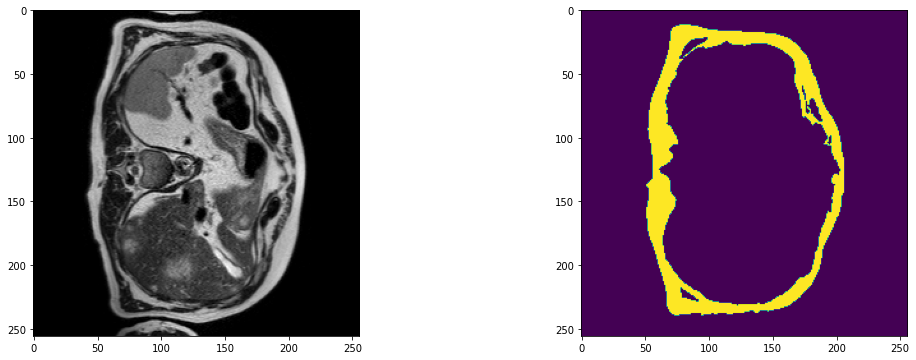

2023-09-14 18:11:25,141 INFO image_writer.py:194 - writing: outMR06_Sep23/A048_v2_T2W_seg.nii.gz


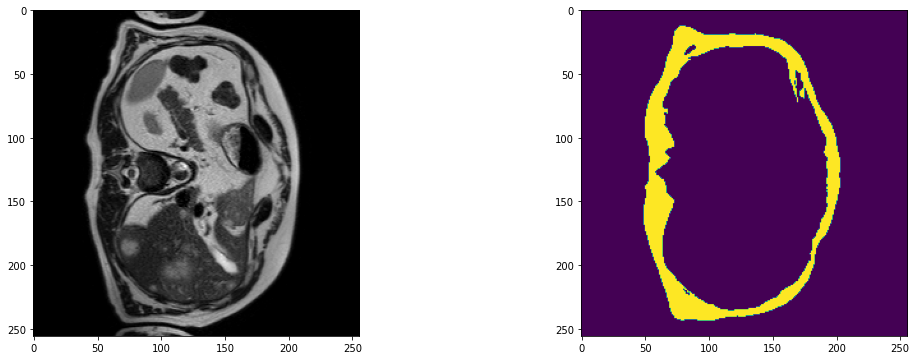

2023-09-14 18:11:30,895 INFO image_writer.py:194 - writing: outMR06_Sep23/A048_v3_T2W_seg.nii.gz


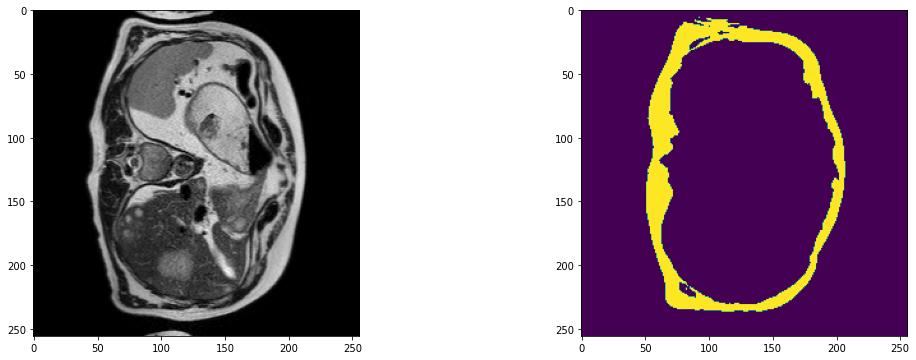

2023-09-14 18:11:36,634 INFO image_writer.py:194 - writing: outMR06_Sep23/A048_v4_T2W_seg.nii.gz


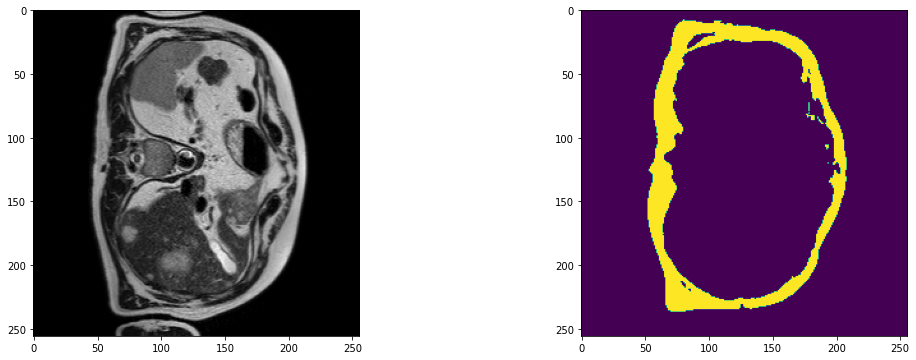

2023-09-14 18:11:42,371 INFO image_writer.py:194 - writing: outMR06_Sep23/A048_v5_T2W_seg.nii.gz


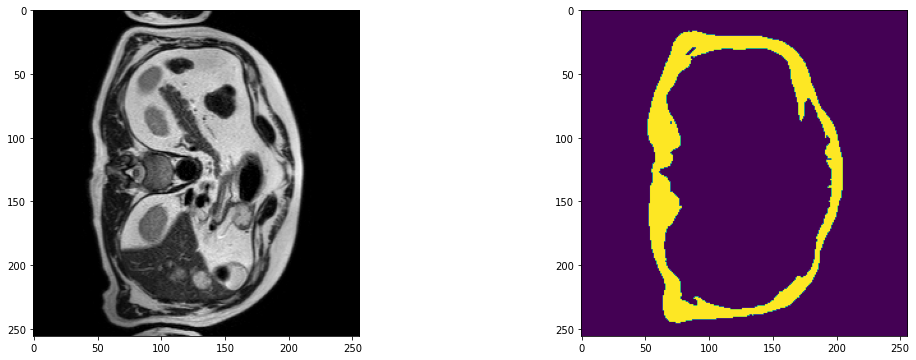

2023-09-14 18:11:48,110 INFO image_writer.py:194 - writing: outMR06_Sep23/A048_v6_T2W_seg.nii.gz


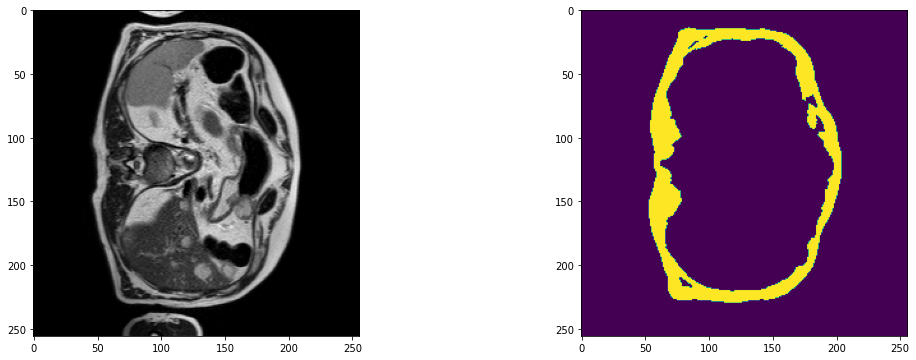

2023-09-14 18:11:53,841 INFO image_writer.py:194 - writing: outMR06_Sep23/A048_v7_T2W_seg.nii.gz


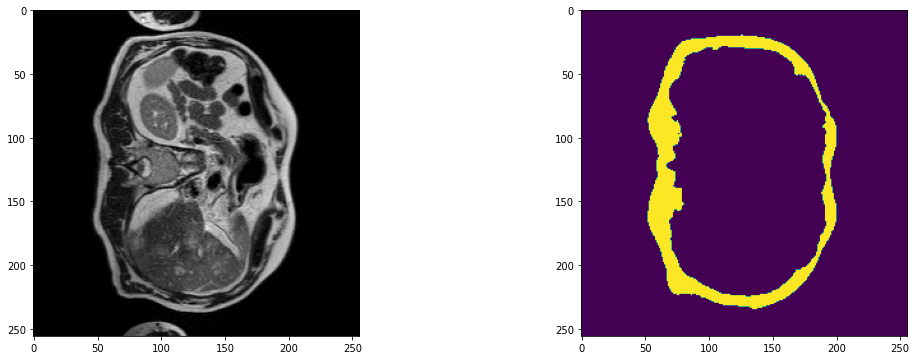

2023-09-14 18:11:59,593 INFO image_writer.py:194 - writing: outMR06_Sep23/A049_v1_T2W_seg.nii.gz


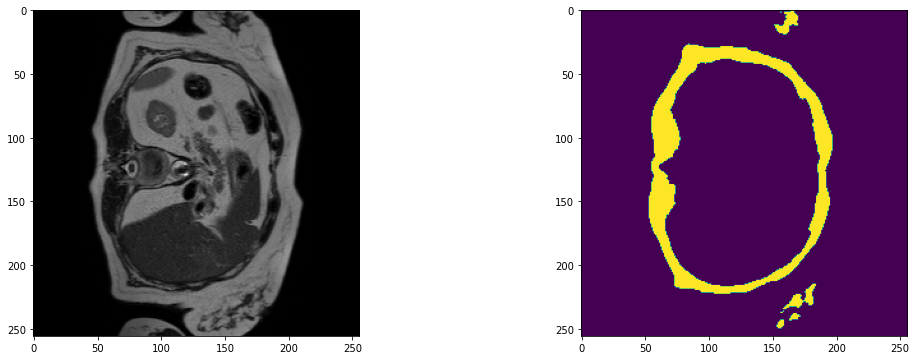

2023-09-14 18:12:05,340 INFO image_writer.py:194 - writing: outMR06_Sep23/A049_v2_T2W_seg.nii.gz


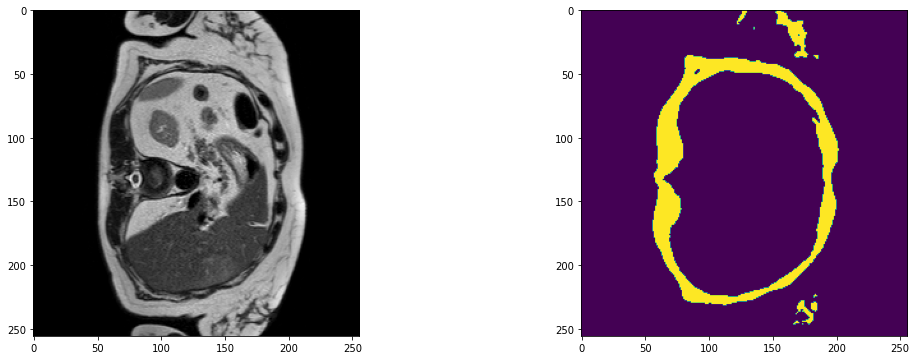

2023-09-14 18:12:11,100 INFO image_writer.py:194 - writing: outMR06_Sep23/A049_v3_T2W_seg.nii.gz


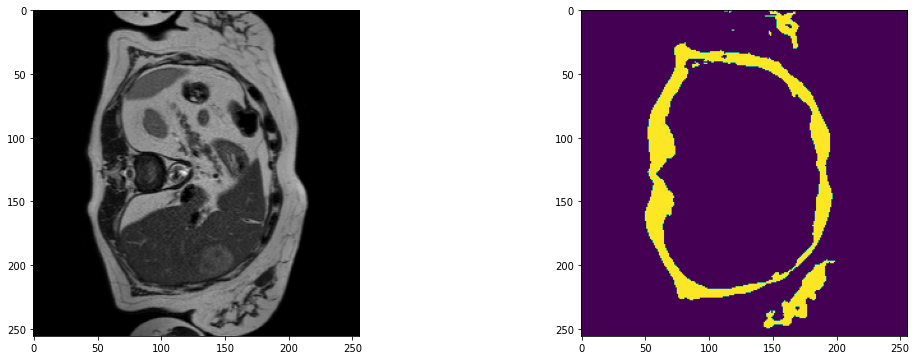

2023-09-14 18:12:16,994 INFO image_writer.py:194 - writing: outMR06_Sep23/A049_v4_T2W_seg.nii.gz


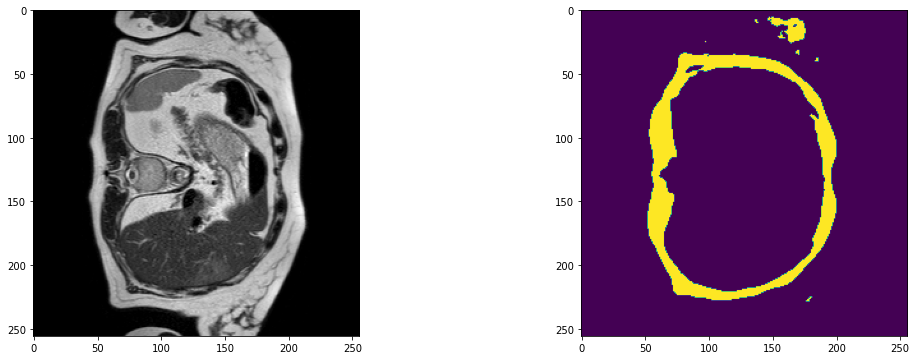

2023-09-14 18:12:22,764 INFO image_writer.py:194 - writing: outMR06_Sep23/A049_v5_T2W_seg.nii.gz


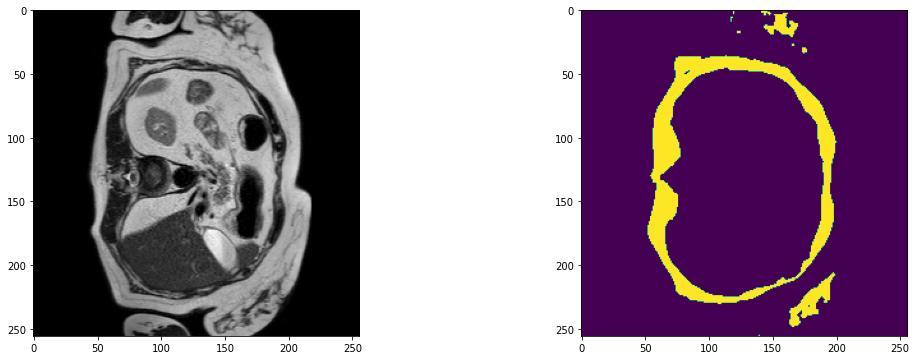

2023-09-14 18:12:35,389 INFO image_writer.py:194 - writing: outMR06_Sep23/A052_v1_T2W_seg.nii.gz


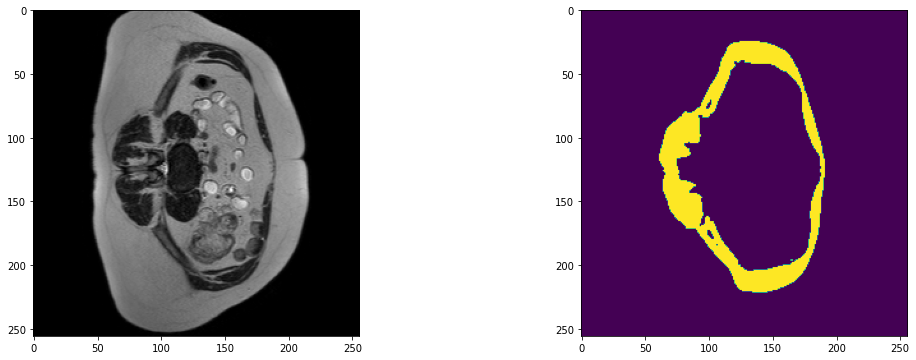

2023-09-14 18:12:47,996 INFO image_writer.py:194 - writing: outMR06_Sep23/A052_v2_T2W_seg.nii.gz


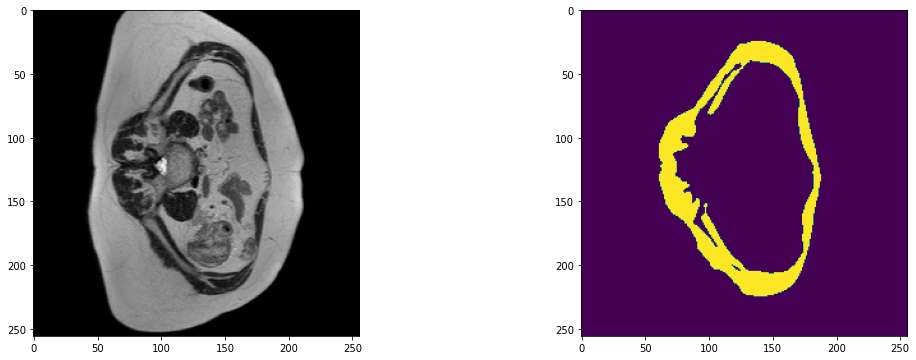

2023-09-14 18:13:00,625 INFO image_writer.py:194 - writing: outMR06_Sep23/A052_v4_T2W_seg.nii.gz


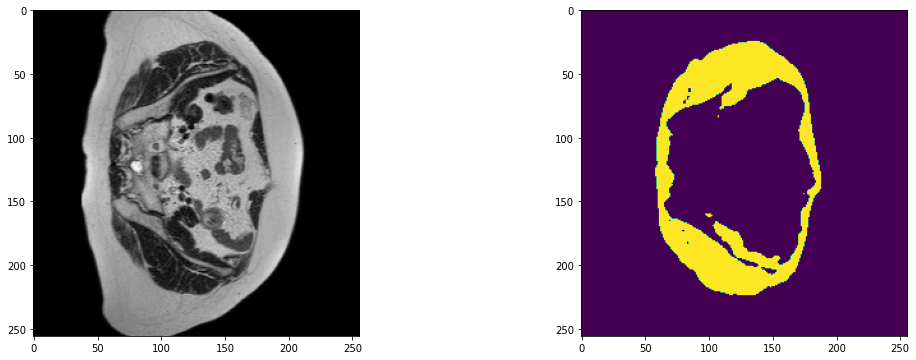

2023-09-14 18:13:13,269 INFO image_writer.py:194 - writing: outMR06_Sep23/A052_v5_T2W_seg.nii.gz


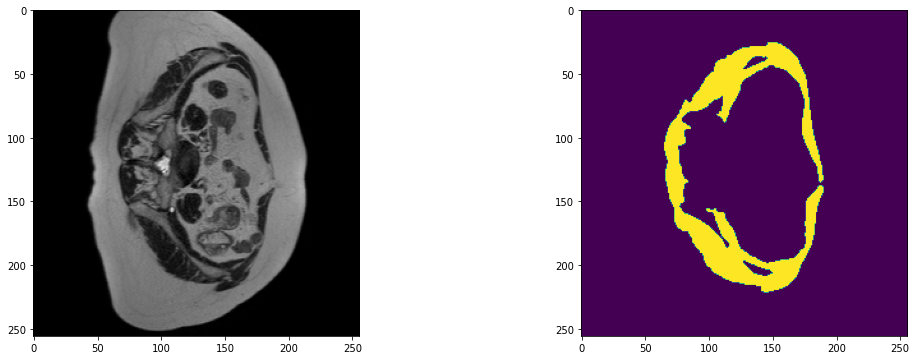

2023-09-14 18:13:19,079 INFO image_writer.py:194 - writing: outMR06_Sep23/A055_v1_T2W_seg.nii.gz


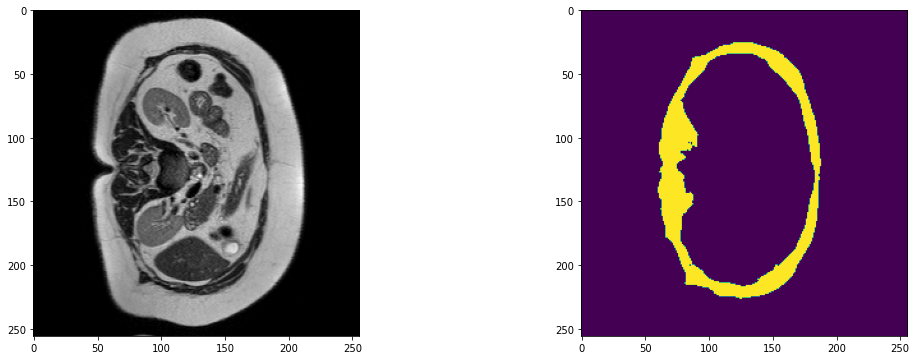

2023-09-14 18:13:24,849 INFO image_writer.py:194 - writing: outMR06_Sep23/A055_v2_T2W_seg.nii.gz


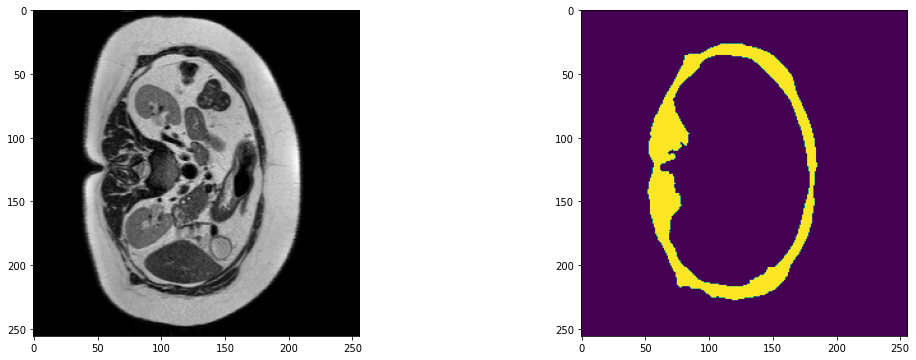

2023-09-14 18:13:30,611 INFO image_writer.py:194 - writing: outMR06_Sep23/A055_v3_T2W_seg.nii.gz


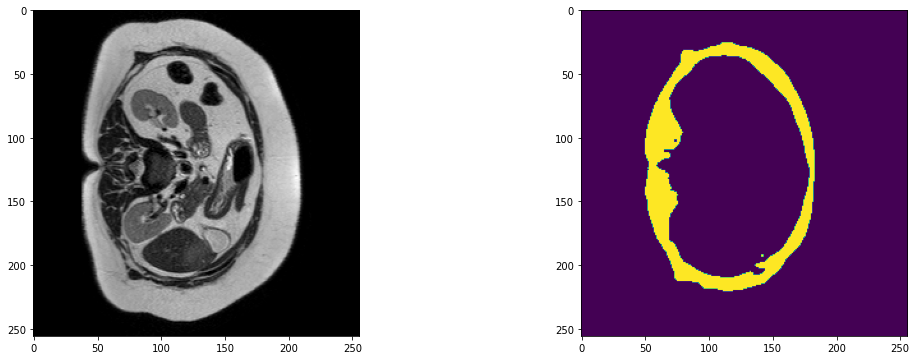

2023-09-14 18:13:36,384 INFO image_writer.py:194 - writing: outMR06_Sep23/A055_v4_T2W_seg.nii.gz


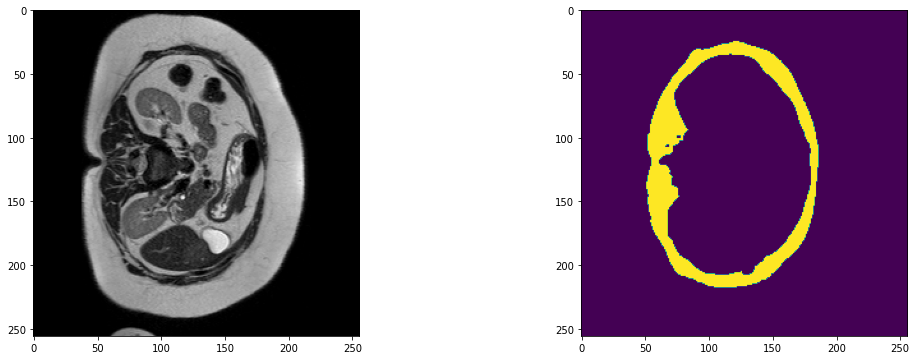

2023-09-14 18:13:42,143 INFO image_writer.py:194 - writing: outMR06_Sep23/A055_v5_T2W_seg.nii.gz


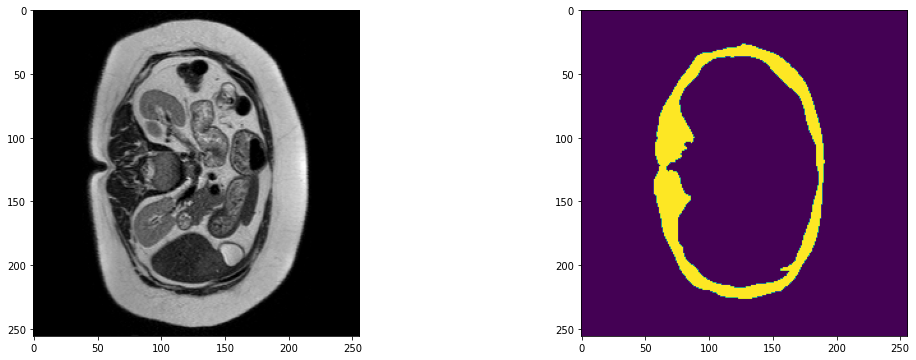

2023-09-14 18:13:47,897 INFO image_writer.py:194 - writing: outMR06_Sep23/A055_v6_T2W_seg.nii.gz


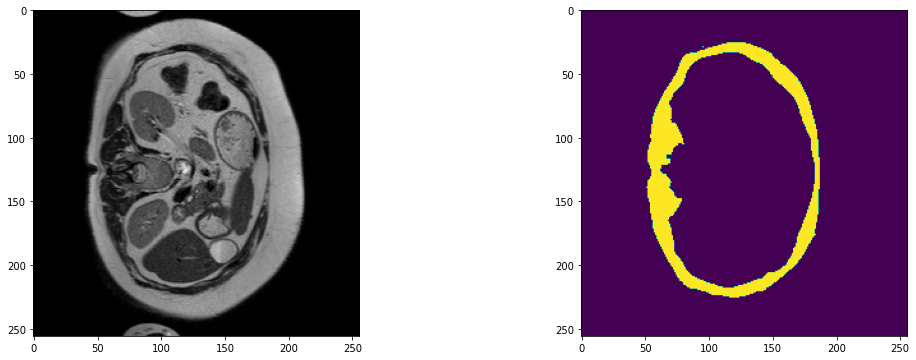

2023-09-14 18:13:53,652 INFO image_writer.py:194 - writing: outMR06_Sep23/A056_v1_T2W_seg.nii.gz


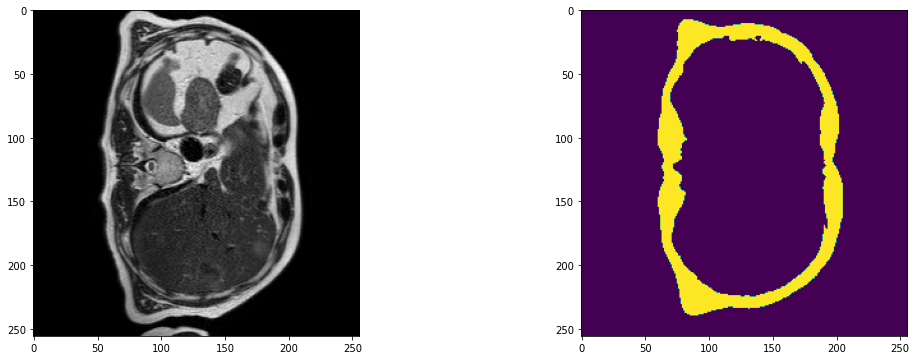

2023-09-14 18:13:59,453 INFO image_writer.py:194 - writing: outMR06_Sep23/A056_v2_T2W_seg.nii.gz


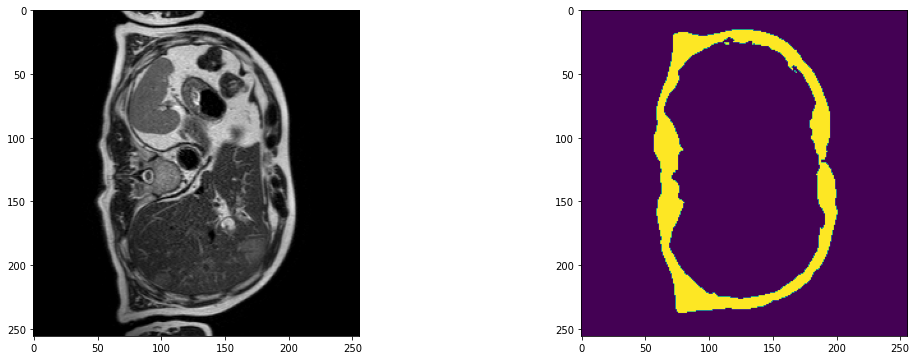

2023-09-14 18:14:05,353 INFO image_writer.py:194 - writing: outMR06_Sep23/A056_v3_T2W_seg.nii.gz


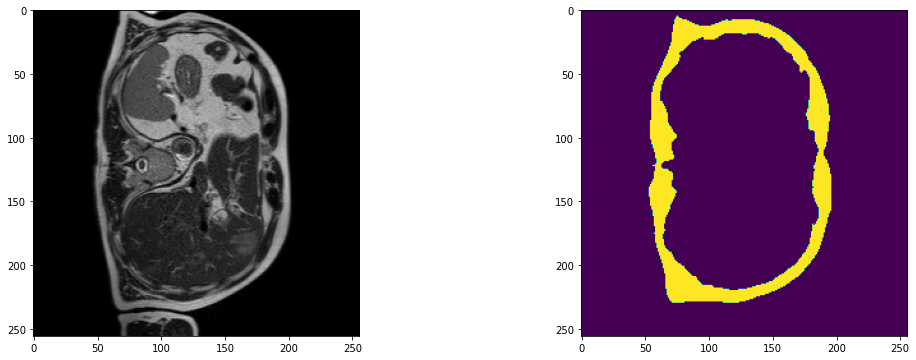

2023-09-14 18:14:11,118 INFO image_writer.py:194 - writing: outMR06_Sep23/A056_v4_T2W_seg.nii.gz


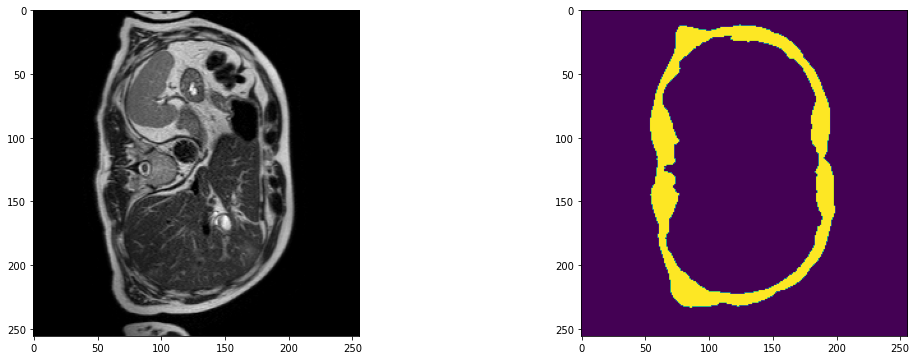

2023-09-14 18:14:16,874 INFO image_writer.py:194 - writing: outMR06_Sep23/A056_v5_T2W_seg.nii.gz


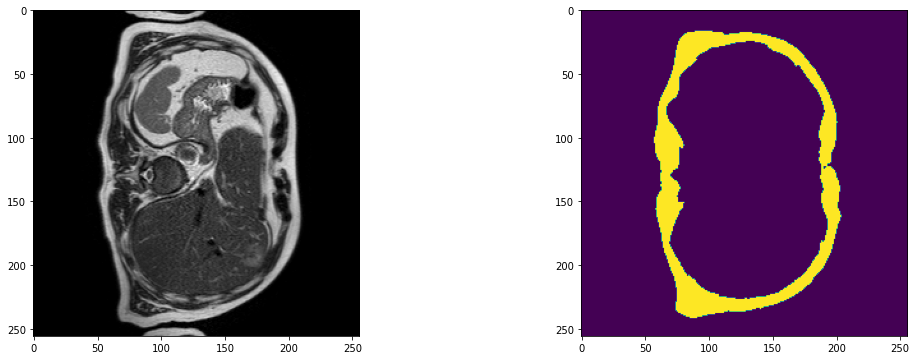

2023-09-14 18:14:22,640 INFO image_writer.py:194 - writing: outMR06_Sep23/A056_v6_T2W_seg.nii.gz


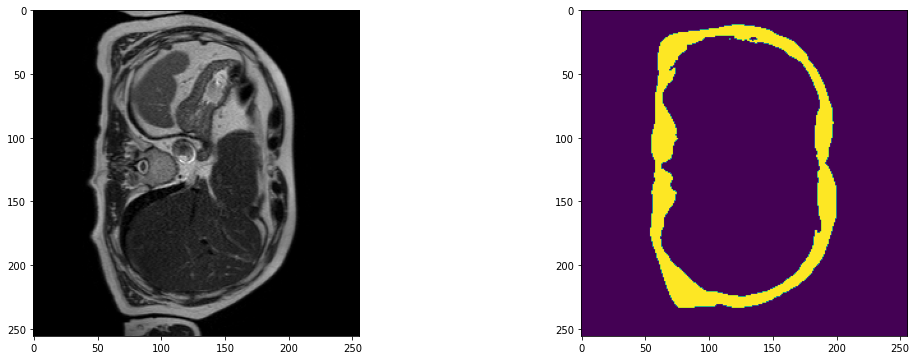

2023-09-14 18:14:28,417 INFO image_writer.py:194 - writing: outMR06_Sep23/A056_v7_T2W_seg.nii.gz


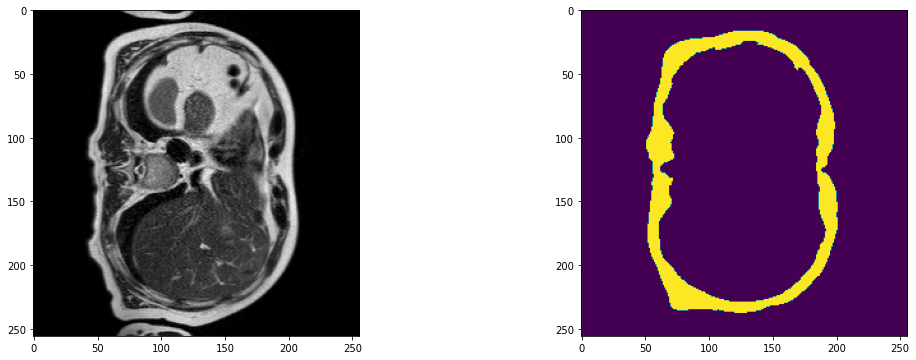

2023-09-14 18:14:34,176 INFO image_writer.py:194 - writing: outMR06_Sep23/A057_v1_T2W_seg.nii.gz


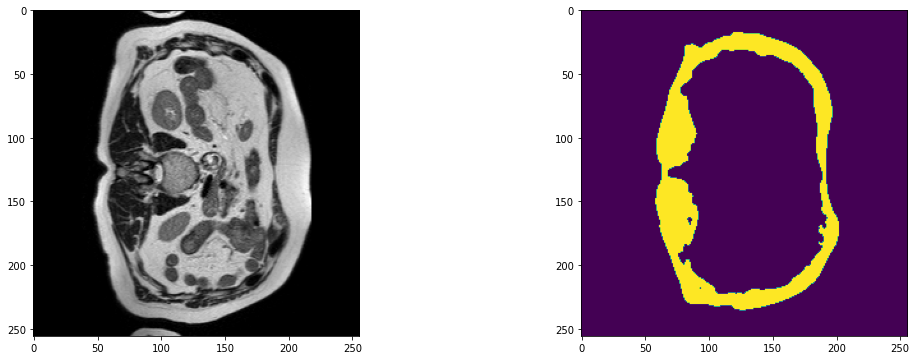

2023-09-14 18:14:39,949 INFO image_writer.py:194 - writing: outMR06_Sep23/A057_v2_T2W_seg.nii.gz


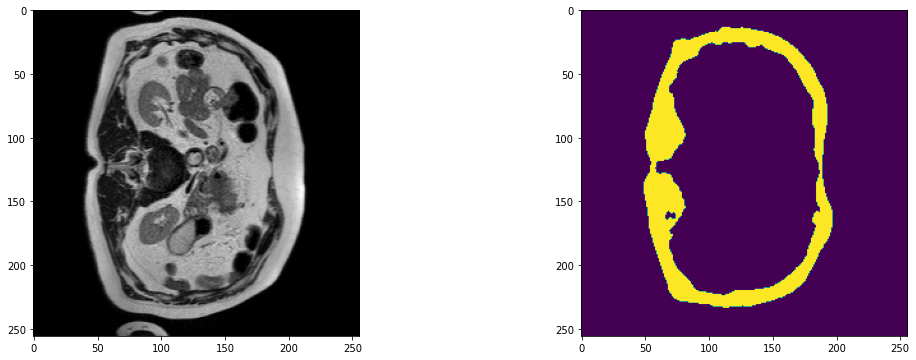

2023-09-14 18:14:45,712 INFO image_writer.py:194 - writing: outMR06_Sep23/A057_v3_T2W_seg.nii.gz


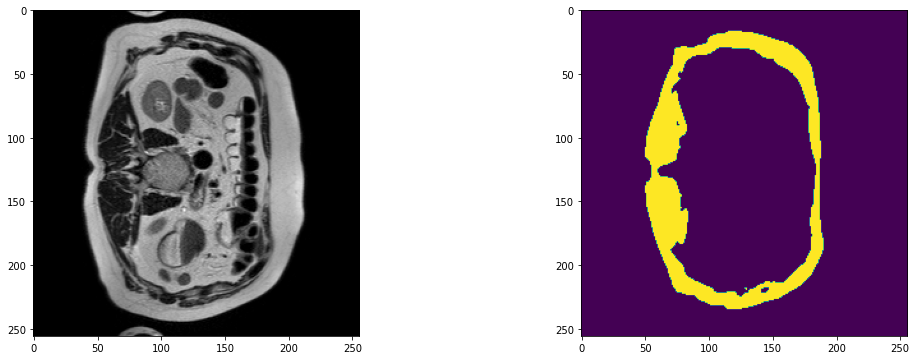

2023-09-14 18:14:51,472 INFO image_writer.py:194 - writing: outMR06_Sep23/A057_v4_T2W_seg.nii.gz


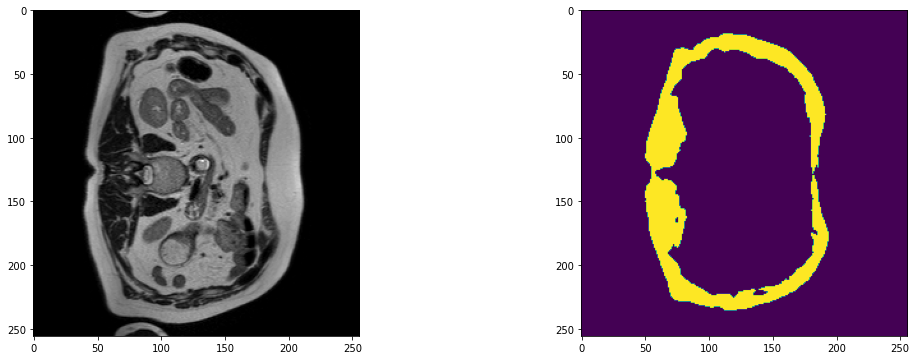

2023-09-14 18:14:57,217 INFO image_writer.py:194 - writing: outMR06_Sep23/A057_v5_T2W_seg.nii.gz


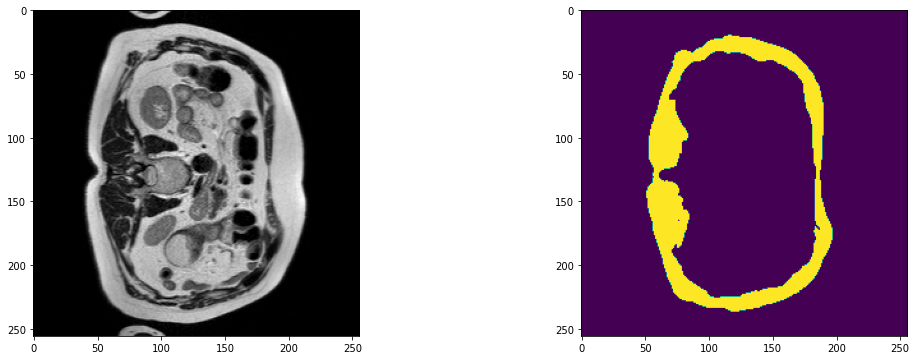

2023-09-14 18:15:02,967 INFO image_writer.py:194 - writing: outMR06_Sep23/A057_v6_T2W_seg.nii.gz


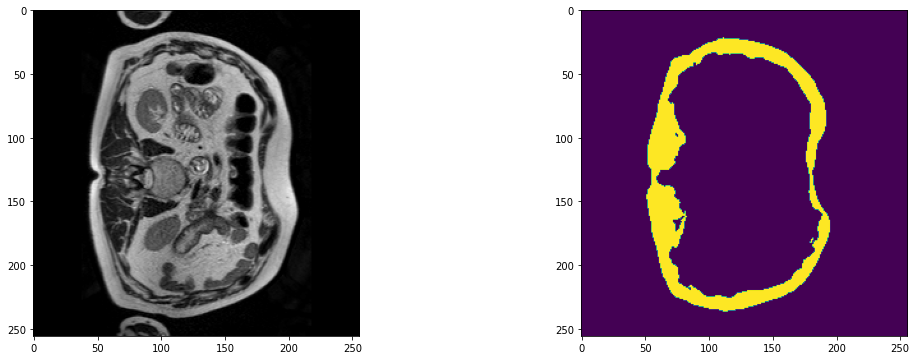

2023-09-14 18:15:15,580 INFO image_writer.py:194 - writing: outMR06_Sep23/A061_v1_T2W_seg.nii.gz


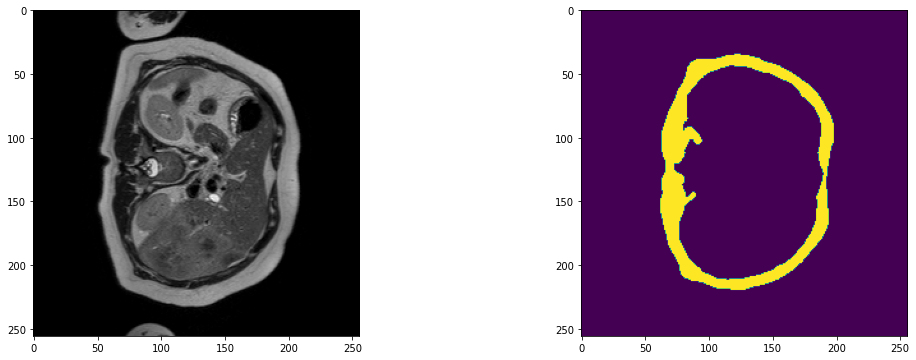

2023-09-14 18:15:28,194 INFO image_writer.py:194 - writing: outMR06_Sep23/A061_v2_T2W_seg.nii.gz


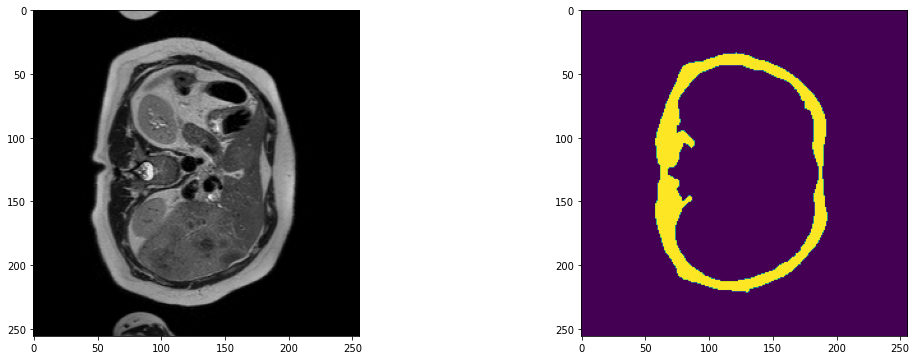

2023-09-14 18:15:40,805 INFO image_writer.py:194 - writing: outMR06_Sep23/A061_v3_T2W_seg.nii.gz


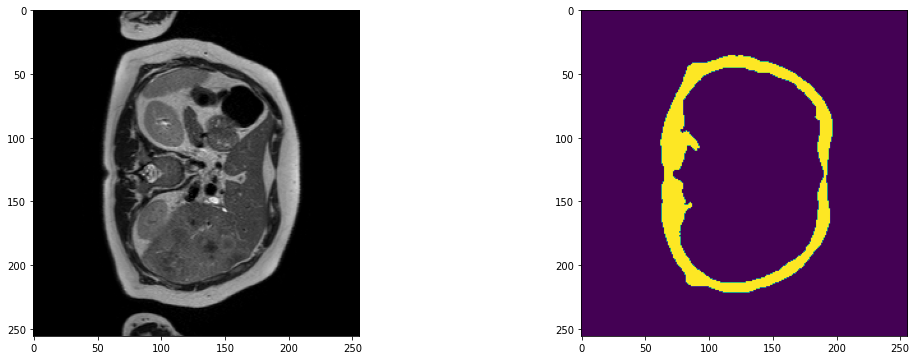

2023-09-14 18:15:53,556 INFO image_writer.py:194 - writing: outMR06_Sep23/A061_v4_T2W_seg.nii.gz


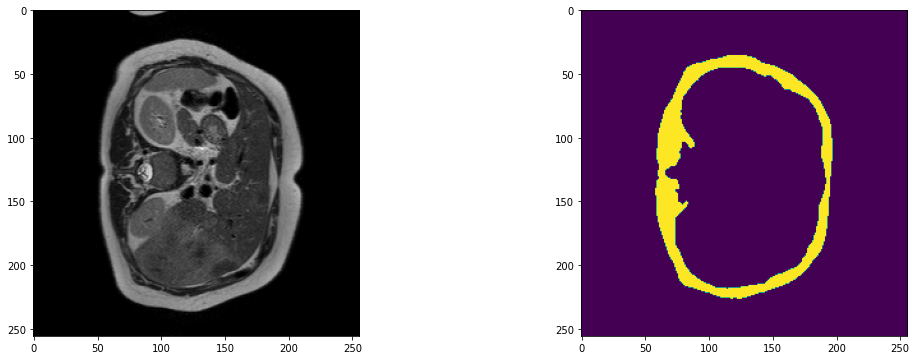

2023-09-14 18:16:06,203 INFO image_writer.py:194 - writing: outMR06_Sep23/A061_v5_T2W_seg.nii.gz


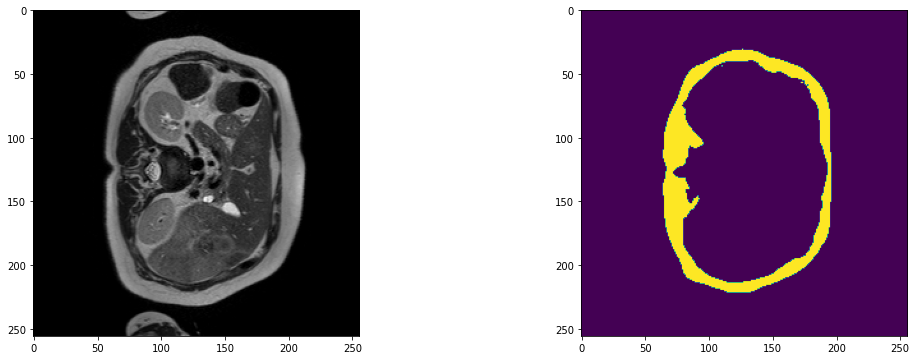

2023-09-14 18:16:11,109 INFO image_writer.py:194 - writing: outMR06_Sep23/A062_v1_T2W_seg.nii.gz


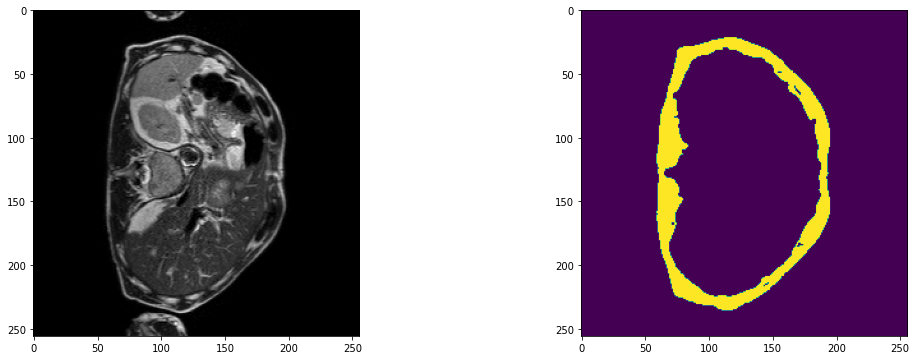

2023-09-14 18:16:16,019 INFO image_writer.py:194 - writing: outMR06_Sep23/A062_v2_T2W_seg.nii.gz


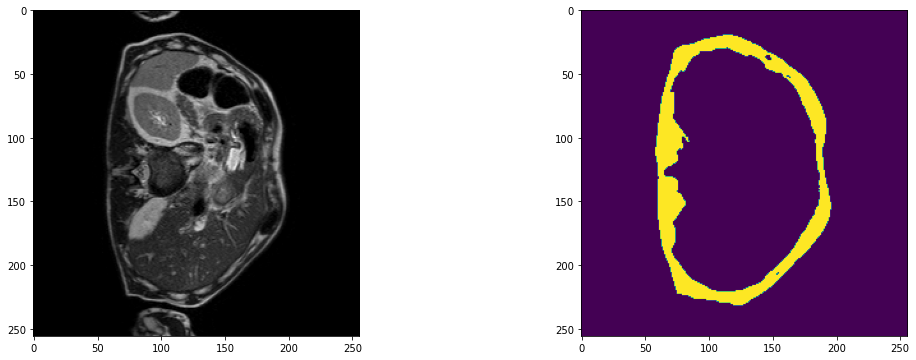

2023-09-14 18:16:20,946 INFO image_writer.py:194 - writing: outMR06_Sep23/A062_v3_T2W_seg.nii.gz


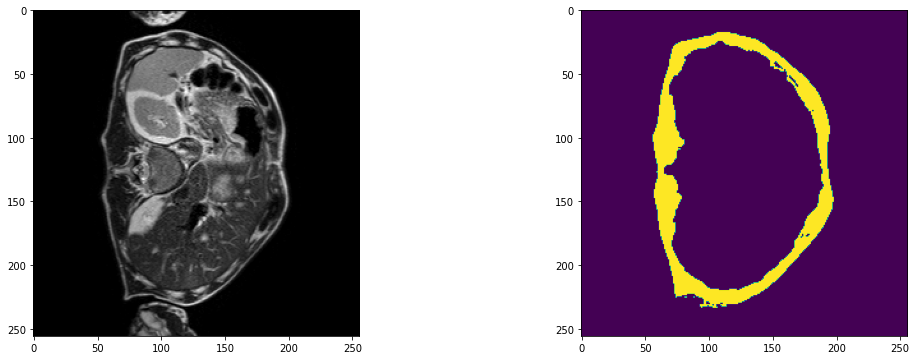

2023-09-14 18:16:26,710 INFO image_writer.py:194 - writing: outMR06_Sep23/A062_v4_T2W_seg.nii.gz


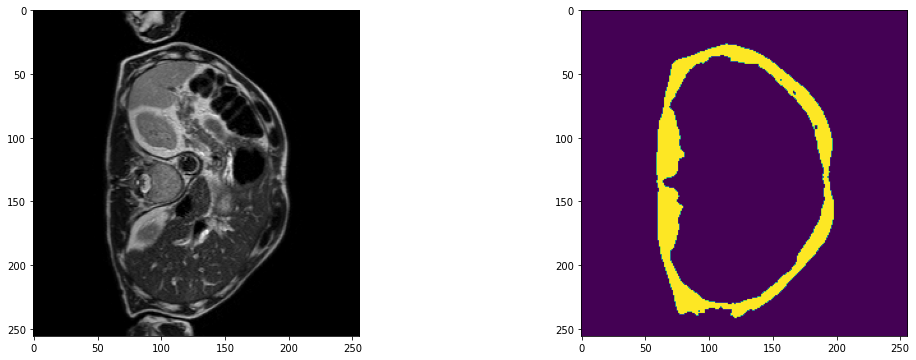

2023-09-14 18:16:31,636 INFO image_writer.py:194 - writing: outMR06_Sep23/A062_v5_T2W_seg.nii.gz


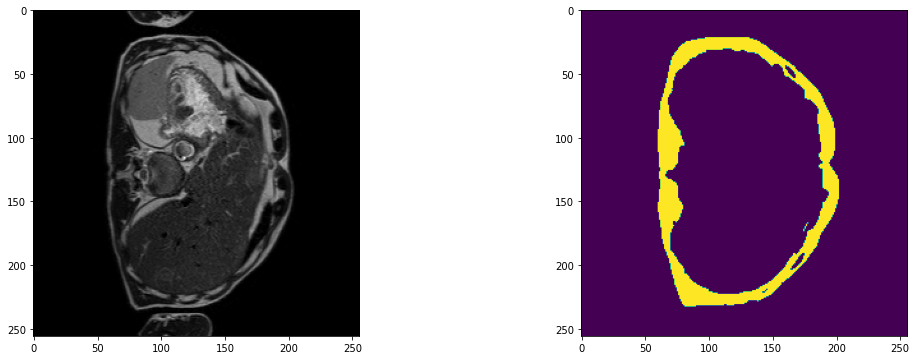

2023-09-14 18:16:37,396 INFO image_writer.py:194 - writing: outMR06_Sep23/A063_v1_T2W_seg.nii.gz


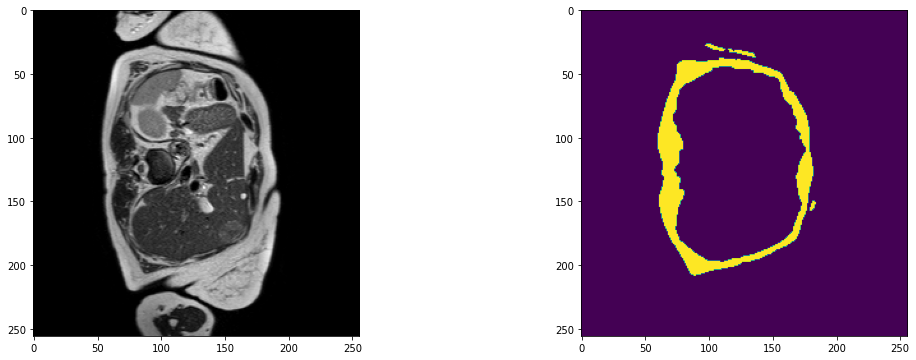

2023-09-14 18:16:43,153 INFO image_writer.py:194 - writing: outMR06_Sep23/A063_v2_T2W_seg.nii.gz


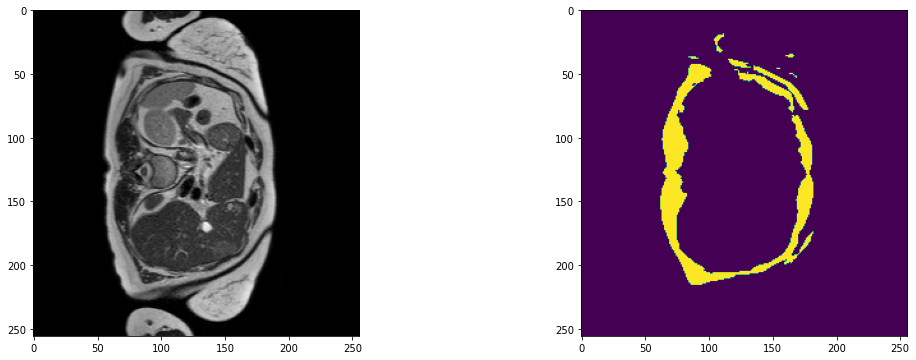

2023-09-14 18:16:48,903 INFO image_writer.py:194 - writing: outMR06_Sep23/A063_v3_T2W_seg.nii.gz


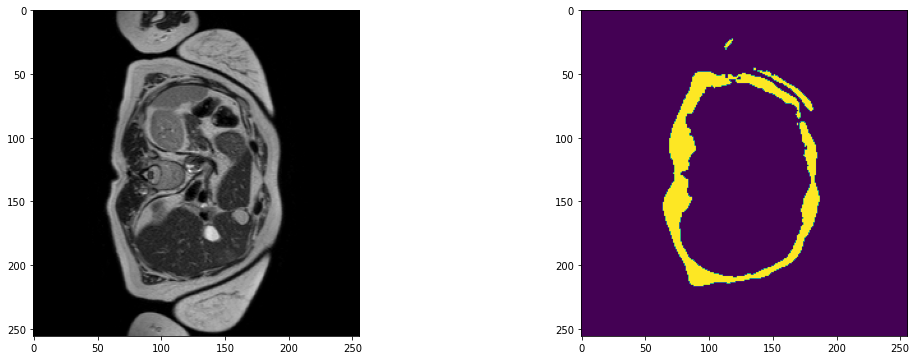

2023-09-14 18:16:54,658 INFO image_writer.py:194 - writing: outMR06_Sep23/A063_v4_T2W_seg.nii.gz


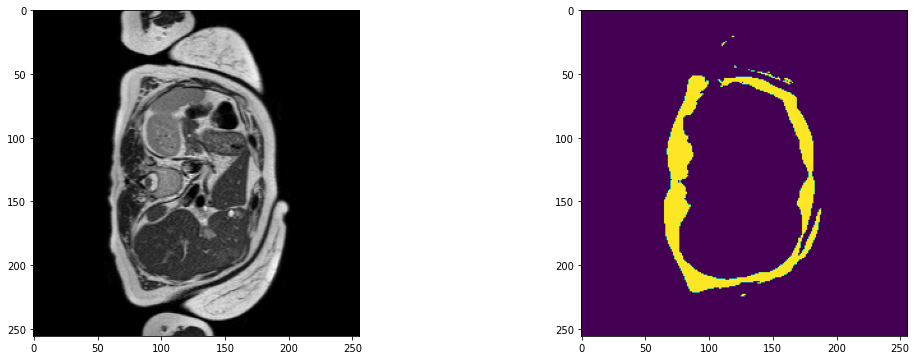

2023-09-14 18:16:59,560 INFO image_writer.py:194 - writing: outMR06_Sep23/A063_v5_T2W_seg.nii.gz


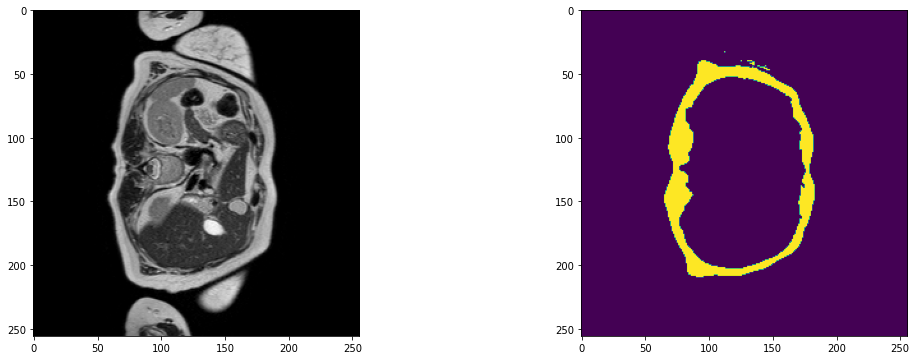

2023-09-14 18:17:04,627 INFO image_writer.py:194 - writing: outMR06_Sep23/A063_v6_T2W_seg.nii.gz


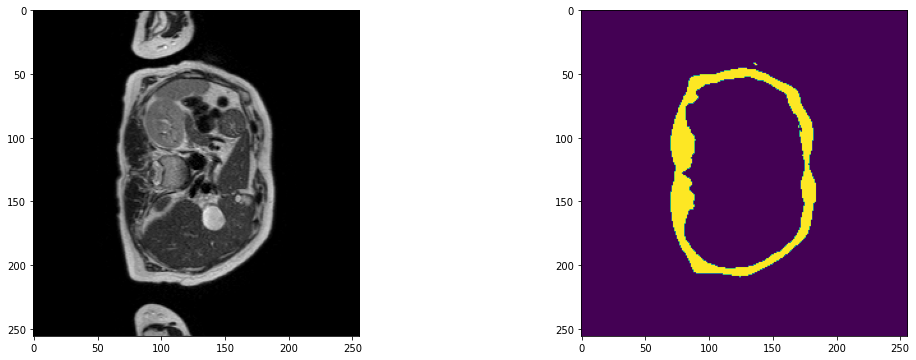

2023-09-14 18:17:09,561 INFO image_writer.py:194 - writing: outMR06_Sep23/A063_v7_T2W_seg.nii.gz


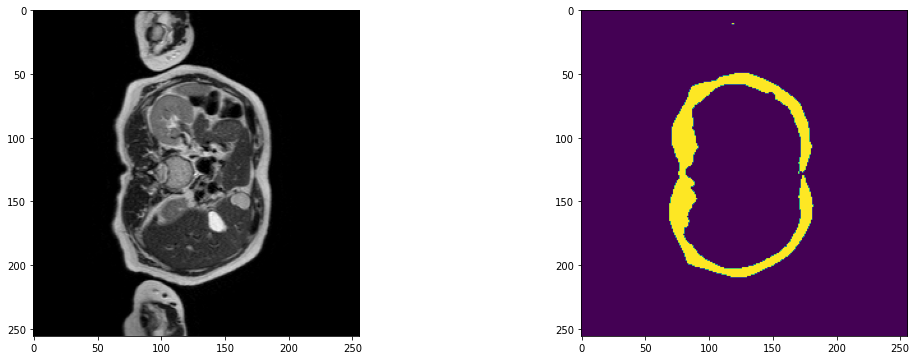

2023-09-14 18:17:14,474 INFO image_writer.py:194 - writing: outMR06_Sep23/A063_v8_T2W_seg.nii.gz


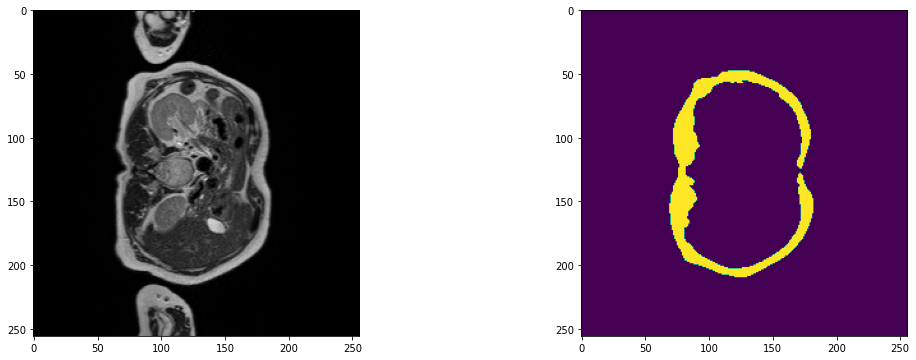

2023-09-14 18:17:20,202 INFO image_writer.py:194 - writing: outMR06_Sep23/A063_v9_T2W_seg.nii.gz


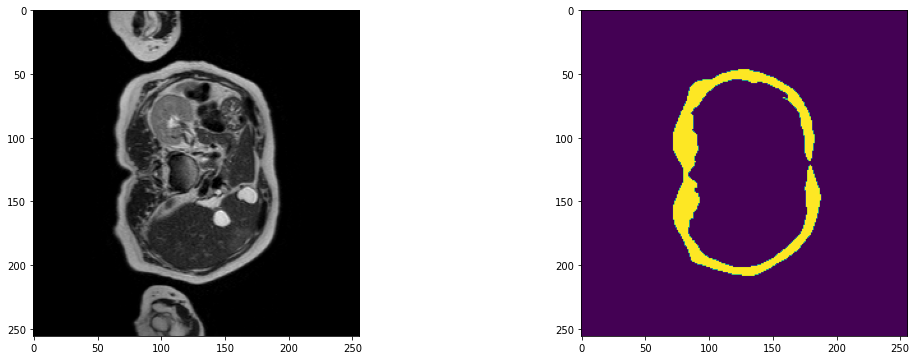

2023-09-14 18:17:25,970 INFO image_writer.py:194 - writing: outMR06_Sep23/A064_v1_T2W_seg.nii.gz


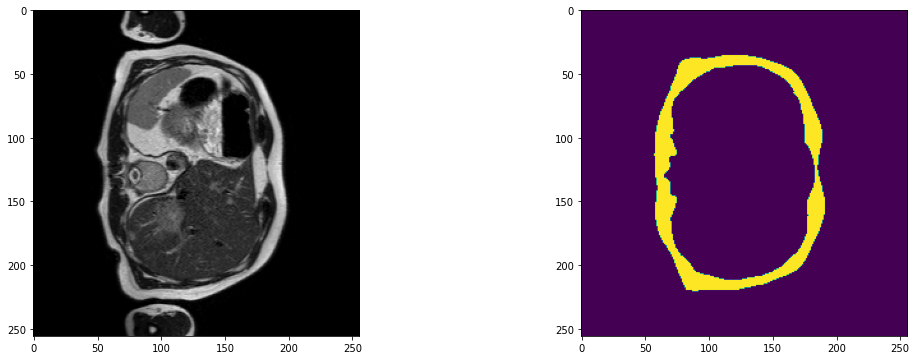

2023-09-14 18:17:31,721 INFO image_writer.py:194 - writing: outMR06_Sep23/A064_v2_T2W_seg.nii.gz


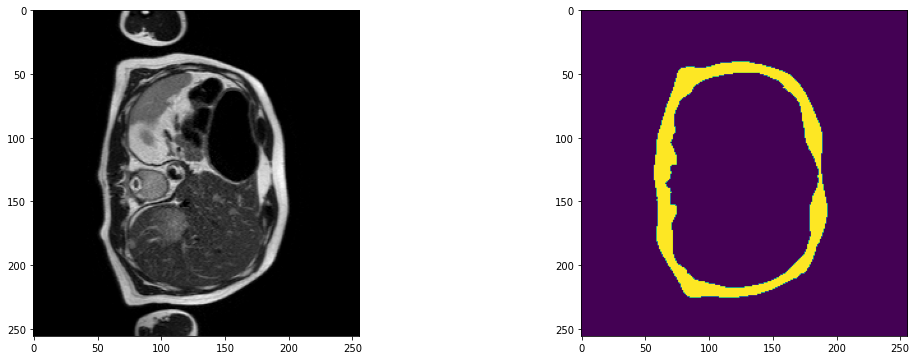

2023-09-14 18:17:37,496 INFO image_writer.py:194 - writing: outMR06_Sep23/A064_v3_T2W_seg.nii.gz


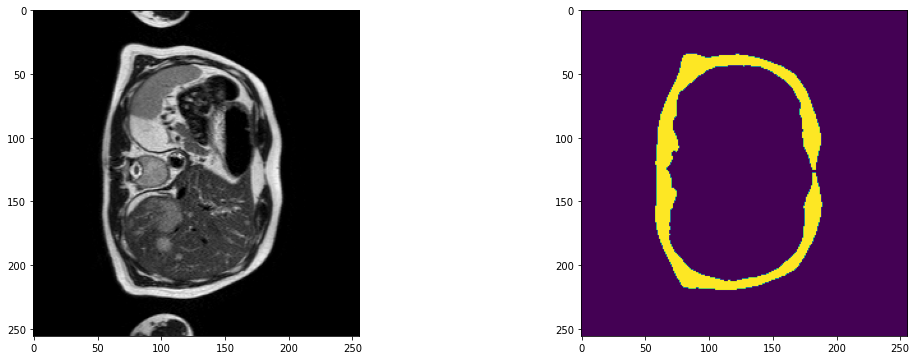

2023-09-14 18:17:43,247 INFO image_writer.py:194 - writing: outMR06_Sep23/A064_v4_T2W_seg.nii.gz


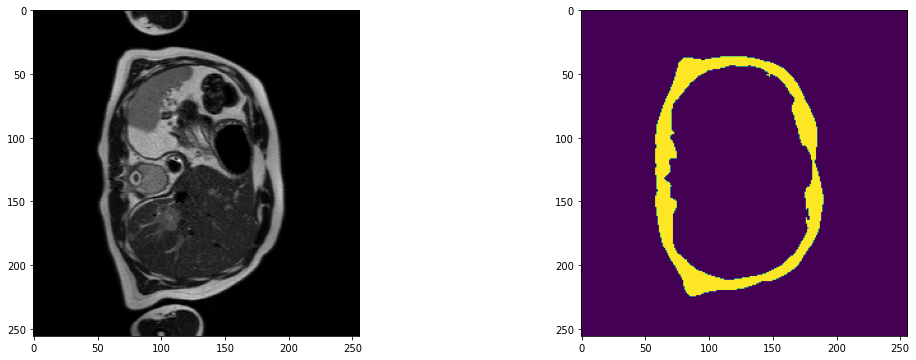

2023-09-14 18:17:48,977 INFO image_writer.py:194 - writing: outMR06_Sep23/A064_v5_T2W_seg.nii.gz


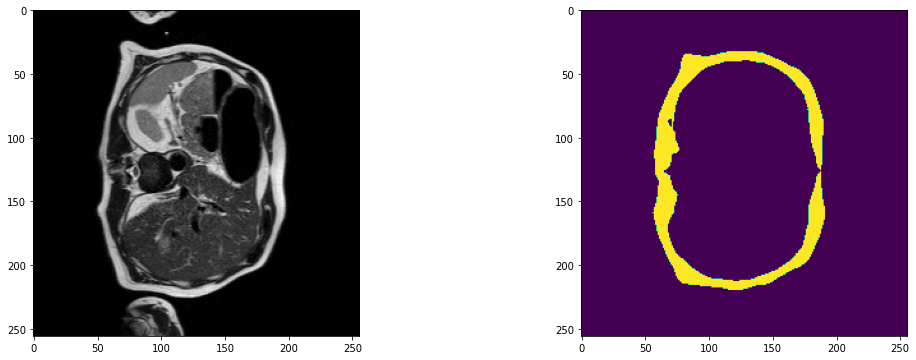

2023-09-14 18:17:54,715 INFO image_writer.py:194 - writing: outMR06_Sep23/A064_v6_T2W_seg.nii.gz


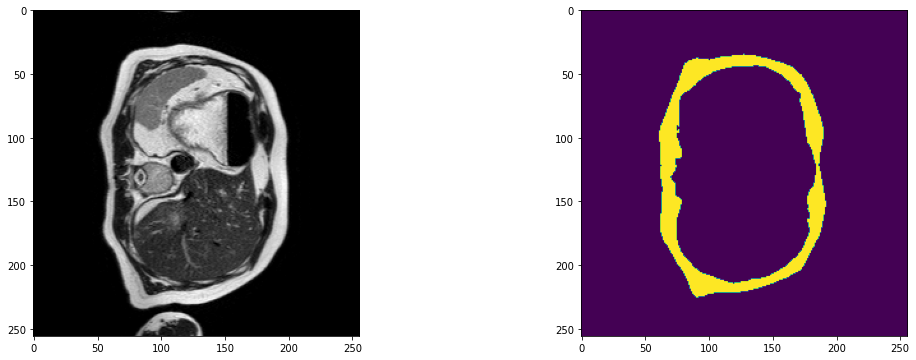

2023-09-14 18:18:00,460 INFO image_writer.py:194 - writing: outMR06_Sep23/A064_v7_T2W_seg.nii.gz


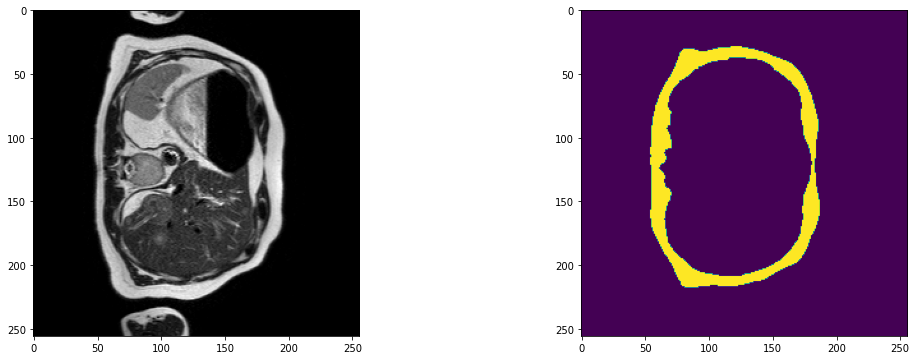

2023-09-14 18:18:06,217 INFO image_writer.py:194 - writing: outMR06_Sep23/A064_v8_T2W_seg.nii.gz


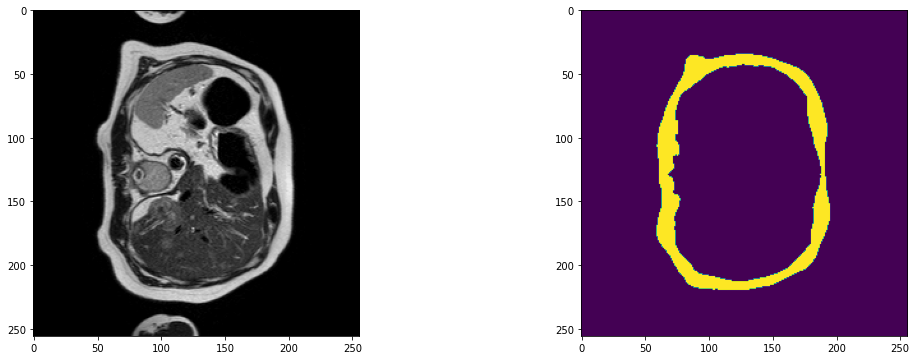

2023-09-14 18:18:11,990 INFO image_writer.py:194 - writing: outMR06_Sep23/A066_v1_T2W_seg.nii.gz


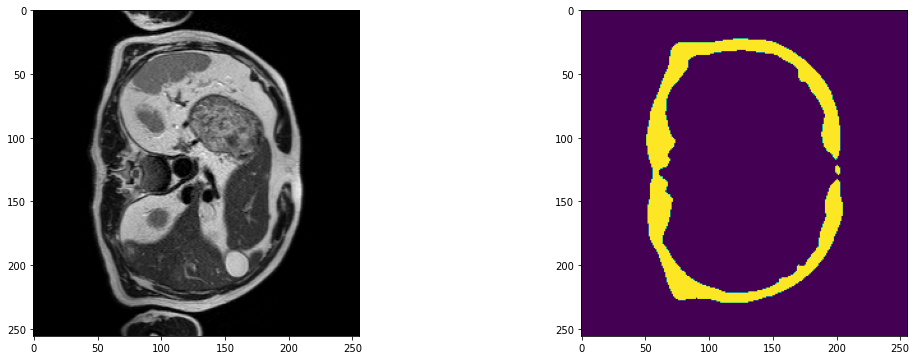

2023-09-14 18:18:17,773 INFO image_writer.py:194 - writing: outMR06_Sep23/A066_v2_T2W_seg.nii.gz


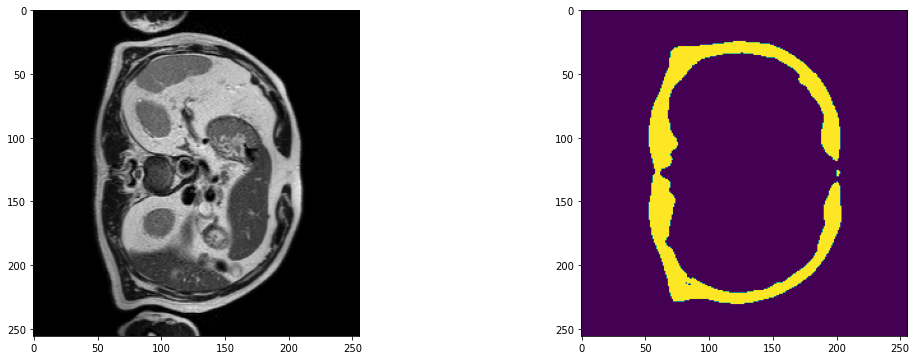

2023-09-14 18:18:23,701 INFO image_writer.py:194 - writing: outMR06_Sep23/A066_v3_T2W_seg.nii.gz


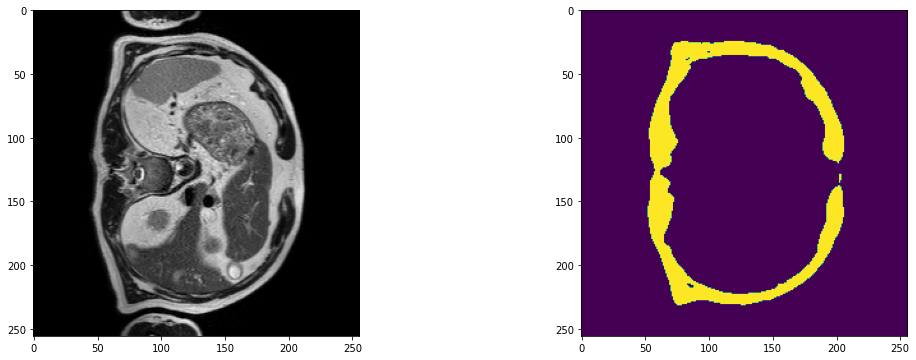

2023-09-14 18:18:29,455 INFO image_writer.py:194 - writing: outMR06_Sep23/A066_v4_T2W_seg.nii.gz


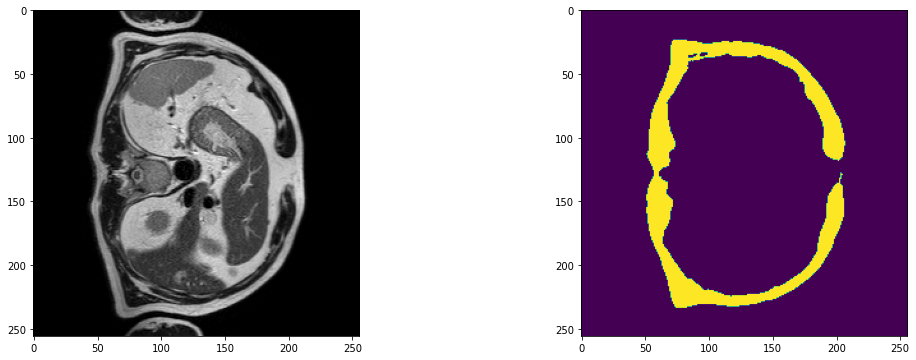

2023-09-14 18:18:35,211 INFO image_writer.py:194 - writing: outMR06_Sep23/A066_v5_T2W_seg.nii.gz


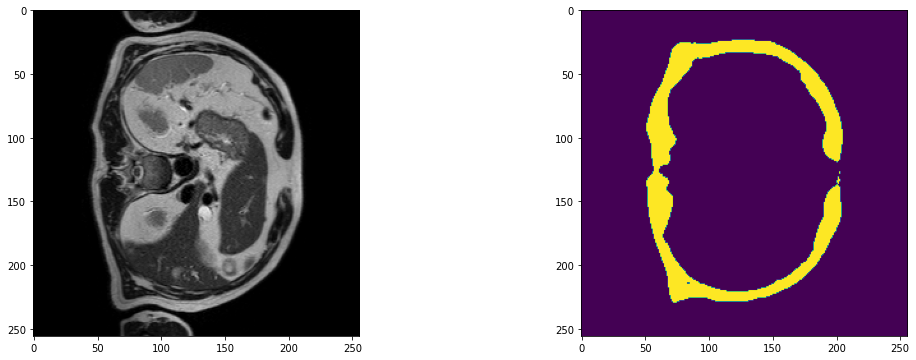

2023-09-14 18:18:41,027 INFO image_writer.py:194 - writing: outMR06_Sep23/A066_v6_T2W_seg.nii.gz


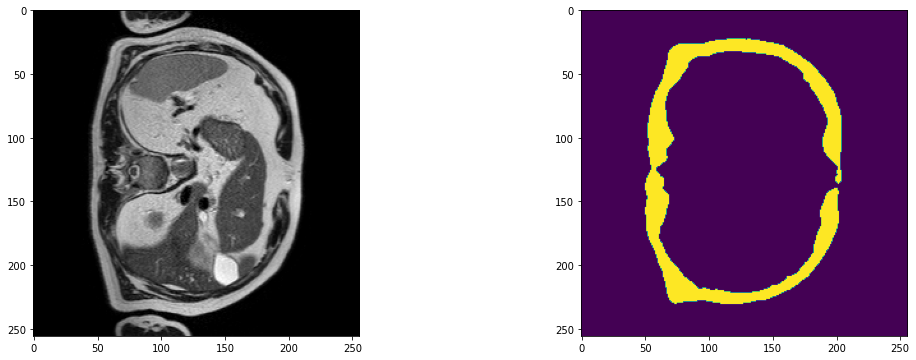

2023-09-14 18:18:46,779 INFO image_writer.py:194 - writing: outMR06_Sep23/A067_v1_T2W_seg.nii.gz


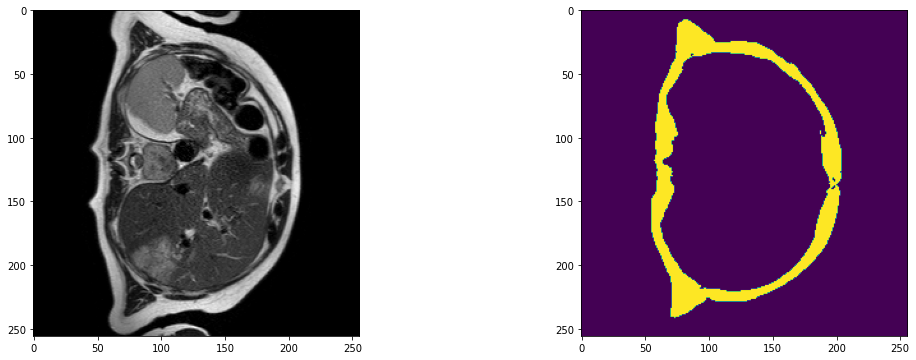

2023-09-14 18:18:52,526 INFO image_writer.py:194 - writing: outMR06_Sep23/A067_v2_T2W_seg.nii.gz


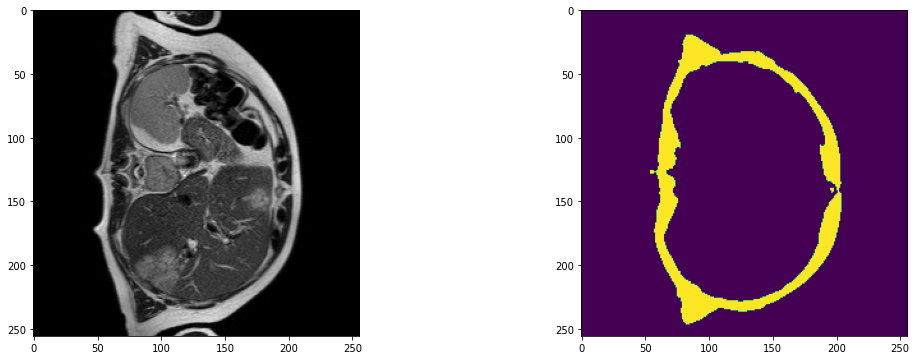

2023-09-14 18:18:58,271 INFO image_writer.py:194 - writing: outMR06_Sep23/A067_v3_T2W_seg.nii.gz


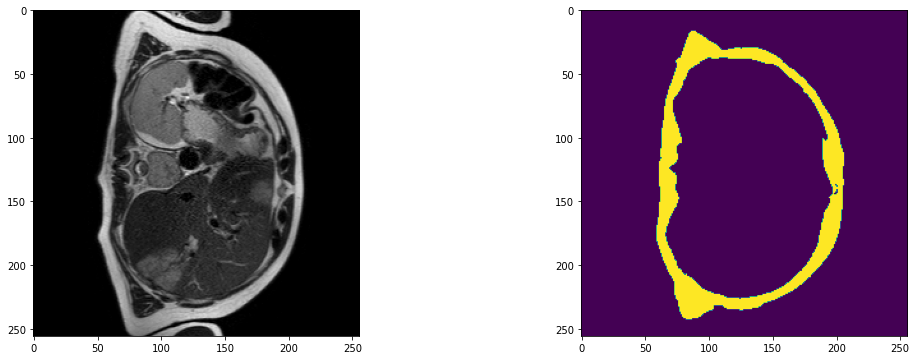

2023-09-14 18:19:04,012 INFO image_writer.py:194 - writing: outMR06_Sep23/A067_v4_T2W_seg.nii.gz


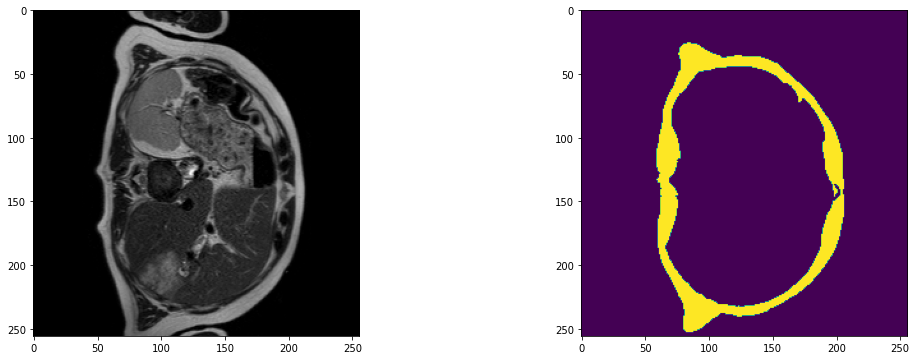

2023-09-14 18:19:09,752 INFO image_writer.py:194 - writing: outMR06_Sep23/A067_v5_T2W_seg.nii.gz


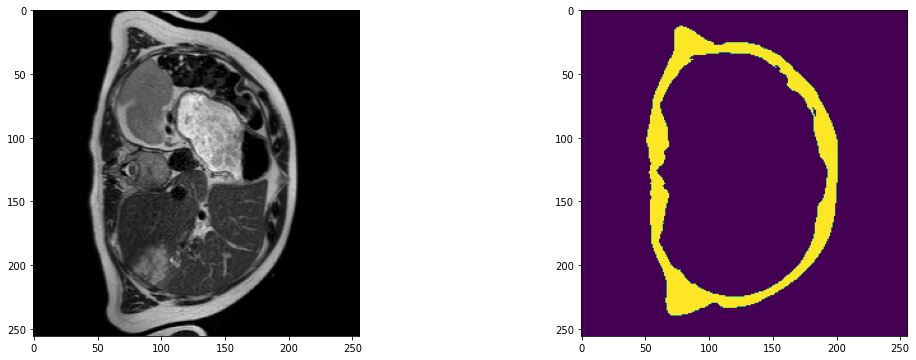

2023-09-14 18:19:15,495 INFO image_writer.py:194 - writing: outMR06_Sep23/A067_v6_T2W_seg.nii.gz


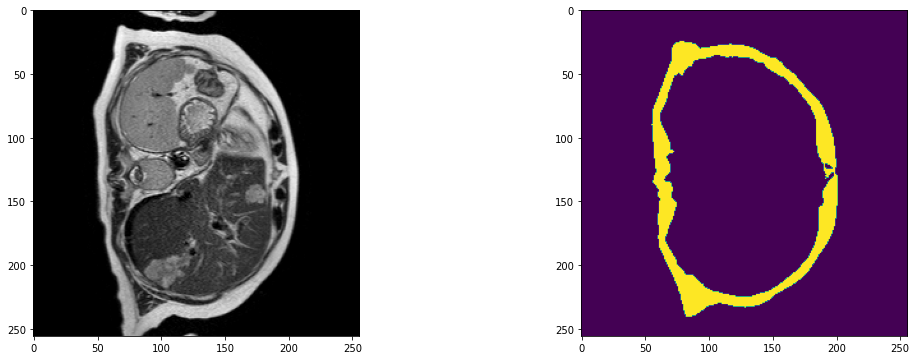

2023-09-14 18:19:19,966 INFO image_writer.py:194 - writing: outMR06_Sep23/A068_v1_T2W_seg.nii.gz


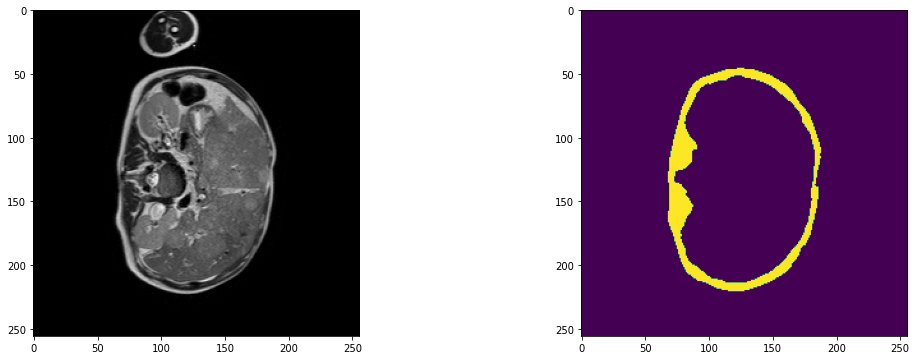

2023-09-14 18:19:24,863 INFO image_writer.py:194 - writing: outMR06_Sep23/A068_v2_T2W_seg.nii.gz


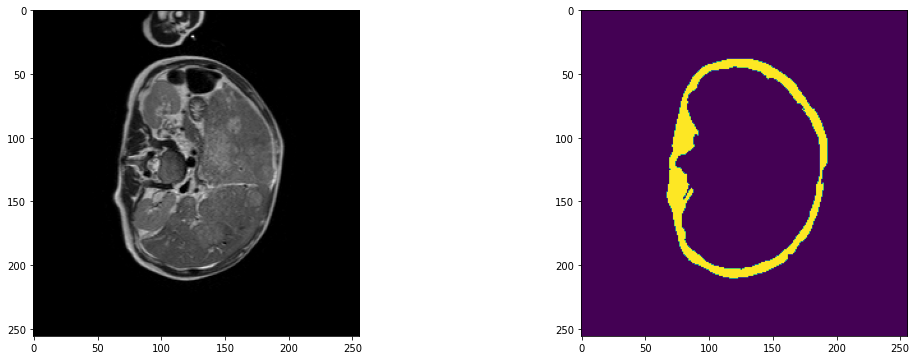

2023-09-14 18:19:29,741 INFO image_writer.py:194 - writing: outMR06_Sep23/A068_v3_T2W_seg.nii.gz


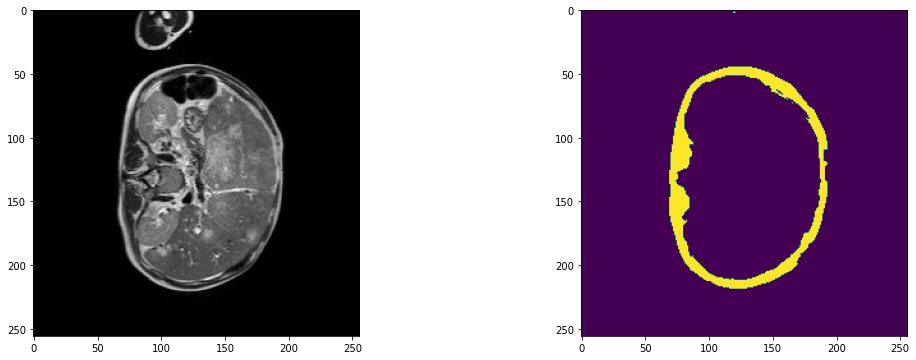

2023-09-14 18:19:34,647 INFO image_writer.py:194 - writing: outMR06_Sep23/A068_v4_T2W_seg.nii.gz


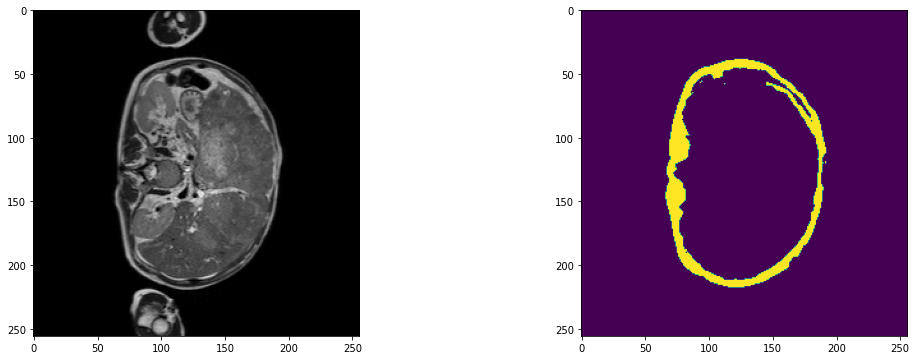

2023-09-14 18:19:39,683 INFO image_writer.py:194 - writing: outMR06_Sep23/A068_v5_T2W_seg.nii.gz


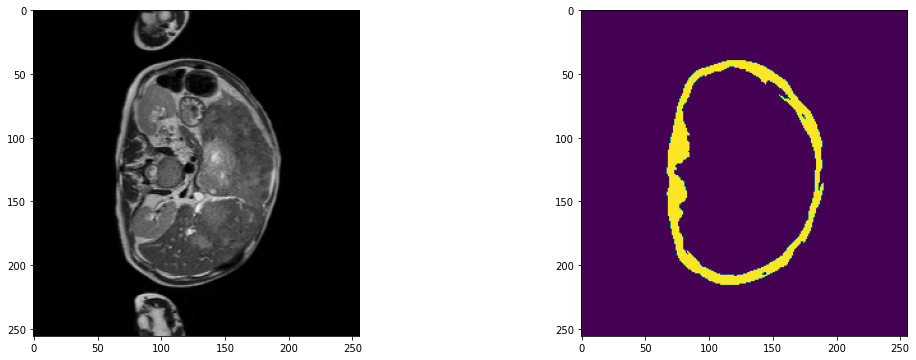

2023-09-14 18:19:44,598 INFO image_writer.py:194 - writing: outMR06_Sep23/A068_v6_T2W_seg.nii.gz


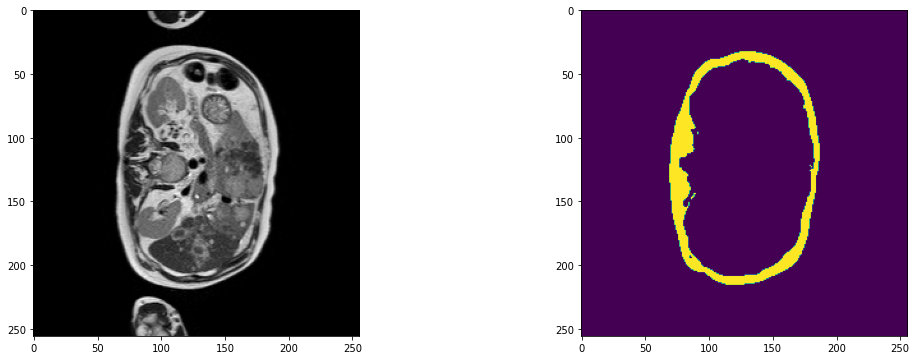

2023-09-14 18:19:50,339 INFO image_writer.py:194 - writing: outMR06_Sep23/A068_v7_T2W_seg.nii.gz


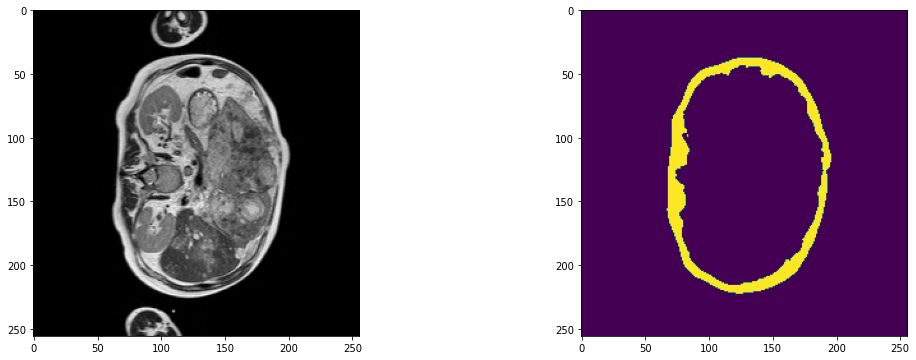

2023-09-14 18:19:55,222 INFO image_writer.py:194 - writing: outMR06_Sep23/A068_v8_T2W_seg.nii.gz


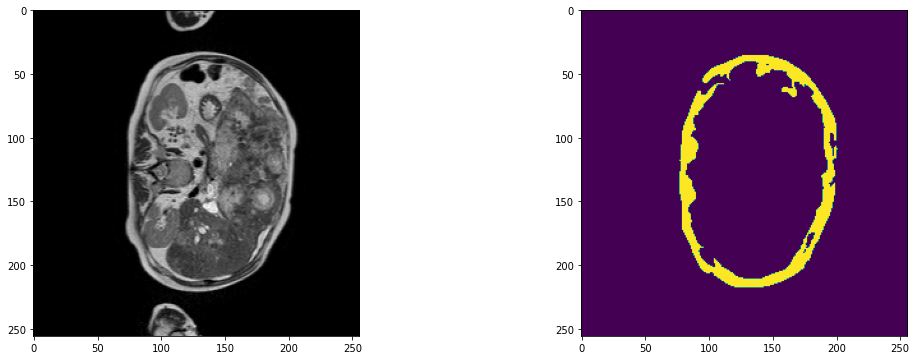

2023-09-14 18:20:00,992 INFO image_writer.py:194 - writing: outMR06_Sep23/A068_v9_T2W_seg.nii.gz


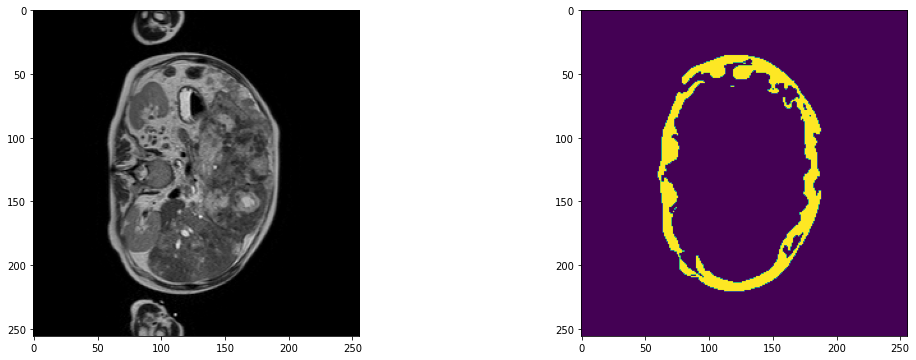

2023-09-14 18:20:11,635 INFO image_writer.py:194 - writing: outMR06_Sep23/A071_v1_T2W_seg.nii.gz


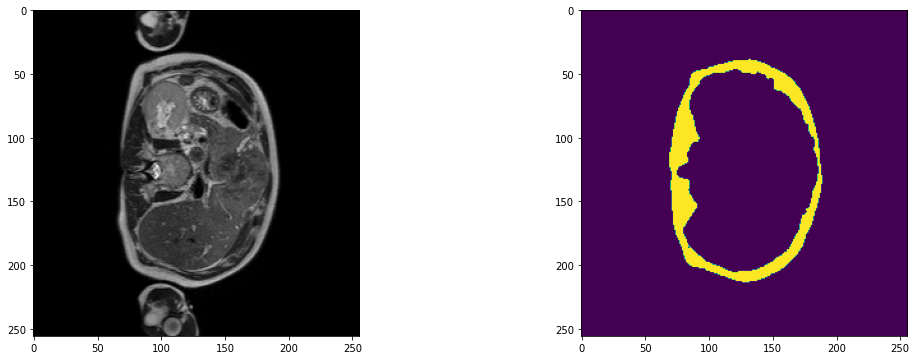

2023-09-14 18:20:22,272 INFO image_writer.py:194 - writing: outMR06_Sep23/A071_v2_T2W_seg.nii.gz


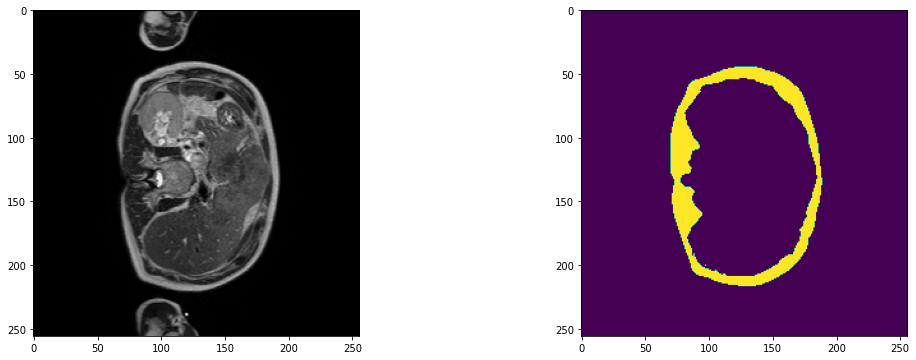

2023-09-14 18:20:32,912 INFO image_writer.py:194 - writing: outMR06_Sep23/A071_v3_T2W_seg.nii.gz


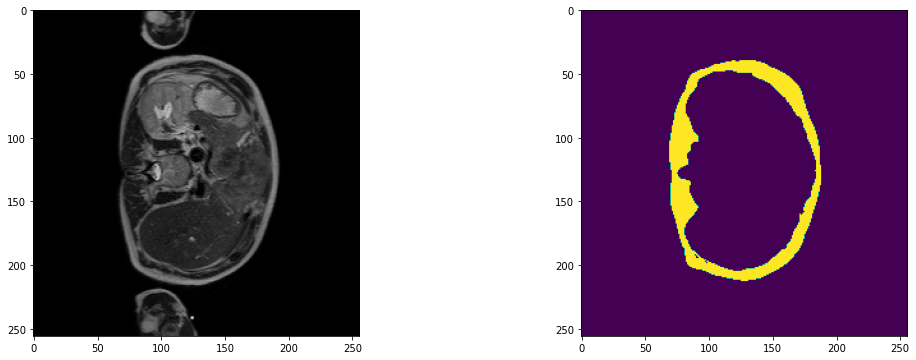

2023-09-14 18:20:45,570 INFO image_writer.py:194 - writing: outMR06_Sep23/A071_v4_T2W_seg.nii.gz


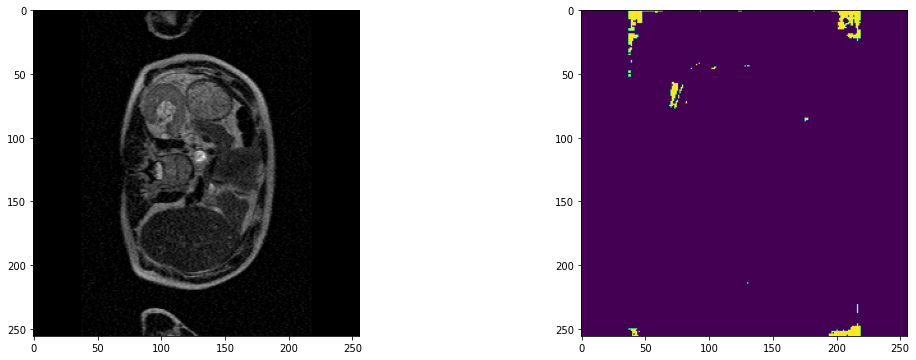

2023-09-14 18:20:56,200 INFO image_writer.py:194 - writing: outMR06_Sep23/A071_v5_T2W_seg.nii.gz


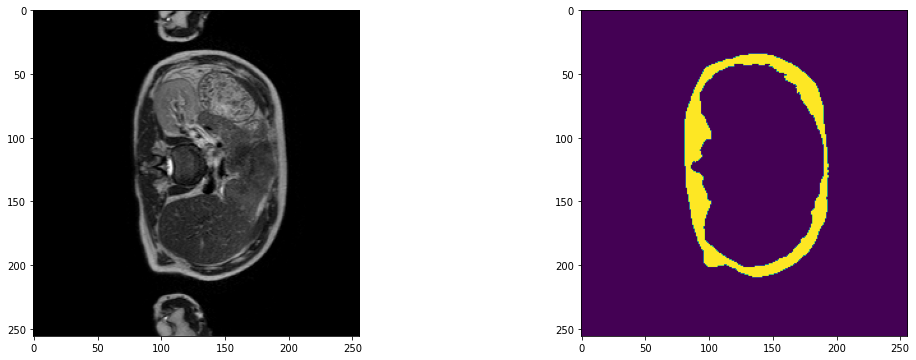

2023-09-14 18:21:06,851 INFO image_writer.py:194 - writing: outMR06_Sep23/A071_v6_T2W_seg.nii.gz


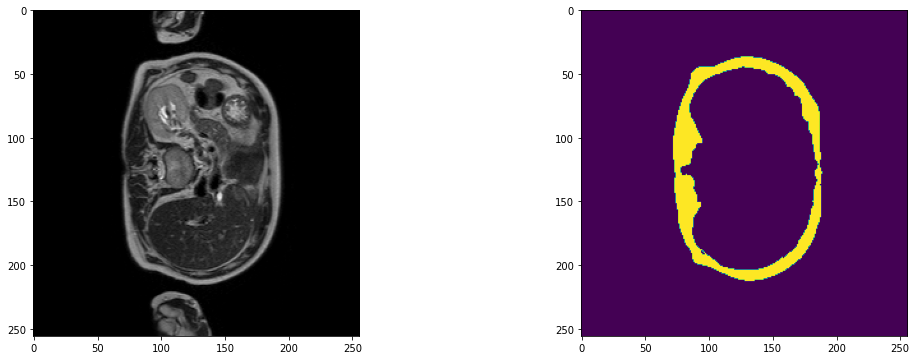

2023-09-14 18:21:17,505 INFO image_writer.py:194 - writing: outMR06_Sep23/A071_v7_T2W_seg.nii.gz


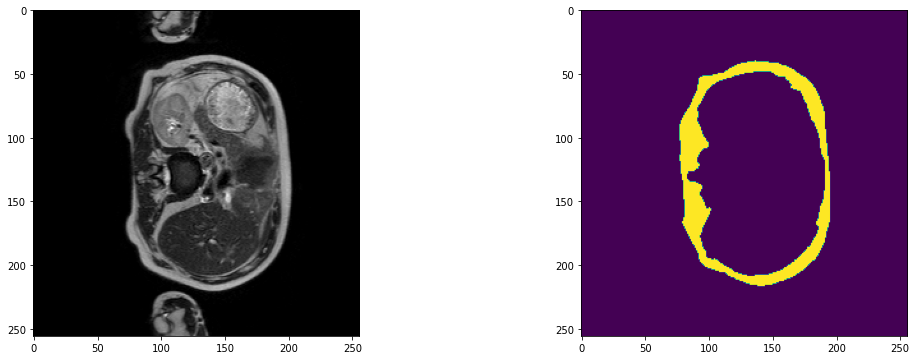

2023-09-14 18:21:28,196 INFO image_writer.py:194 - writing: outMR06_Sep23/A071_v9_T2W_seg.nii.gz


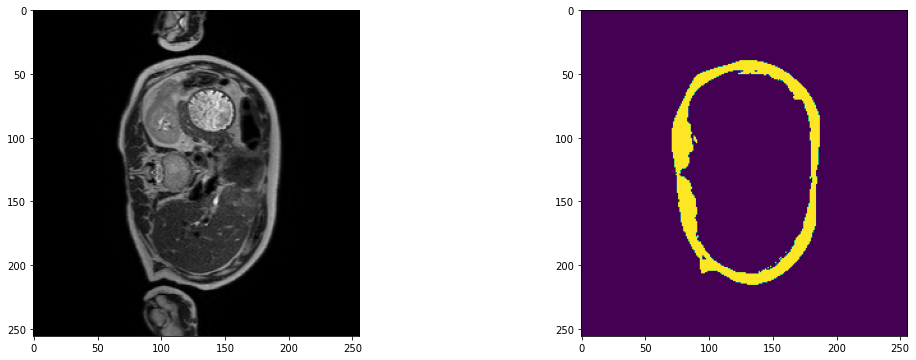

2023-09-14 18:21:38,854 INFO image_writer.py:194 - writing: outMR06_Sep23/A074_v1_T2W_seg.nii.gz


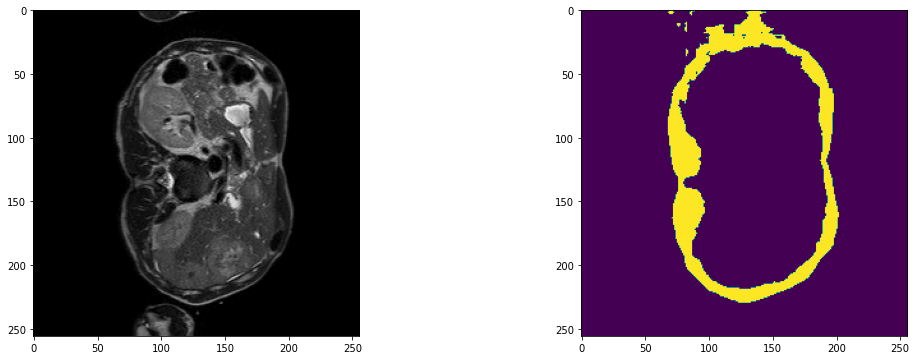

2023-09-14 18:21:51,635 INFO image_writer.py:194 - writing: outMR06_Sep23/A074_v2_T2W_seg.nii.gz


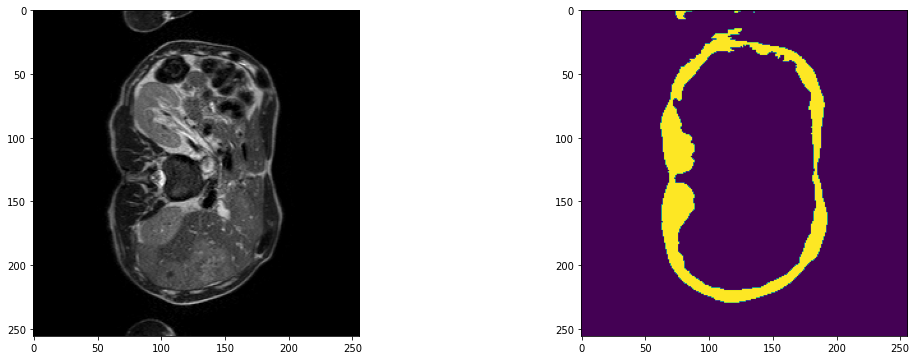

2023-09-14 18:22:04,270 INFO image_writer.py:194 - writing: outMR06_Sep23/A074_v3_T2W_seg.nii.gz


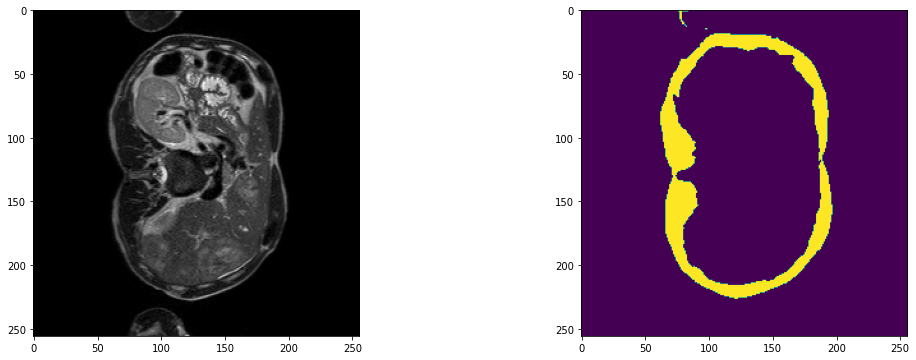

2023-09-14 18:22:14,931 INFO image_writer.py:194 - writing: outMR06_Sep23/A074_v4_T2W_seg.nii.gz


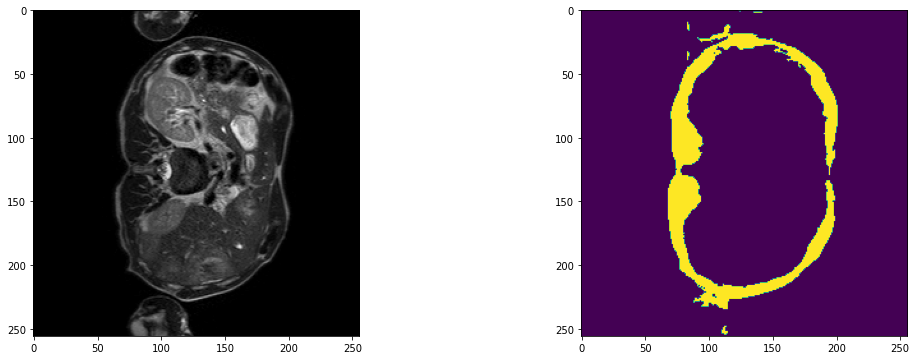

2023-09-14 18:22:25,590 INFO image_writer.py:194 - writing: outMR06_Sep23/A074_v5_T2W_seg.nii.gz


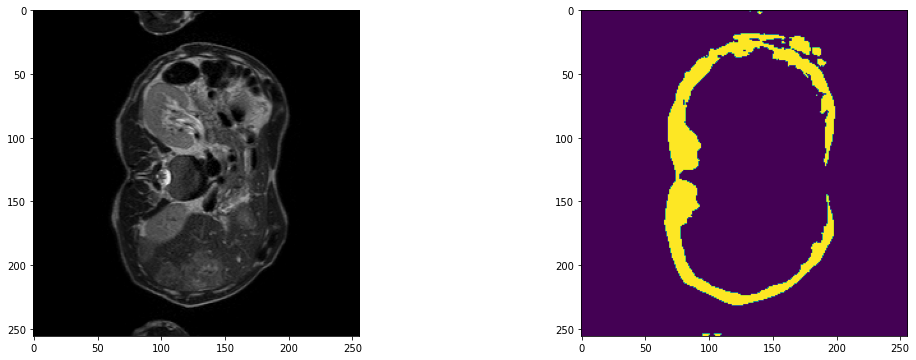

2023-09-14 18:22:36,276 INFO image_writer.py:194 - writing: outMR06_Sep23/A074_v6_T2W_seg.nii.gz


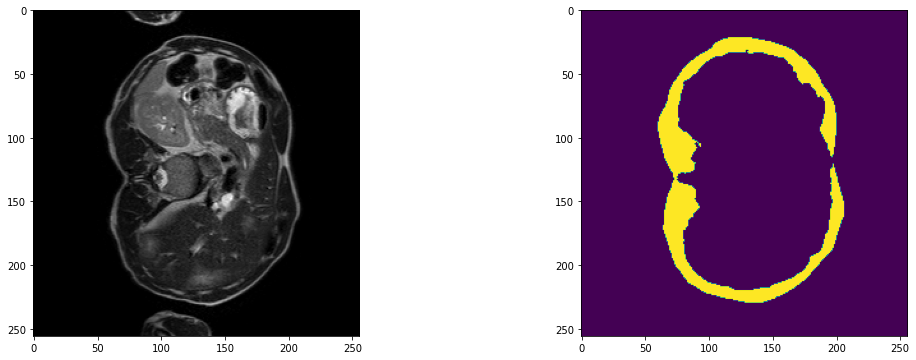

2023-09-14 18:22:48,910 INFO image_writer.py:194 - writing: outMR06_Sep23/A074_v7_T2W_seg.nii.gz


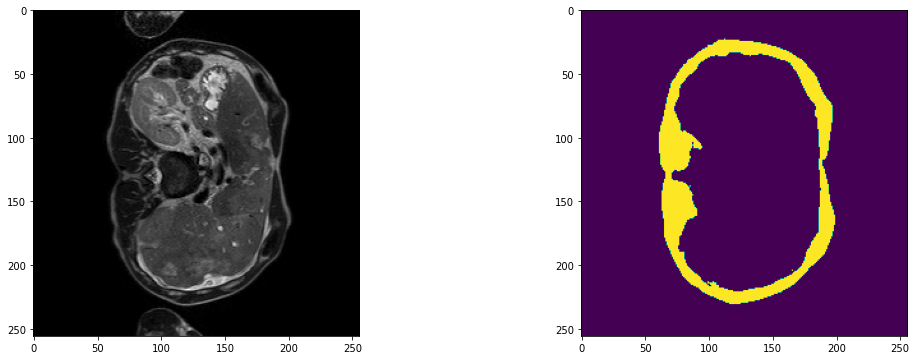

2023-09-14 18:22:53,858 INFO image_writer.py:194 - writing: outMR06_Sep23/A076_v1_T2W_seg.nii.gz


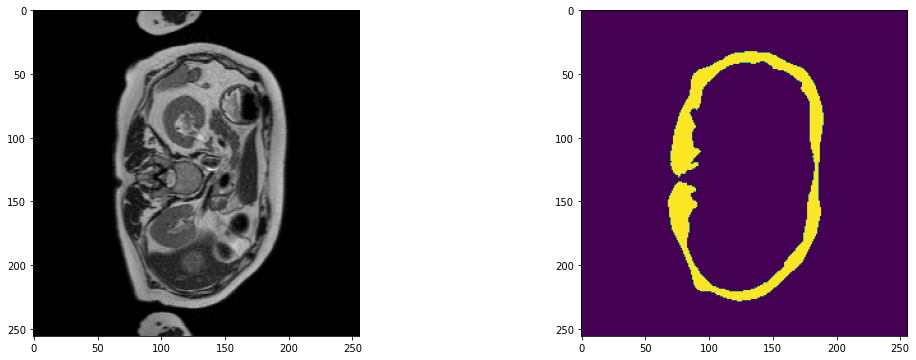

2023-09-14 18:22:59,596 INFO image_writer.py:194 - writing: outMR06_Sep23/A076_v2_T2W_seg.nii.gz


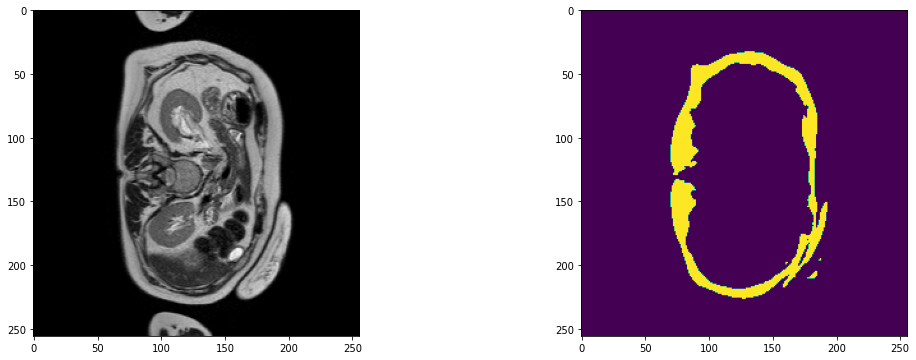

2023-09-14 18:23:04,521 INFO image_writer.py:194 - writing: outMR06_Sep23/A076_v3_T2W_seg.nii.gz


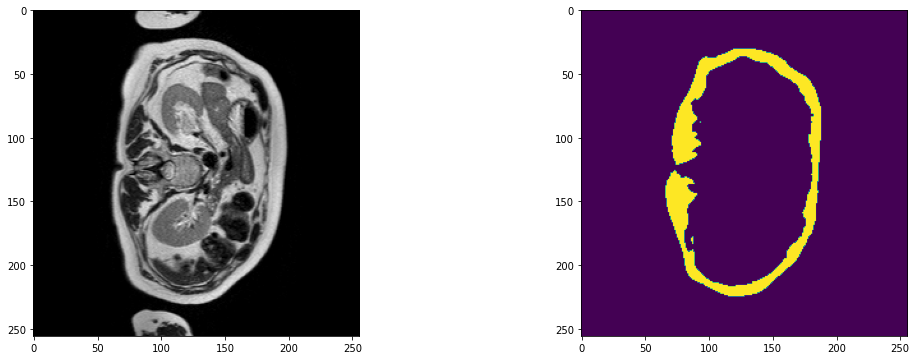

2023-09-14 18:23:10,269 INFO image_writer.py:194 - writing: outMR06_Sep23/A076_v4_T2W_seg.nii.gz


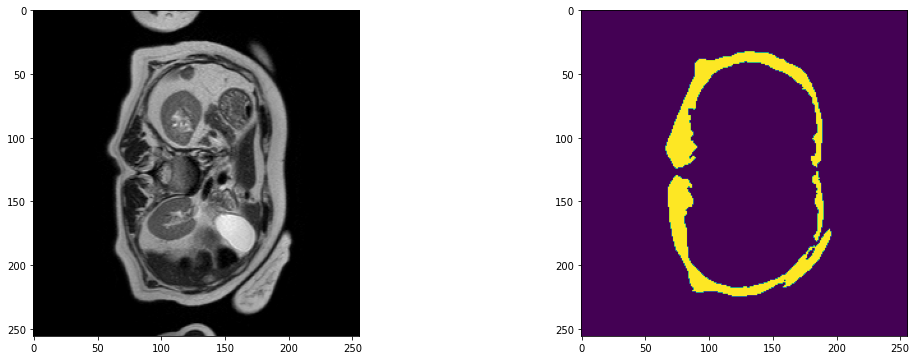

2023-09-14 18:23:16,014 INFO image_writer.py:194 - writing: outMR06_Sep23/A076_v5_T2W_seg.nii.gz


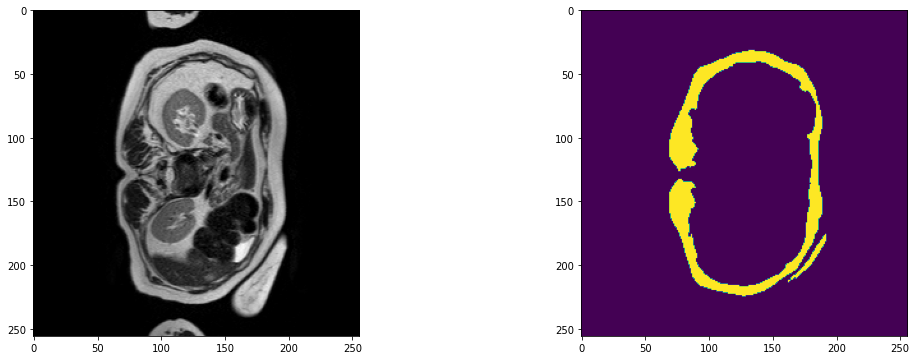

2023-09-14 18:23:21,757 INFO image_writer.py:194 - writing: outMR06_Sep23/A076_v6_T2W_seg.nii.gz


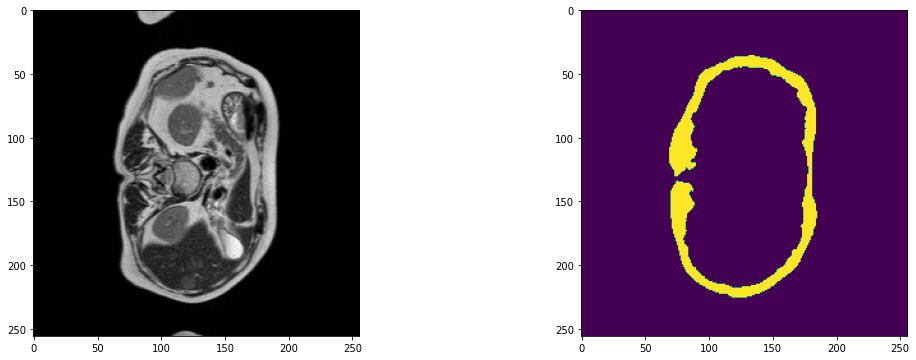

2023-09-14 18:23:27,635 INFO image_writer.py:194 - writing: outMR06_Sep23/A076_v7_T2W_seg.nii.gz


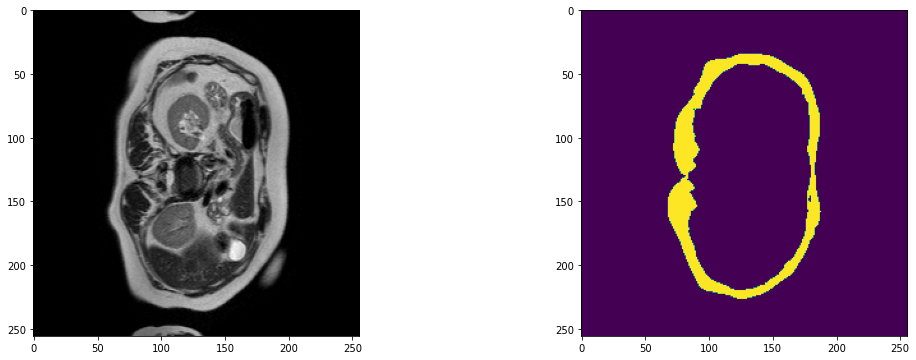

In [15]:
# # uncomment the following lines to visualize the predicted results
from monai.transforms import LoadImage
loader = LoadImage()

model.load_state_dict(torch.load(
    os.path.join(data_dir, "TestMR06_multiclassUNetR_Sep23.pth")))
model.eval()

with torch.no_grad():
    for test_data in test_org_loader:
        test_inputs = test_data["image"].to(device)
        roi_size = (96, 96, 16)
        sw_batch_size = 4
        test_data["pred"] = sliding_window_inference(
            test_inputs, roi_size, sw_batch_size, model, overlap=0.8)

        test_data = [post_transforms(i) for i in decollate_batch(test_data)]

#         # uncomment the following lines to visualize the predicted results
        test_output = from_engine(["pred"])(test_data)

        original_image = loader(test_data[0]["image_meta_dict"]["filename_or_obj"])[0]

        plt.figure("check", (18, 6))
        plt.subplot(1, 2, 1)
        plt.imshow(original_image[:, :, 8], cmap="gray")
        plt.subplot(1, 2, 2)
        plt.imshow(test_output[0].detach().cpu()[5, :, :, 8])
        plt.show()

In [ ]:
# # Testing code modified  (Based on validation block)

# from monai.transforms import LoadImage
# loader = LoadImage()

# model.load_state_dict(torch.load(
#     os.path.join(data_dir, "TestMR06_multiclassUNetR_Sep23.pth")))
# model.eval()

# with torch.no_grad():
#     for test_data in test_org_loader:
#         test_inputs = test_data["image"].to(device)
#         roi_size = (96, 96, 48)
#         sw_batch_size = 4
#         test_outputs = sliding_window_inference(
#             test_inputs, roi_size, sw_batch_size, model, overlap=0.8
#     )
# #     plt.figure("check", (18, 6))
# #     plt.subplot(1, 2, 1)
# #     plt.title("image")
# #     plt.imshow(test_inputs.cpu().numpy()[0, 0, :, :, 40], cmap="gray")
# #     plt.subplot(1, 2, 2)
# #     plt.title("output")
# #     plt.imshow(
# #         torch.argmax(test_outputs, dim=1).detach().cpu()[0, :, :, 40]
# #     )
# #     plt.show()      

In [ ]:
!tar -cvzf outMR06_Sep23.tar.gz outMR06_Sep23

In [ ]:
# !pwd

In [ ]:
# plt.figure("check", (18, 6))
# plt.subplot(1, 2, 1)
# plt.title("image")
# plt.imshow(test_inputs.cpu().numpy()[0, 0, :, :, 20], cmap="gray")
# plt.subplot(1, 2, 2)
# plt.title("output")
# plt.imshow(
#     torch.argmax(test_outputs, dim=1).detach().cpu()[0, :, :, 20]
# )
# plt.show()

In [ ]:
# print(test_output[0].shape)

In [ ]:
# slno = 20
# plt.figure("check1", (18, 6))
# plt.imshow(original_image[:, :, slno], cmap="gray")
# plt.figure("check2", (18, 6))
# plt.subplot(3, 3, 1)
# plt.imshow(test_output[0].detach().cpu()[0, :, :, slno])
# plt.subplot(3, 3, 2)
# plt.imshow(test_output[0].detach().cpu()[1, :, :, slno])
# plt.subplot(3, 3, 3)
# plt.imshow(test_output[0].detach().cpu()[2, :, :, slno])
# plt.subplot(3, 3, 4)
# plt.imshow(test_output[0].detach().cpu()[3, :, :, slno])
# plt.subplot(3, 3, 5)
# plt.imshow(test_output[0].detach().cpu()[4, :, :, slno])
# plt.subplot(3, 3, 6)
# plt.imshow(test_output[0].detach().cpu()[5, :, :, slno])
# plt.subplot(3, 3, 7)
# plt.imshow(test_output[0].detach().cpu()[6, :, :, slno])
# plt.subplot(3, 3, 8)
# plt.imshow(test_output[0].detach().cpu()[7, :, :, slno])
# plt.subplot(3, 3, 9)
# plt.imshow(test_output[0].detach().cpu()[8, :, :, slno])
# plt.show()